# Violencias digitales basadas en género

In [1]:
%load_ext jupyter_black

import warnings

warnings.filterwarnings("ignore")

In [2]:
import funciones_graficos as fg

In [3]:
import numpy as np
import pandas as pd
import geopandas as gpd
import seaborn as sns
import plotly.express as px
import plotly.graph_objects as go

layout = go.Layout

In [4]:
# data = pd.read_pickle("vdbg_final.pkl")

data = pd.read_csv("datos_final.csv", index_col=0)

In [5]:
parentesco_lista = [
    s for s in list(data.columns) if "parentesco_" in s or "identificacion_" in s
]

In [6]:
data.loc[:, parentesco_lista] = data[parentesco_lista].astype("category")

In [7]:
data.edad = data.edad.astype("category").cat.set_categories(
    ["14-17", "18-25", "26-40", "41-60", "Más de 60"], ordered=True
)

In [8]:
data.horas_internet = data.horas_internet.astype("category").cat.set_categories(
    [
        "No lo utilizo diariamente",
        "Menos de 2 horas",
        "2-4 horas",
        "5-7 horas",
        "Más de 7 horas",
    ],
    ordered=True,
)

In [9]:
# data.info()

Los datos analizados corresponden a 386 respuestas obtenidas. A continuación se muestra la cantidad de respuestas por sexo y género.

In [10]:
tbl_sexo = data.sexo.value_counts()

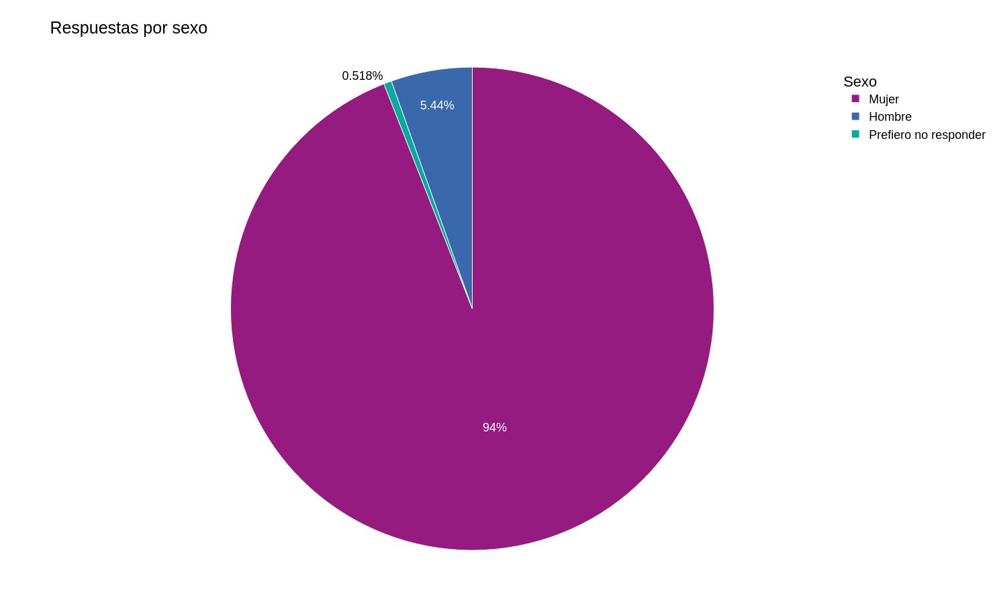

In [11]:
fig = go.Figure(
    data=[go.Pie(labels=tbl_sexo.index, values=tbl_sexo)],
)
fig.update_layout(
    title_text="Respuestas por sexo",
    legend_title="Sexo",
    font=dict(family="Arial", size=18, color="black"),
    width=1500,
    height=900,
    legend=dict(font=dict(size=18)),
)
fig.update_traces(
    marker=dict(
        colors=["rgb(149, 27, 129)", "rgb(57, 105, 172)", "rgb(7, 171, 157)"],
        line=dict(color="white", width=1),
    )
)
fig.show()
fig.write_image("img/1.png")

In [12]:
df_sexo_genero = data.pivot_table(
    columns="sexo", index="genero", aggfunc={"sexo": "count"}
).fillna(0)
df_sexo_genero.index.name = "Género"
df_sexo_genero.columns.names = [None, "Sexo"]
df_sexo_genero.columns = df_sexo_genero.columns.droplevel(0)
df_sexo_genero.astype("int")

Sexo,Hombre,Mujer,Prefiero no responder
Género,,,
Femenino,0,360,1
Masculino,20,1,0
Otro,0,1,0
Prefiero no decir,1,1,0
Trans femenino,0,0,1


In [13]:
df_sg = df_sexo_genero.stack(level=0)
pd.DataFrame(round(df_sg / df_sg.sum() * 100, 2)).rename(columns={0: "%"})

%
Género            Sexo                        
Femenino          Hombre                  0.00
                  Mujer                  93.26
                  Prefiero no responder   0.26
Masculino         Hombre                  5.18
                  Mujer                   0.26
                  Prefiero no responder   0.00
Otro              Hombre                  0.00
                  Mujer                   0.26
                  Prefiero no responder   0.00
Prefiero no decir Hombre                  0.26
                  Mujer                   0.26
                  Prefiero no responder   0.00
Trans femenino    Hombre                  0.00
                  Mujer                   0.00
                  Prefiero no responder   0.26

In [14]:
datos = data.query("sexo == 'Mujer'")

Los siguientes resultados corresponden a las **mujeres** que respondieron la encuesta.

## Respuestas por rangos de edad

In [15]:
tbl_edad = pd.DataFrame(datos.edad.value_counts()).sort_index()

In [16]:
tbl_edad_porcentaje = (
    round(tbl_edad / tbl_edad.sum() * 100, 2)["count"].astype(str) + " %"
)

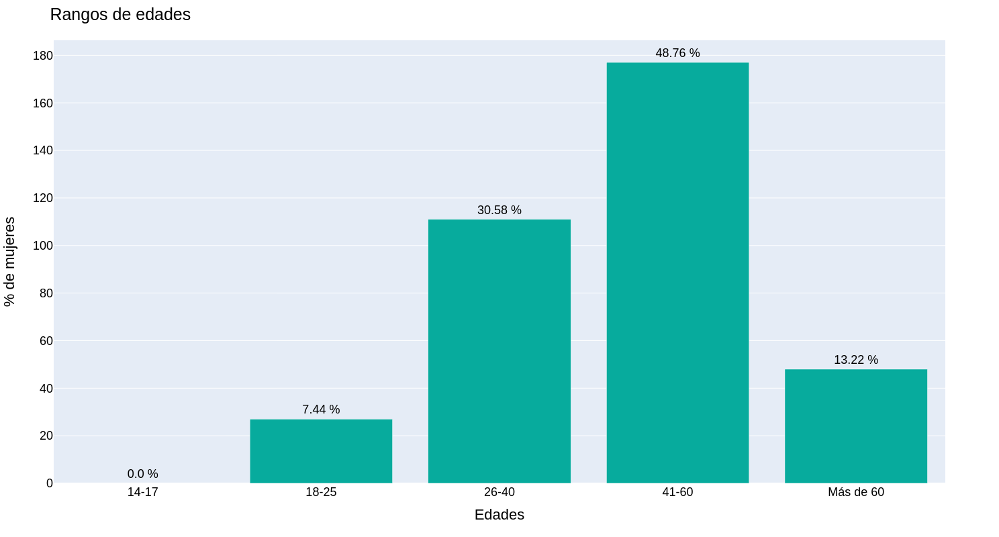

In [17]:
fig = px.bar(tbl_edad, text=tbl_edad_porcentaje)
fig.update_layout(
    title="Rangos de edades",
    xaxis_title="Edades",
    yaxis_title="% de mujeres",
    font=dict(
        family="Arial",
        size=18,
        color="black",
    ),
    width=1500,
    height=800,
)
fig.update_traces(
    textfont_size=18,
    textangle=0,
    textposition="outside",
    cliponaxis=False,
    showlegend=False,
    marker_color="rgb(7, 171, 157)",
    marker_line_color="white",
)
fig.show()
fig.write_image("img/edades.png")

## Respuestas por estados

In [18]:
serie_estados = datos.estado.value_counts()

In [19]:
fp = "./Estados_Venezuela/Estados_Venezuela.shp"
df_mapa = gpd.read_file(fp)

In [20]:
ls = []
for i in df_mapa.ESTADO:
    if i in serie_estados.index:
        ls.append(serie_estados.loc[i])
    else:
        ls.append(0)
df_mapa["Mujeres"] = ls

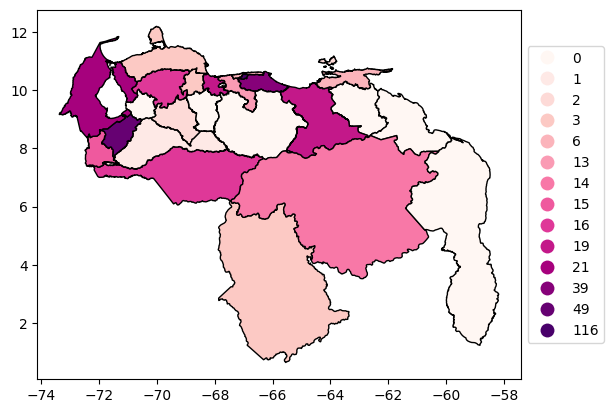

In [21]:
df_mapa.plot(
    "Mujeres",
    cmap="RdPu",
    edgecolor="black",
    categorical=True,
    legend=True,
    legend_kwds={"loc": "center left", "bbox_to_anchor": (1, 0.5), "fmt": "{:.0f}"},
);

In [22]:
informacion_estados = pd.DataFrame(serie_estados.sort_index())
informacion_estados["%"] = round(
    informacion_estados / informacion_estados.sum() * 100, 2
)
informacion_estados.rename_axis(index={"estado": "Estado"}, inplace=True)
informacion_estados.rename(columns={"count": "Nº de mujeres"})

,Nº de mujeres,%
Estado,,
Amazonas,3,0.83
Anzoátegui,19,5.23
Apure,16,4.41
Aragua,13,3.58
Barinas,1,0.28
Bolívar,14,3.86
Carabobo,19,5.23
Distrito Capital,116,31.96
Falcón,3,0.83


## Ocupaciones de las mujeres

In [23]:
for i in [
    "Defensora de DDHH de las mujeres",
    "Trabajo social ",
    "Trabajador social ",
    "Trabajadora Social",
    "Trabajadora Social ",
    "Trabajadora social. Actriz militante afrofemisnita",
    "Trabajadora humanitaria",
    "Promotora Social ",
    "Trabajadora Humanitaria",
    "Trabajadora de organización internacional ",
    "Gestora de casos en VBG Y TDP ",
    "El feminismo ",
    "Defensora de Mujeres ",
    "Atención a víctimas de VBG" "Defensora de DDHH de las mujeres",
    "Atención a víctimas de VBG",
    "El feminismo ",
    "Trabajando social ) Ayuda humanista",
]:
    datos.loc[datos["ocupacionO"] == i, "ocupacion"] = "Trabajo social"

In [24]:
for i in [
    "Del hogar ",
    "Crianza y cuidado del hogar ",
    "Ama de casa",
    "Trabajo on line. Trabajadora del hogar",
]:
    datos.loc[datos["ocupacionO"] == i, "ocupacion"] = "Ama de casa"

In [25]:
datos.loc[datos["ocupacionO"] == "Abogado", "ocupacion"] = "Abogado(a)"

In [26]:
datos.loc[datos["ocupacionO"] == "Psicologa ", "ocupacion"] = "Psicólogo(a)"

### Ocupaciones más comunes

In [27]:
df_ocupaciones = (
    pd.DataFrame(datos.ocupacion.value_counts())
    .rename_axis(index={"ocupacion": "Ocupación"})
    .rename(columns={"count": "Nº de mujeres"})
)
df_ocupaciones["%"] = round(df_ocupaciones / len(datos) * 100, 2)
df_ocupaciones.drop("Otra")[:10]

,Nº de mujeres,%
Ocupación,,
Docente,56,15.43
Abogado(a),40,11.02
Psicólogo(a),24,6.61
Empleado(a) Público(a),19,5.23
Trabajo social,17,4.68
Ingeniero(a),17,4.68
Estudiante,15,4.13
Periodista,14,3.86
Jubilado(a),10,2.75


En otros hay 34 respuestas, que se dividen de la siguiente manera:

In [28]:
pd.DataFrame(datos.query('ocupacion == "Otra"').ocupacionO.value_counts()).rename_axis(
    index={"ocupacionO": "Ocupación"}
).rename(columns={"count": "Nº de mujeres"})

,Nº de mujeres
Ocupación,
Desempleada,3
Socióloga,3
Promotora,1
antropologa,1
Repostera,1
Consultora,1
Educadora ambiental. Redactora,1
Promotora,1
Creación de comidas alternativas y comunes,1


## Horas de uso de internet

In [29]:
tbl_uso_internet = pd.DataFrame(datos.horas_internet.value_counts().sort_index())

In [30]:
tbl_uso_porcentaje = (
    round(tbl_uso_internet / tbl_uso_internet.sum() * 100, 2)["count"].astype(str)
    + " %"
)

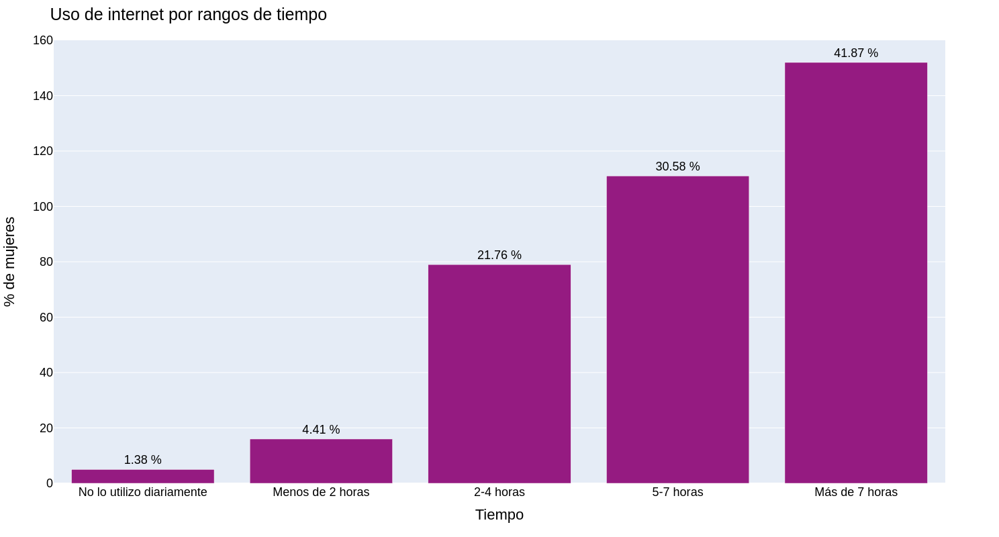

In [31]:
fig = px.bar(tbl_uso_internet, text=tbl_uso_porcentaje)
fig.update_layout(
    title="Uso de internet por rangos de tiempo",
    xaxis_title="Tiempo",
    yaxis_title="% de mujeres",
    font=dict(
        family="Arial",
        size=18,
        color="black",
    ),
    width=1500,
    height=800,
)
fig.update_traces(
    textfont_size=18,
    textangle=0,
    textposition="outside",
    cliponaxis=False,
    showlegend=False,
    marker_color="rgb(149, 27, 129)",
    marker_line_color="white",
)
fig.show()
fig.write_image("img/uso_internet.png")

### Principales usos de internet

In [32]:
tbl_usos = pd.DataFrame(
    datos[
        [
            "uso_familia",
            "uso_trabajo",
            "uso_venta",
            "uso_distraer",
            "uso_estudiar",
            "uso_banco",
            "uso_otra",
            "uso_peli",
            "uso_noticias",
        ]
    ].sum()
)

In [33]:
tbl_usos.index = [
    "Comunicarme con familiares y amigos/as",
    "Trabajar",
    "Vender productos",
    "Distraerme",
    "Estudiar o investigar",
    "Realizar operaciones bancarias",
    "Otras actividades",
    "Ver películas y/o series",
    "Ver noticias",
]

In [34]:
tbl_usos_porcentaje = pd.DataFrame(
    round(tbl_usos / tbl_usos.sum() * 100, 2)[0].astype(str) + " %"
)

In [35]:
tbl_usos_concat = pd.concat(
    [tbl_usos, tbl_usos_porcentaje.rename(columns={0: "p"})], axis=1
).sort_values(0)

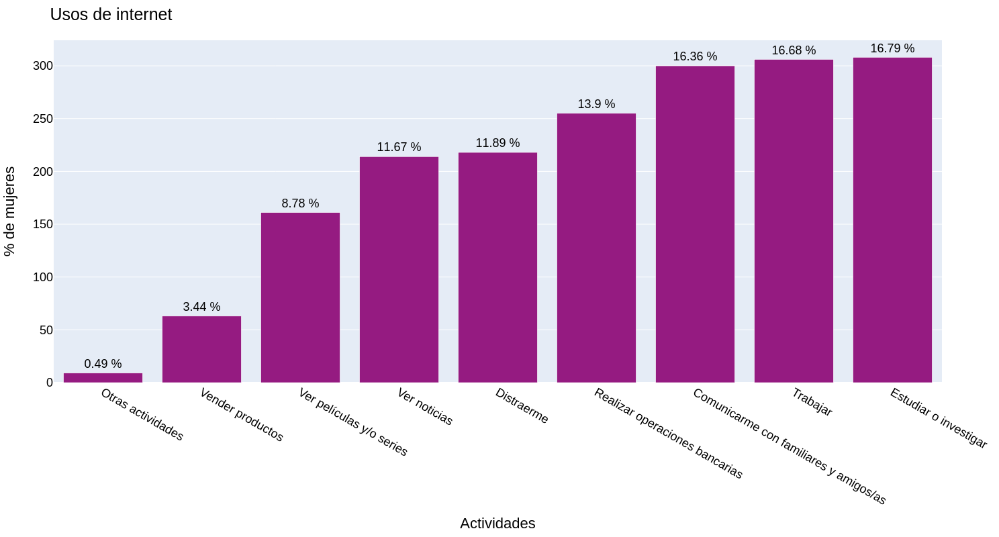

In [36]:
fig = px.bar(tbl_usos_concat[0], text=tbl_usos_concat.p)
fig.update_layout(
    title="Usos de internet",
    xaxis_title="Actividades",
    yaxis_title="% de mujeres",
    font=dict(
        family="Arial",
        size=18,
        color="black",
    ),
    width=1500,
    height=800,
)
fig.update_traces(
    textfont_size=18,
    textangle=0,
    textposition="outside",
    cliponaxis=False,
    showlegend=False,
    marker_color="rgb(149, 27, 129)",
    marker_line_color="white",
)
fig.show()
fig.write_image("img/usos_internet.png")

En el caso de la respuesta "Otras actividades", se desglosa de la siguiente manera:

In [37]:
pd.DataFrame(datos.uso_otraR.value_counts()).rename_axis(
    index={"uso_otraR": "Otros usos de internet"}
).rename(columns={"count": "Nº de mujeres"})

,Nº de mujeres
Otros usos de internet,
Temas de salud,1
Talleres y formaciones,1
Investigación,1
Subir estados de mensajes claves y de empoderamiento,1
Buscar direccciones,1
Comprar productos,1
"Escuchar música, poner comiquitas educativas, buscar poesías, corregir ortografía, …",1
Compartir contenido,1
Jugar,1


## Aumento de uso de internet por Covid19

In [38]:
tbl_covid_aumento = datos.covid_aumento.value_counts()

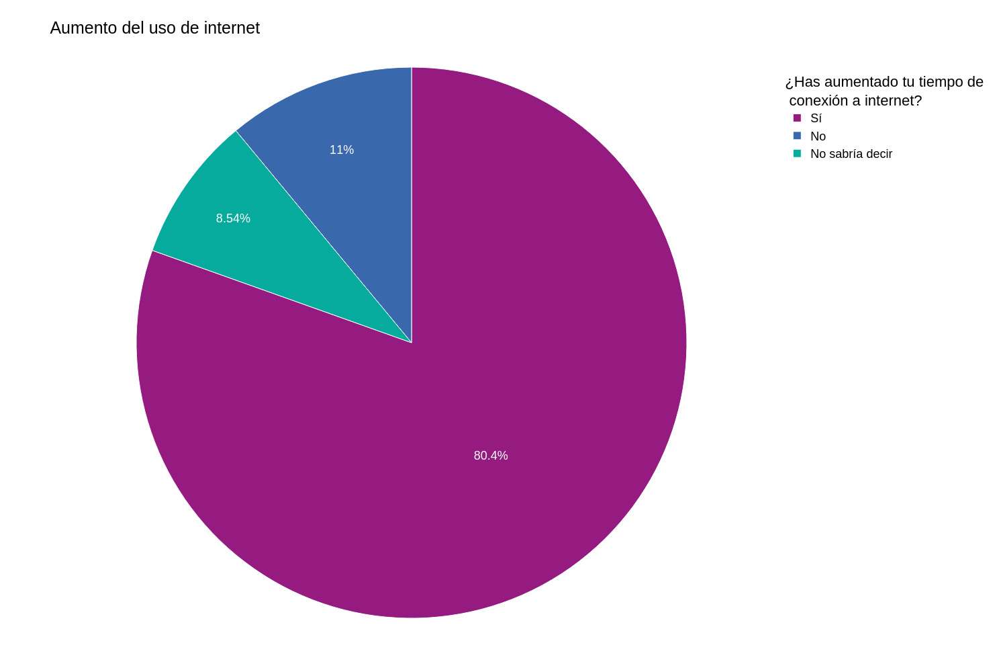

In [39]:
fig = go.Figure(data=[go.Pie(labels=tbl_covid_aumento.index, values=tbl_covid_aumento)])
fig.update_layout(
    title_text="Aumento del uso de internet",
    legend_title="¿Has aumentado tu tiempo de <br> conexión a internet?",
    font=dict(family="Arial", size=18, color="black"),
    width=1500,
    height=1000,
    legend=dict(font=dict(size=18)),
)
fig.update_traces(
    marker=dict(
        colors=["rgb(149, 27, 129)", "rgb(57, 105, 172)", "rgb(7, 171, 157)"],
        line=dict(color="white", width=1),
    )
)
fig.show()
fig.write_image("img/covid.png")

## Uso de redes sociales/aplicaciones

In [40]:
datos.loc[:, "telegram"] = datos.telegram.apply(str.strip)

In [41]:
redes = [
    "facebook",
    "twitter",
    "instagram",
    "tiktok",
    "discord",
    "slack",
    "citas",
    "videojuegos",
    "whatsapp",
    "telegram",
    "reddit",
    "estudio",
    "linkedin",
    "twich",
    "youtube",
    "pinterest",
    "flickr",
]

dicts = {}
for i in redes:
    dicts[i.capitalize()] = (
        datos[[i]].value_counts().reset_index().set_index(i)["count"]
    )

In [42]:
tbl_aplicaciones = round(
    (
        pd.DataFrame.from_dict(dicts, orient="index").fillna(0)[
            [
                "Menos de 2 horas",
                "2-4 horas",
                "5-7 horas",
                "Más de 7 horas",
                "No la utilizo",
            ]
        ]
        / len(datos)
    )
    * 100,
    2,
)

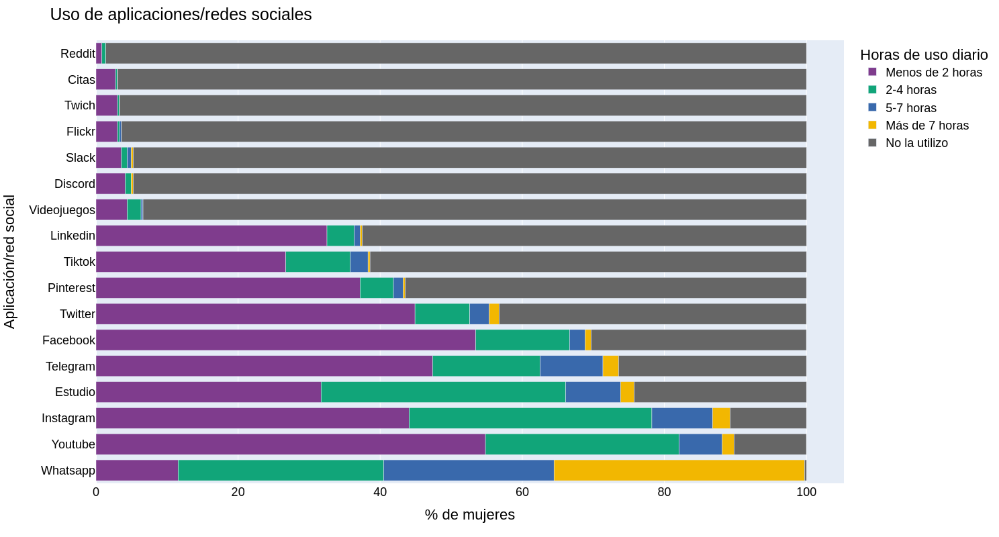

In [43]:
fig = px.bar(
    tbl_aplicaciones.sort_values("No la utilizo"),
    orientation="h",
    color_discrete_sequence=px.colors.qualitative.Bold[:4]
    + [px.colors.qualitative.Prism_r[0]],
    width=1500,
    height=800,
)
fig.update_layout(
    title="Uso de aplicaciones/redes sociales",
    xaxis_title="% de mujeres",
    yaxis_title="Aplicación/red social",
    legend_title="Horas de uso diario",
    font=dict(
        family="Arial",
        size=18,
        color="black",
    ),
)

fig.show()
fig.write_image("img/uso_apps.png")

## Incidencia de violencias

In [44]:
violencias_nombres = {
    "identidad": "Duplicación de identidad",
    "ciberacoso": "Ciberacoso",
    "doxxing": "Doxxing",
    "mobbing": "Mobbing",
    "ciberdifamacion": "Ciberdifamación",
    "stalking": "Cibervigilancia (stalking)",
    "ciberextorsion": "Ciberextorsión",
    "grooming": "Grooming",
    "phishing_vs": "Phishing/Vishing/Smishing",
    "trata": "Trata de personas en línea",
    "explotacion": "Captación con fines de explotación sexual",
    "exclusion": "Exclusión digital",
    "cyberflashing": "Cyberflashing",
    "deepfake": "Deepfake",
    "clonacion": "Clonación de aplicaciones",
}

In [45]:
violencias = list(violencias_nombres.keys())

In [46]:
dic = {}
for i in violencias:
    datos.loc[:, i] = datos[i].apply(str.strip).apply(str.capitalize)
    dic[violencias_nombres[i]] = datos[[i]].value_counts().sort_index()

In [47]:
tbl_sufrio = pd.DataFrame.from_dict(dic, orient="index").fillna(0)

In [48]:
tbl_sufrio

,No,Sí
Duplicación de identidad,320,43
Ciberacoso,228,135
Doxxing,318,45
Mobbing,305,58
Ciberdifamación,303,60
Cibervigilancia (stalking),197,166
Ciberextorsión,342,21
Grooming,323,40
Phishing/Vishing/Smishing,285,78
Trata de personas en línea,324,39


In [49]:
tbl_sufrio = tbl_sufrio.set_axis(["No", "Sí"], axis=1)

In [50]:
sufrio_porcentaje = round(tbl_sufrio / len(datos) * 100, 2)

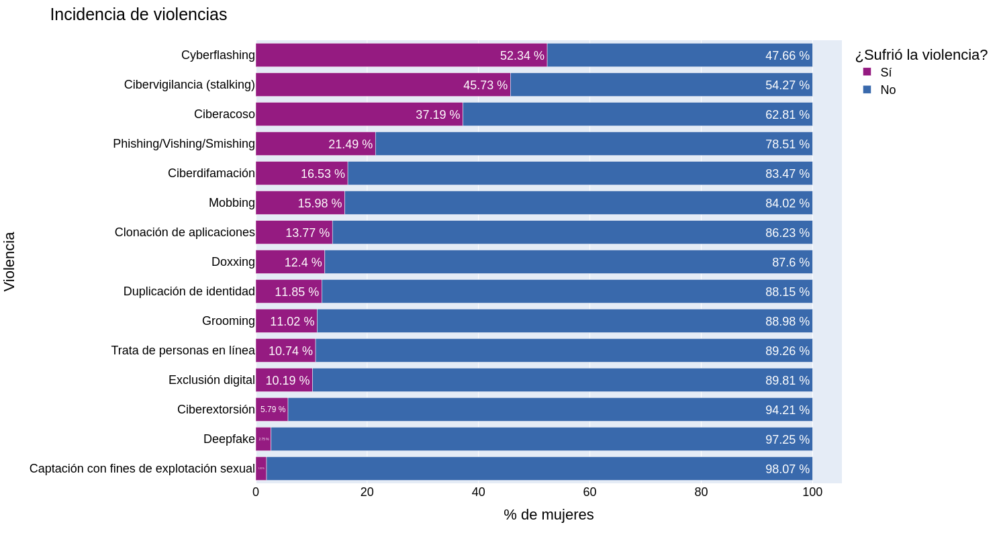

In [51]:
fig = px.bar(
    sufrio_porcentaje[["Sí", "No"]].sort_values("Sí"),
    orientation="h",
    text_auto=True,
    color_discrete_map={"Sí": "rgb(149, 27, 129)", "No": "rgb(57, 105, 172)"},
    width=1500,
    height=800,
)
fig.update_layout(
    title="Incidencia de violencias",
    yaxis_title="Violencia",
    xaxis_title="% de mujeres",
    legend_title="¿Sufrió la violencia?",
    font=dict(
        family="Arial",
        size=18,
        color="black",
    ),
)
fig.update_traces(
    textfont_size=18,
    textangle=0,
    cliponaxis=False,
    marker_line_color="white",
    texttemplate="%{value: 4} %",
)
fig.show()
fig.write_image("img/incidencia.png")

In [52]:
for i in violencias:
    datos.loc[:, i].replace(
        [
            "No",
            "Sí",
        ],
        [0, 1],
        inplace=True,
    )

In [53]:
tbl_numero_violencia = pd.DataFrame(
    datos[violencias].T.sum().value_counts()
).sort_index()
tbl_violencia_porcentaje = round(tbl_numero_violencia / len(datos) * 100, 2)

In [54]:
tbl_violencia_porcentaje.index = tbl_violencia_porcentaje.index.astype("string")

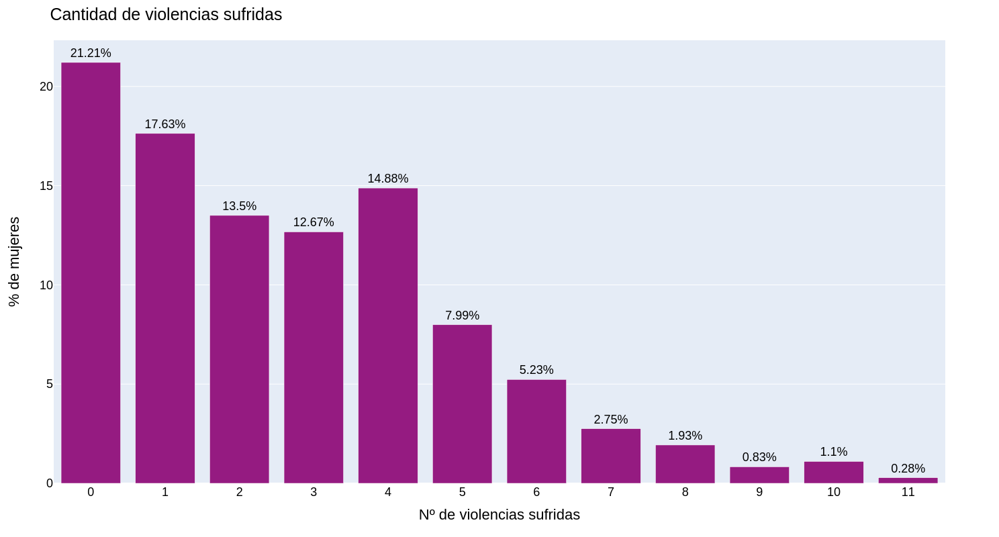

In [55]:
fig = px.bar(
    tbl_violencia_porcentaje,
    text_auto=True,
)
fig.update_layout(
    title="Cantidad de violencias sufridas",
    xaxis_title="Nº de violencias sufridas",
    yaxis_title="% de mujeres",
    font=dict(
        family="Arial",
        size=18,
        color="black",
    ),
    width=1500,
    height=800,
)
fig.update_traces(
    textfont_size=18,
    textangle=0,
    textposition="outside",
    cliponaxis=False,
    showlegend=False,
    marker_line_color="white",
    marker_color="rgb(149, 27, 129)",
    texttemplate="%{value}%",
)
fig.show()
fig.write_image("img/numero_violencia.png")

In [56]:
dic_violencias = {}
for i in violencias:
    dic_violencias[i] = [s for s in list(datos.columns)[:-32] if i in s]

### Análisis para los casos de duplicación de identidad

In [57]:
tbl_identidad = datos.query("identidad == 1")[dic_violencias["identidad"]]

Se han reportado 43 casos de duplicación de identidad.

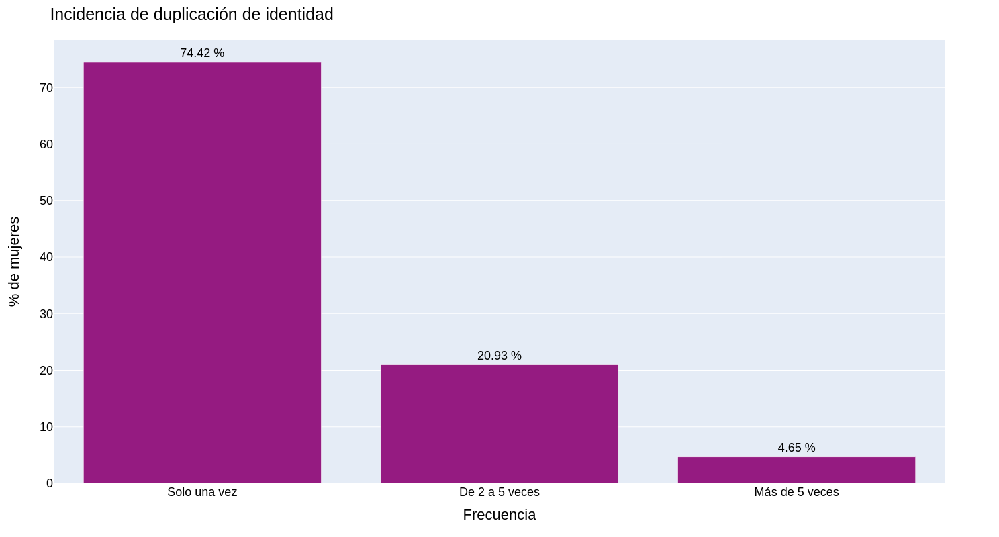

In [58]:
frecuencia_identidad = fg.grafico_frecuencia(tbl_identidad)

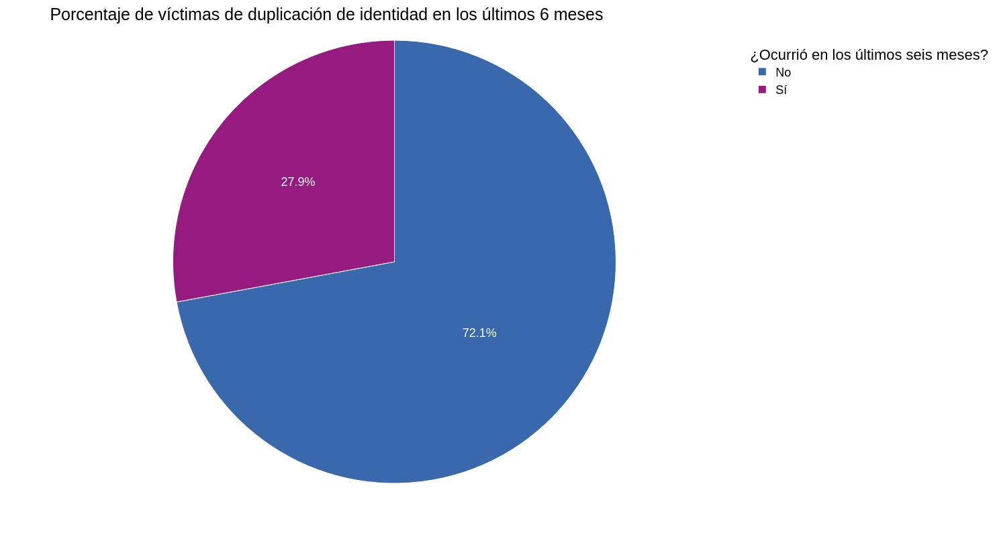

In [59]:
temporalidad_identidad = fg.grafico_temporalidad(tbl_identidad)

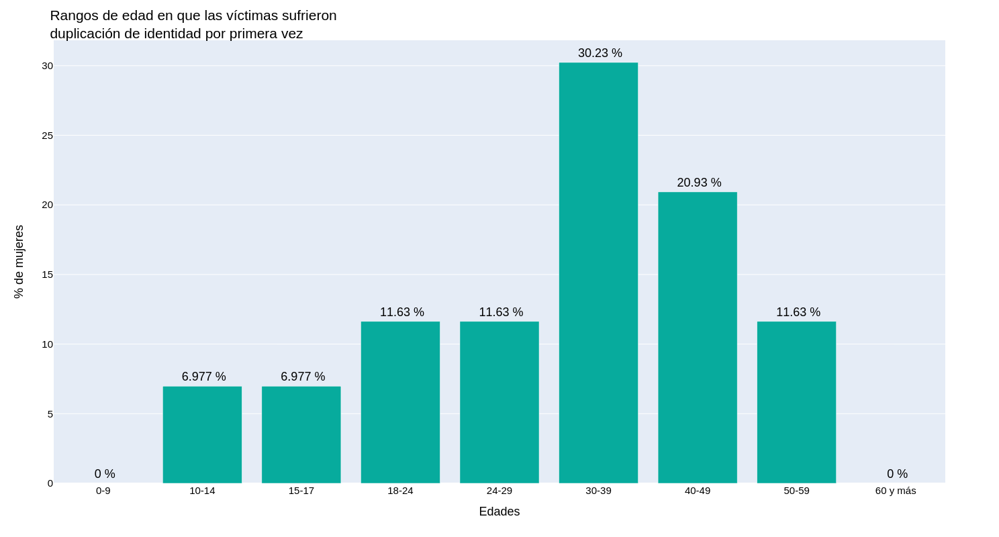

In [60]:
edad_identidad = fg.grafico_edad(tbl_identidad)

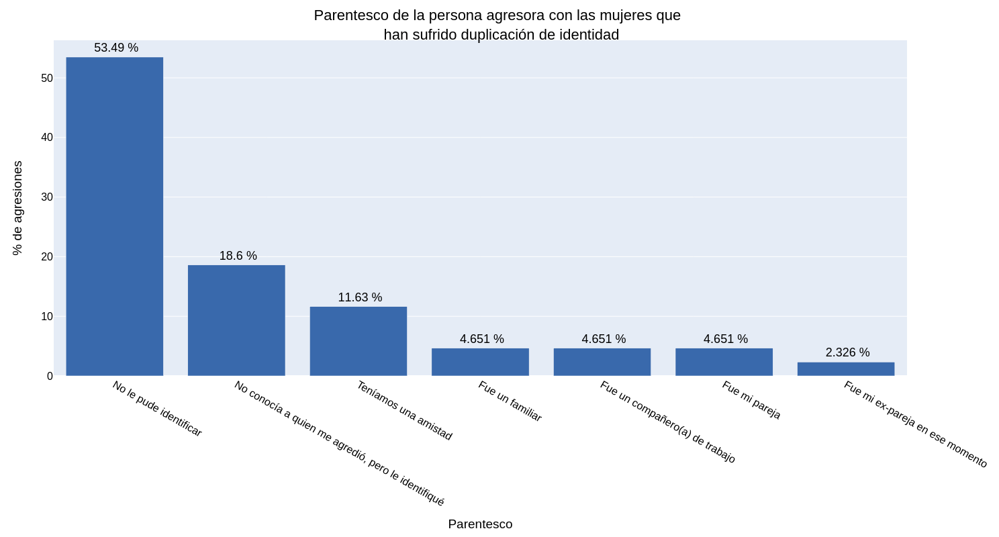

In [61]:
parentesco_identidad = fg.grafico_parentesco(tbl_identidad)

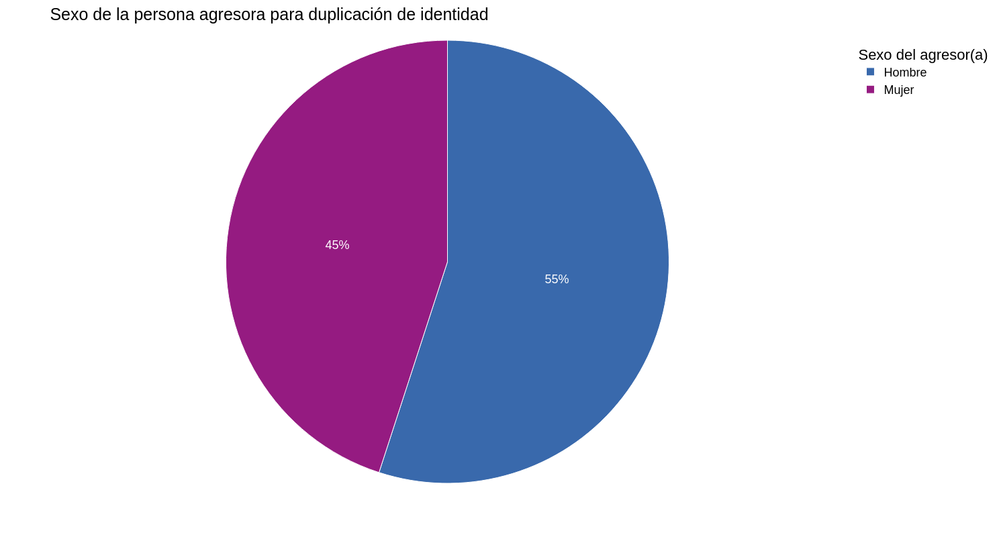

In [62]:
sexo_identidad = fg.grafico_sexo_parentesco(tbl_identidad)

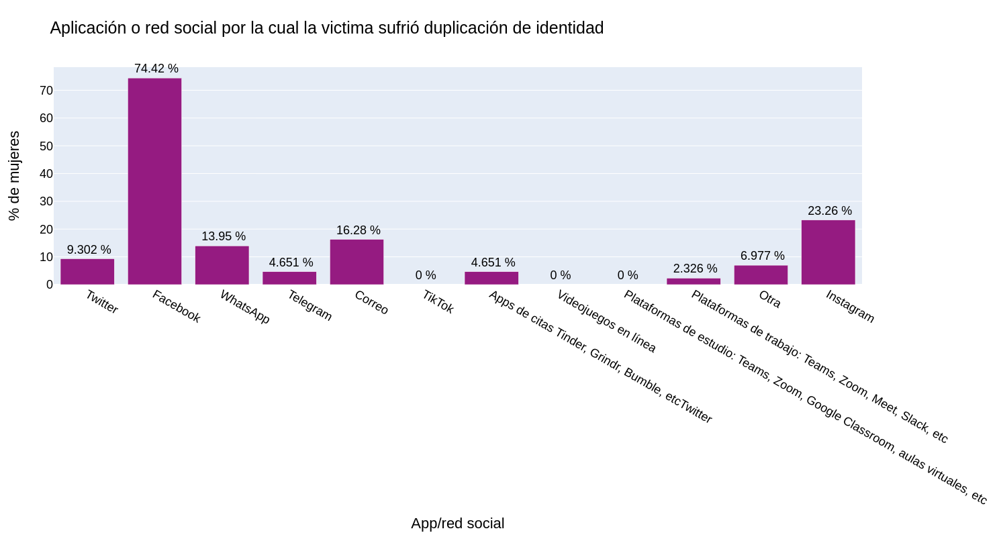

In [63]:
medios_identidad = fg.grafico_medios(tbl_identidad)[2]

In [64]:
pd.DataFrame(tbl_identidad.otraR_identidad.value_counts()).rename_axis(
    index={"otraR_identidad": "Otras aplicaciones o redes sociales"}
).rename(columns={"count": "N° de Mujeres"})

,N° de Mujeres
Otras aplicaciones o redes sociales,
gmail,1
Bigo,1
Hive,1


### Análisis para los casos de ciberacoso

In [65]:
tbl_ciberacoso = datos.query("ciberacoso == 1")[dic_violencias["ciberacoso"]]

Se han reportado 135 casos de ciberacoso.

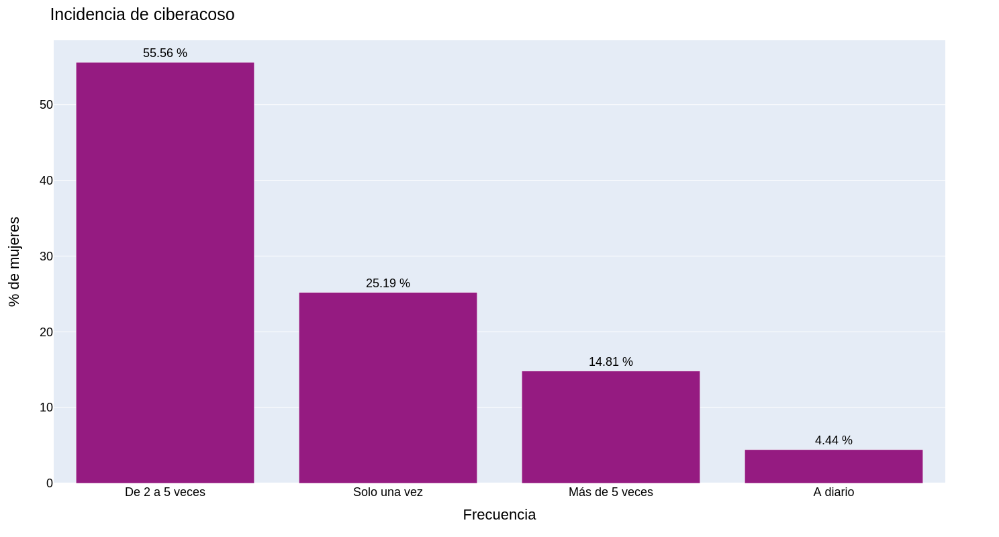

In [66]:
frecuencia_ciberacoso = fg.grafico_frecuencia(tbl_ciberacoso)

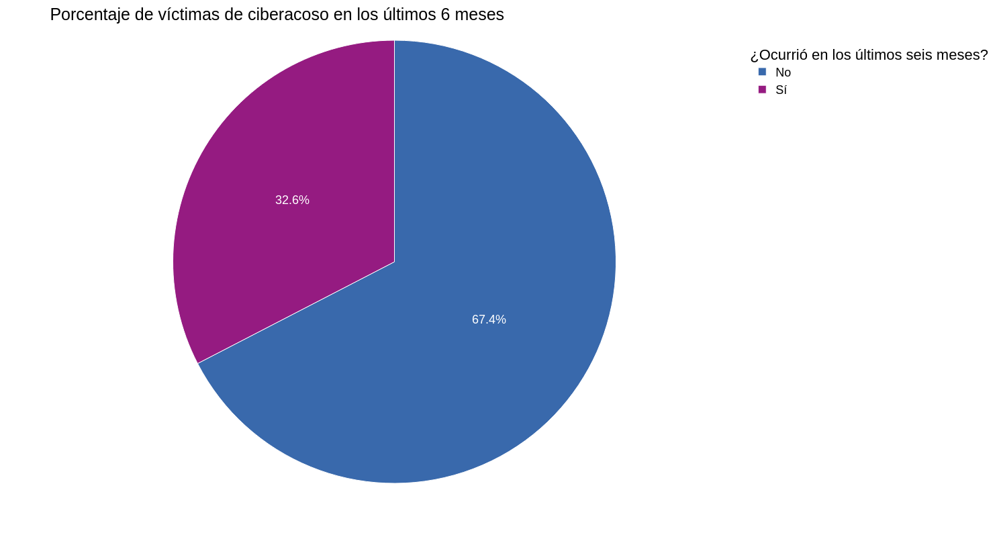

In [67]:
temporalidad_ciberacoso = fg.grafico_temporalidad(tbl_ciberacoso)

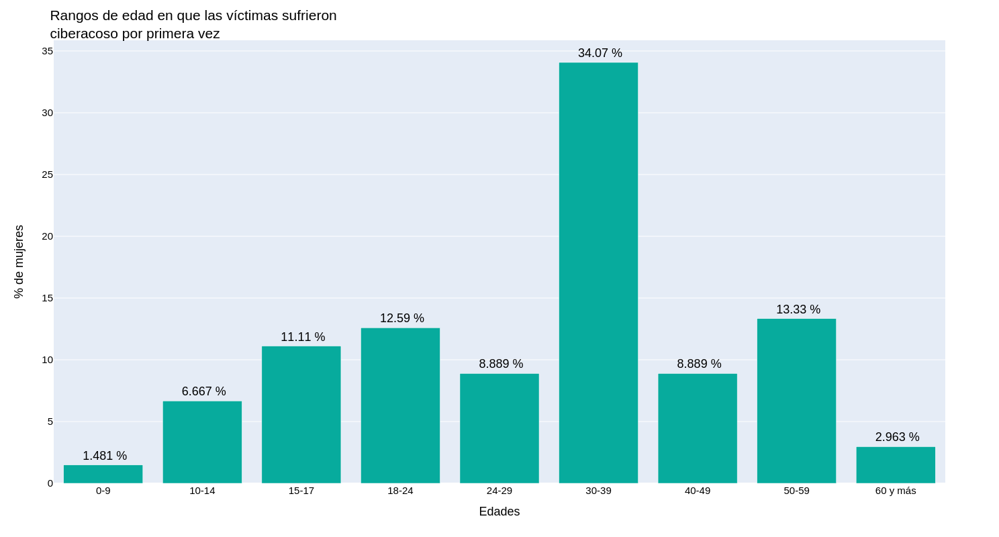

In [68]:
edad_ciberacoso = fg.grafico_edad(tbl_ciberacoso)

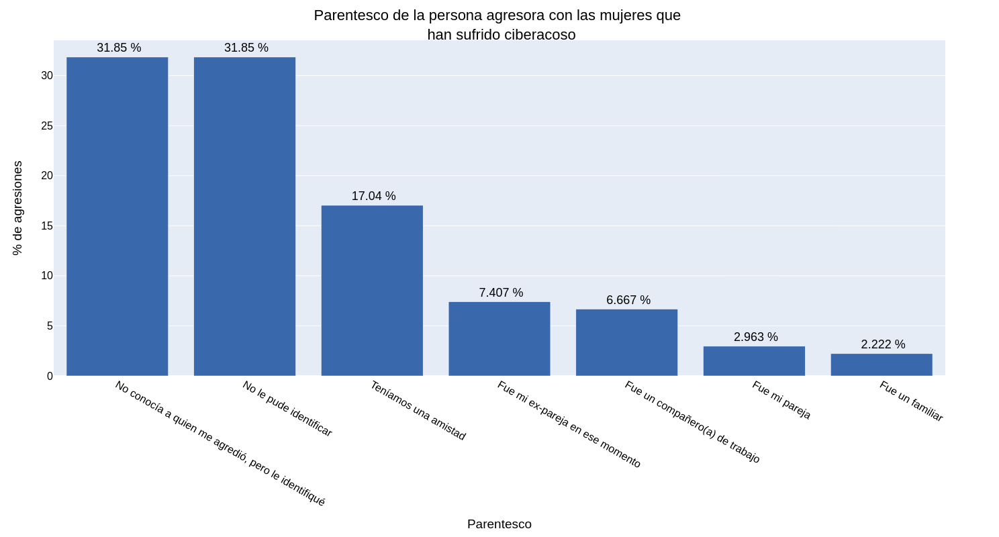

In [69]:
parentesco_ciberacoso = fg.grafico_parentesco(tbl_ciberacoso)

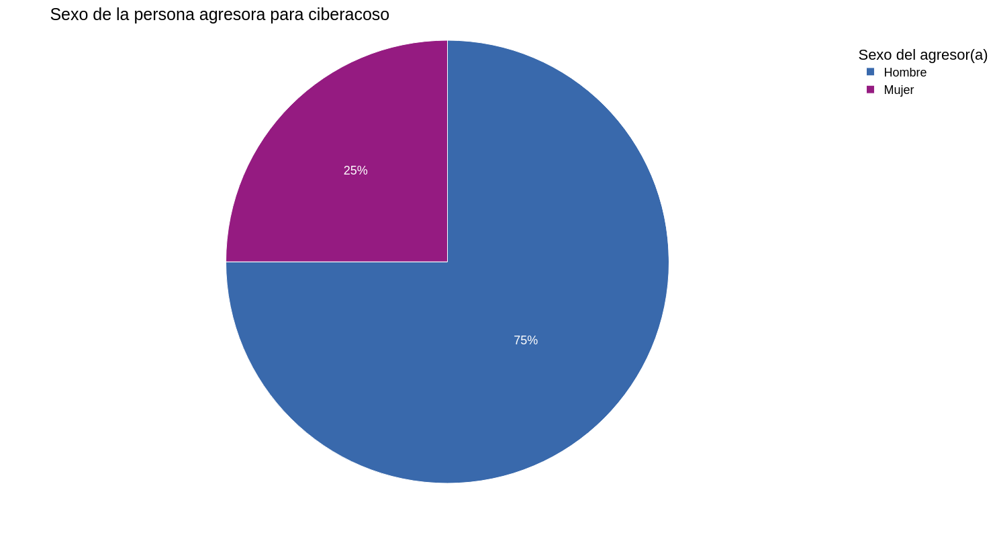

In [70]:
sexo_ciberacoso = fg.grafico_sexo_parentesco(tbl_ciberacoso)

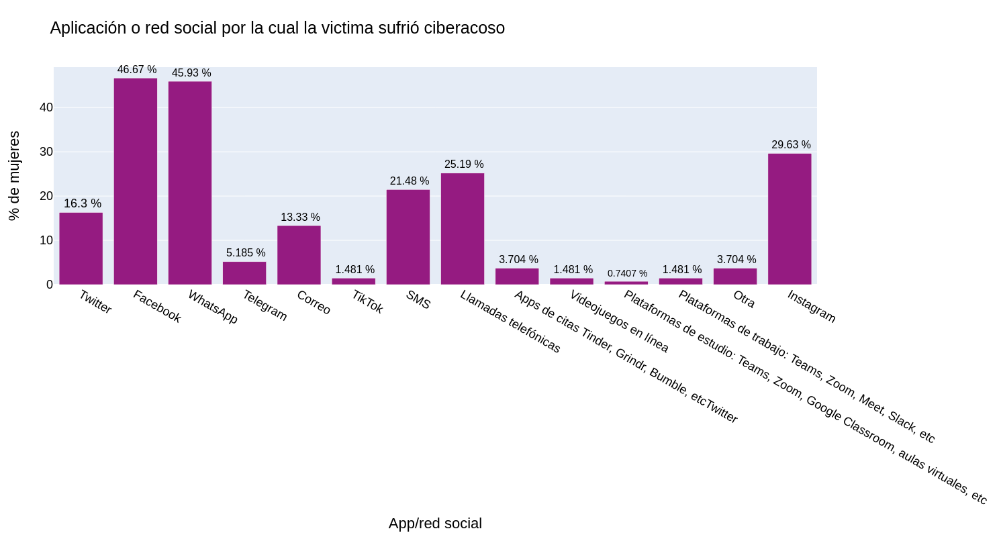

In [71]:
medios_ciberacoso = fg.grafico_medios(tbl_ciberacoso)[2]

In [72]:
pd.DataFrame(tbl_ciberacoso.otraR_ciberacoso.value_counts()).rename_axis(
    index={"otraR_ciberacoso": "Otras aplicaciones o redes sociales"}
).rename(columns={"count": "N° de mujeres"})

,N° de mujeres
Otras aplicaciones o redes sociales,
Ping,1
Blogger,1
Personalmente,1
messenger de MSN,1
Messenger,1


### Análisis para los casos doxxing

In [73]:
tbl_doxxing = datos.query("doxxing == 1")[dic_violencias["doxxing"]]

Se han reportado 45 casos de doxxing.

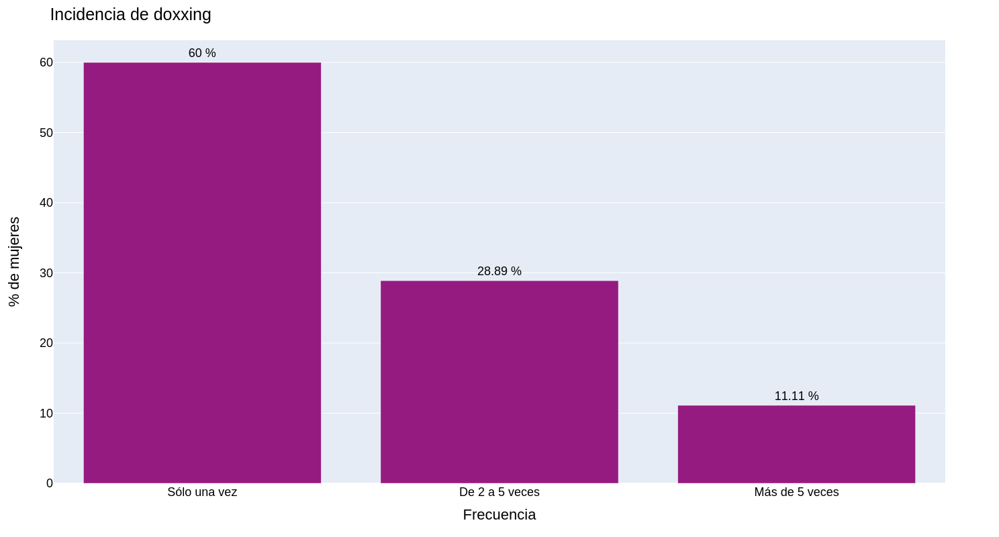

In [74]:
frecuencia_doxxing = fg.grafico_frecuencia(tbl_doxxing)

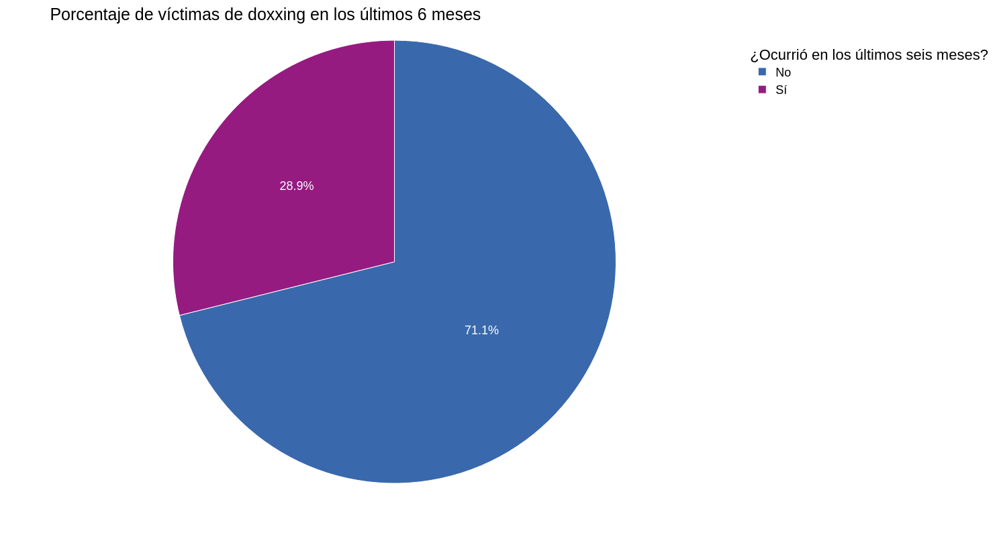

In [75]:
temporalidad_doxxing = fg.grafico_temporalidad(tbl_doxxing)

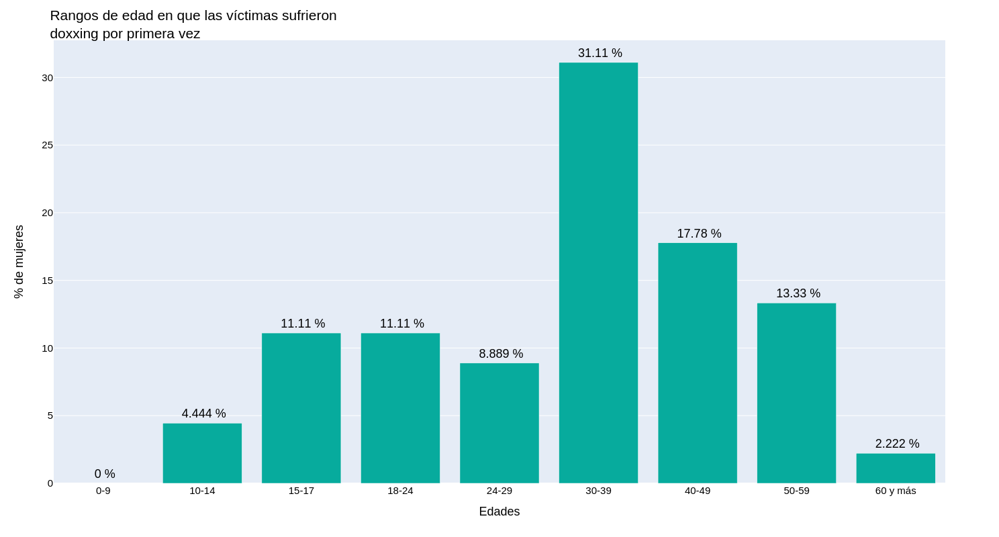

In [76]:
edad_doxxing = fg.grafico_edad(tbl_doxxing)

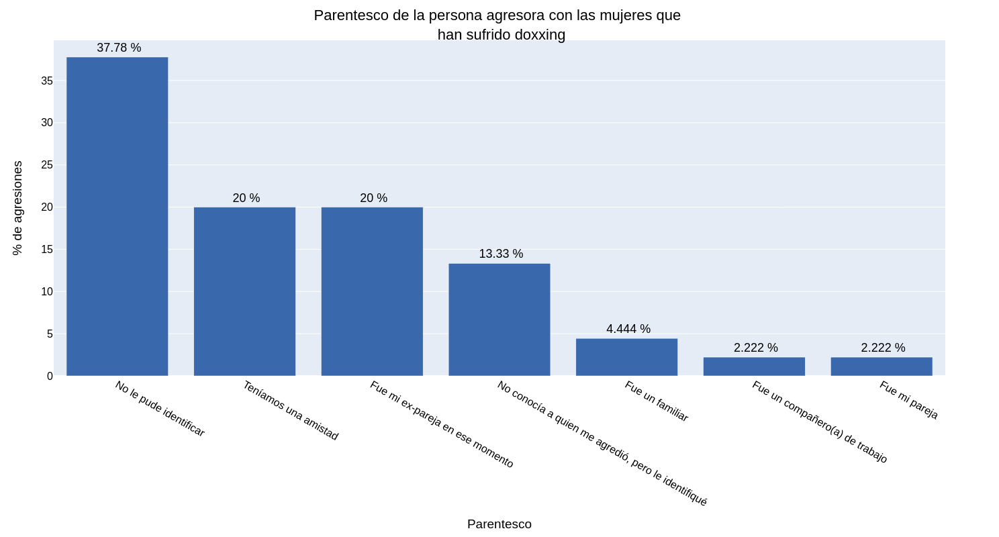

In [77]:
parentesco_doxxing = fg.grafico_parentesco(tbl_doxxing)

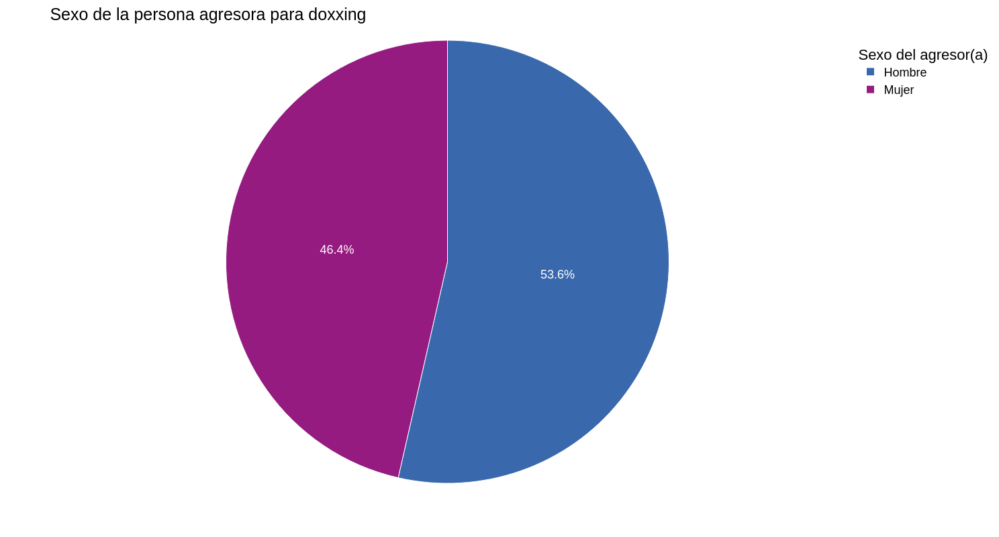

In [78]:
sexo_doxxing = fg.grafico_sexo_parentesco(tbl_doxxing)

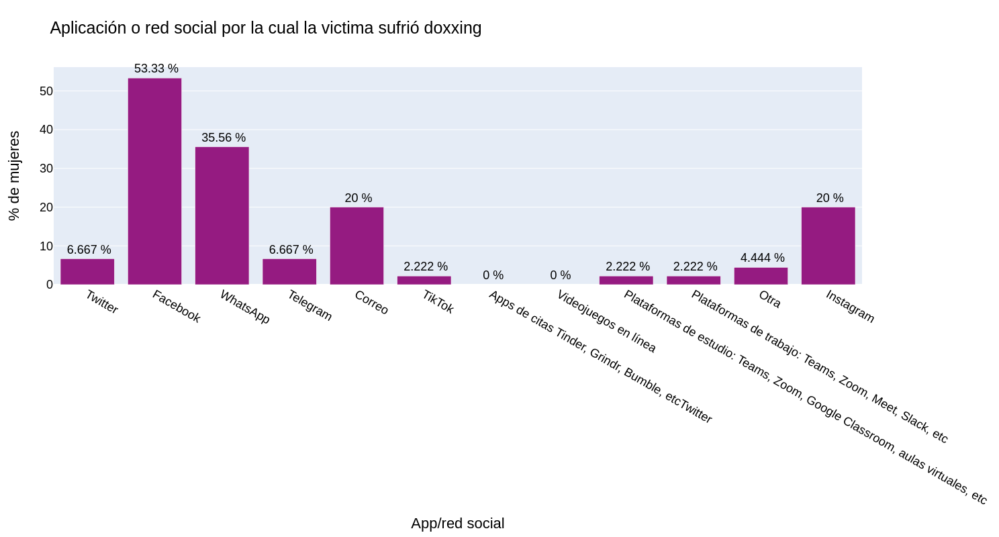

In [79]:
medios_doxxing = fg.grafico_medios(tbl_doxxing)[2]

In [80]:
pd.DataFrame(tbl_doxxing.otraR_doxxing.value_counts()).rename_axis(
    index={"otraR_doxxing": "Otras aplicaciones o redes sociales"}
).rename(columns={"count": "N° de mujeres"})

,N° de mujeres
Otras aplicaciones o redes sociales,
Hispachan,1
Correo electrónico,1


### Análisis para los casos de mobbing

In [81]:
tbl_mobbing = datos.query("mobbing == 1")[dic_violencias["mobbing"]]

Se han reportado 58 casos de mobbing.

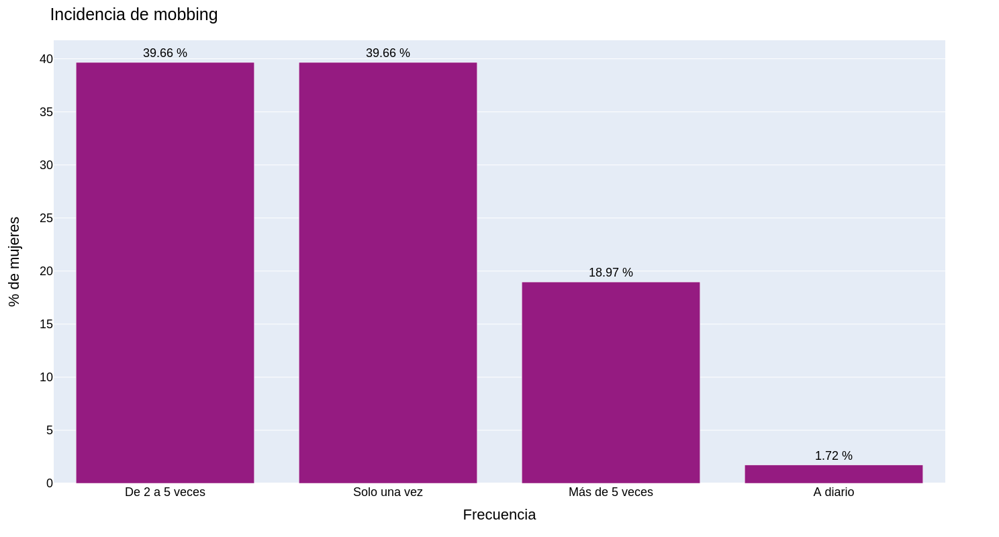

In [82]:
frecuencia_mobbing = fg.grafico_frecuencia(tbl_mobbing)

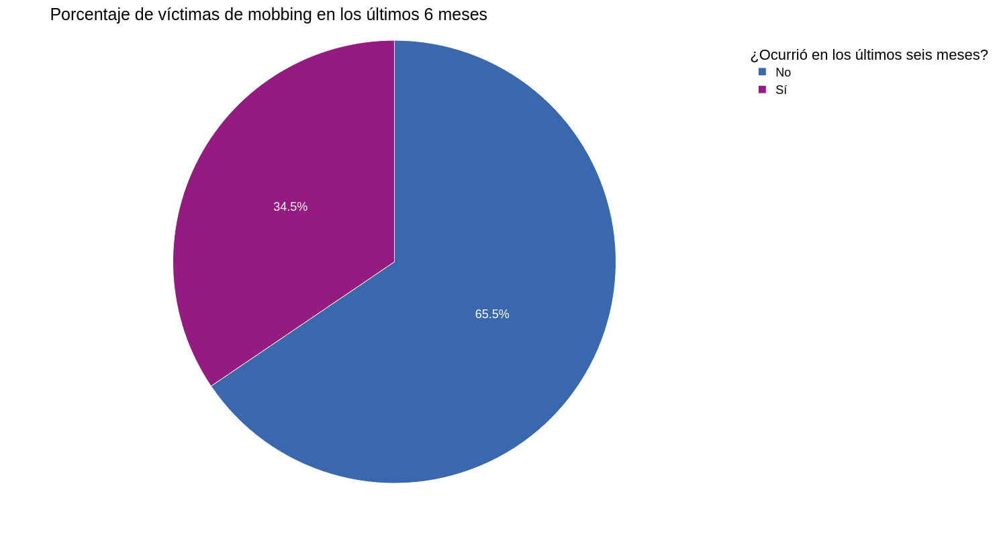

In [83]:
temporalidad_mobbing = fg.grafico_temporalidad(tbl_mobbing)

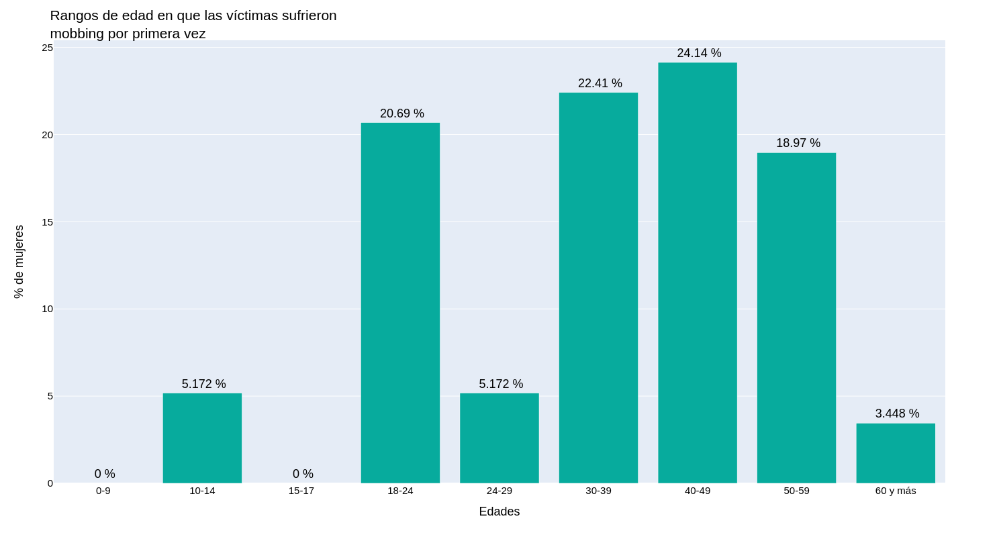

In [84]:
edad_mobbing = fg.grafico_edad(tbl_mobbing)

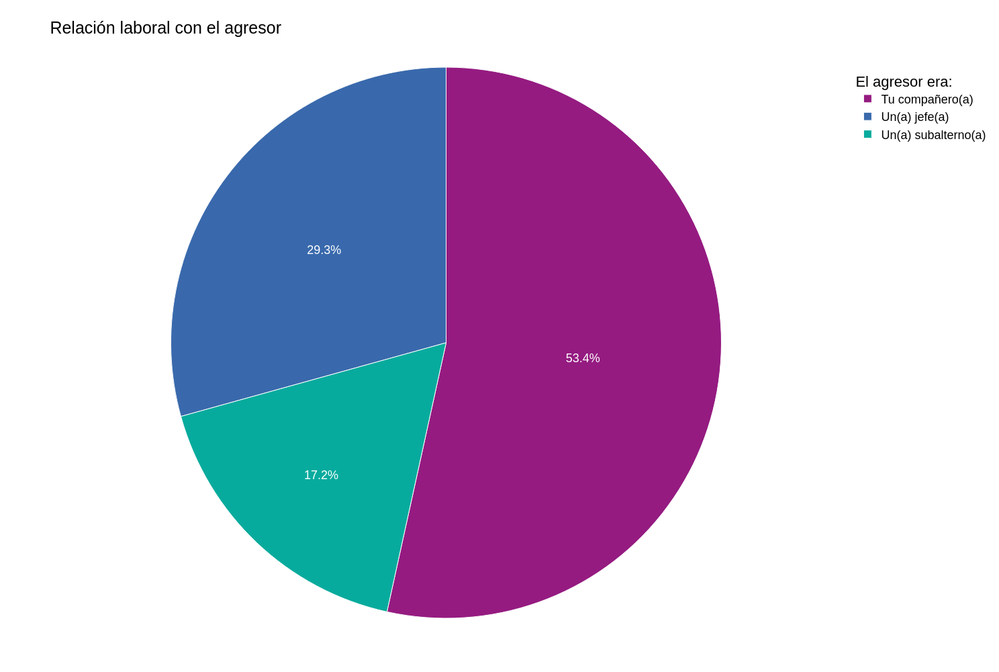

In [85]:
parentesco_mobbing = fg.grafico_parentesco(tbl_mobbing)

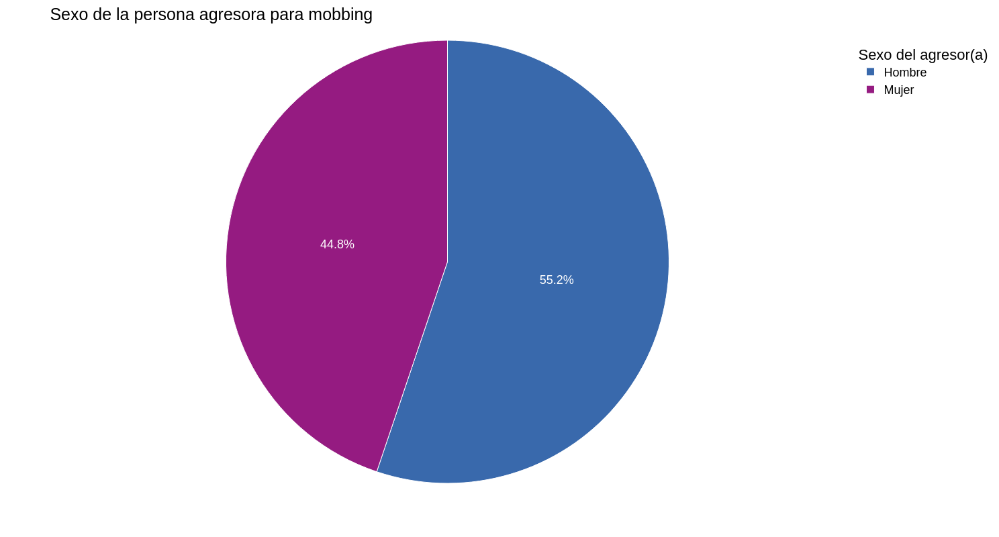

In [86]:
sexo_mobbing = fg.grafico_sexo_parentesco(tbl_mobbing)

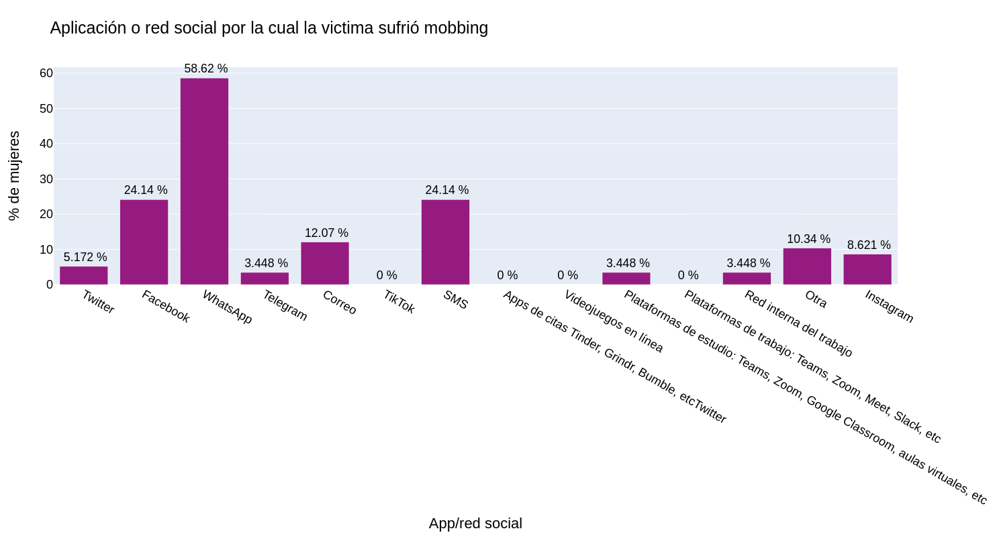

In [87]:
medios_mobbing = fg.grafico_medios(tbl_mobbing)[2]

In [88]:
pd.DataFrame(tbl_mobbing.otraR_mobbing.value_counts()).rename_axis(
    index={"otraR_mobbing": "Otras aplicaciones o redes sociales"}
).rename(columns={"count": "N° de mujeres"})

,N° de mujeres
Otras aplicaciones o redes sociales,
Llamada,1
Persona,1
Televisión,1
Personal,1
Google hangouts,1
Impreso,1


### Análisis para los casos de ciberdifamación

In [89]:
tbl_ciberdifamacion = datos.query("ciberdifamacion == 1")[
    dic_violencias["ciberdifamacion"]
]

Se han reportado 60 casos de ciberdifamación.

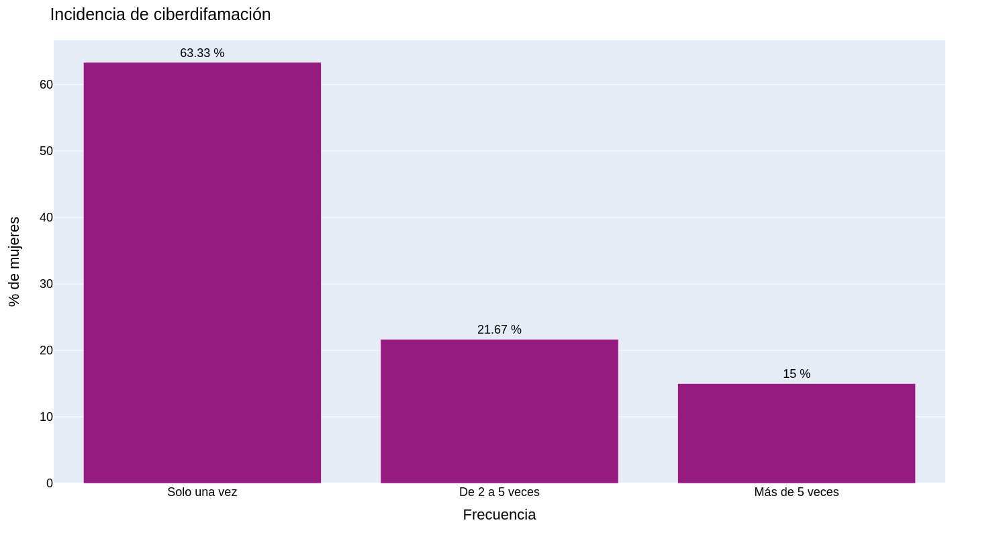

In [90]:
frecuencia_ciberdifamacion = fg.grafico_frecuencia(tbl_ciberdifamacion)

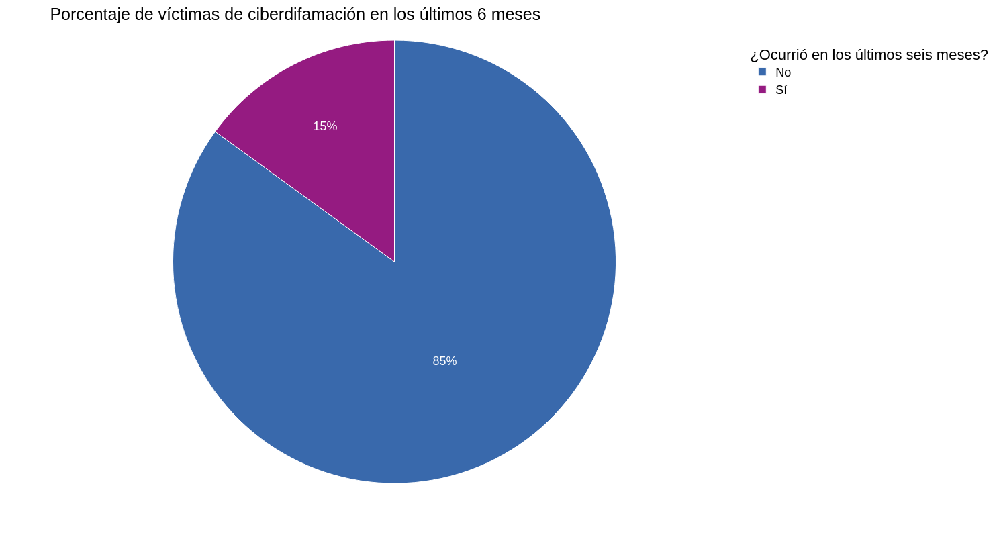

In [91]:
temporalidad_ciberdifamacion = fg.grafico_temporalidad(tbl_ciberdifamacion)

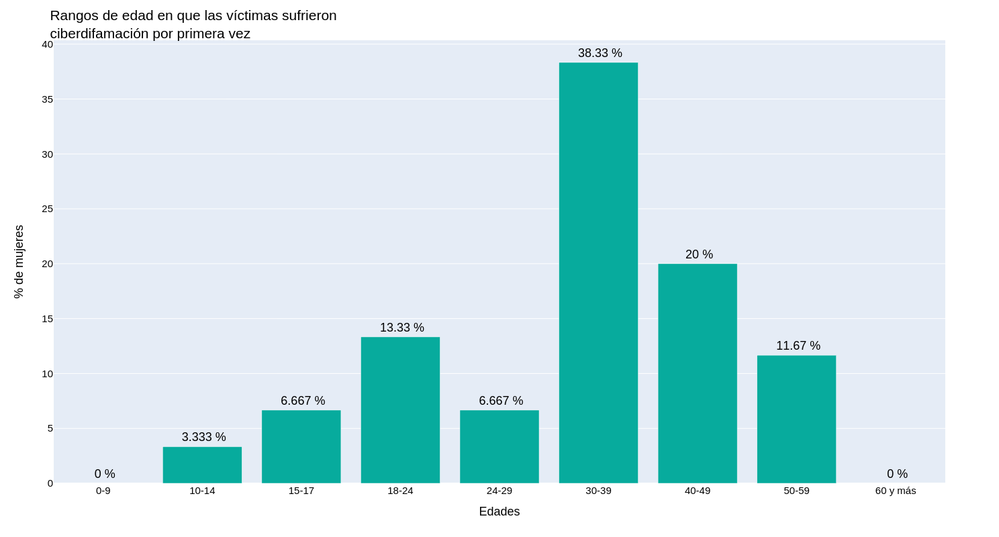

In [92]:
edad_ciberdifamacion = fg.grafico_edad(tbl_ciberdifamacion)

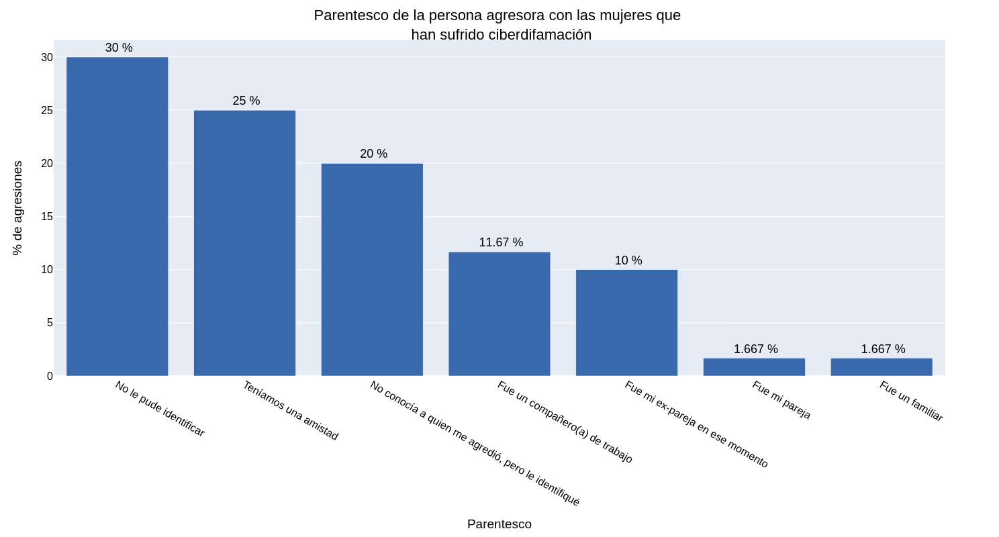

In [93]:
parentesco_ciberdifamacion = fg.grafico_parentesco(tbl_ciberdifamacion)

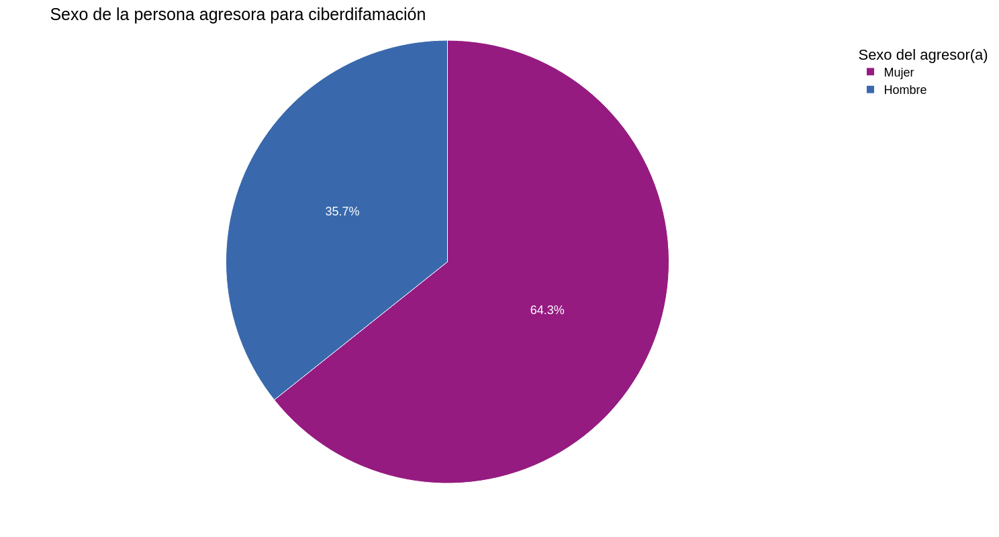

In [94]:
sexo_ciberdifamacion = fg.grafico_sexo_parentesco(tbl_ciberdifamacion)

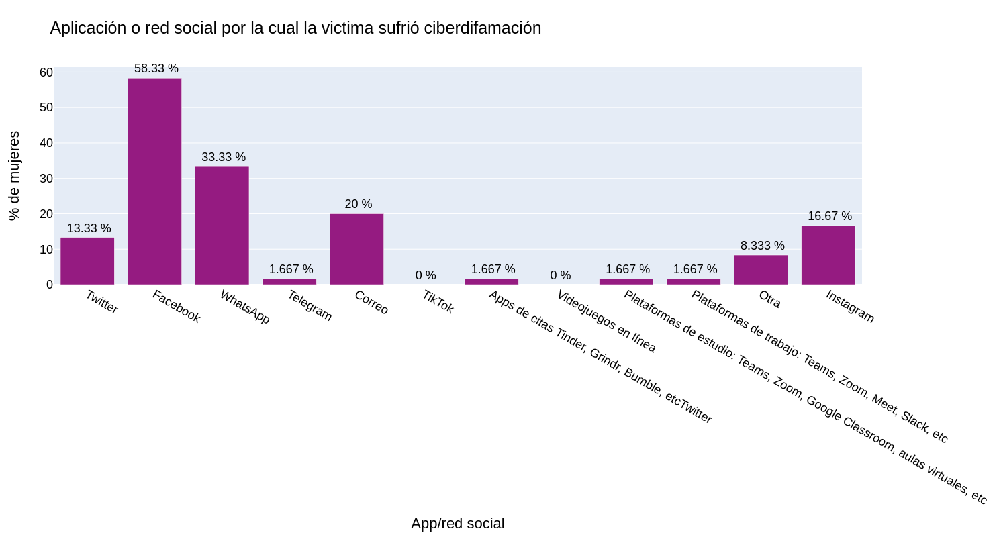

In [95]:
medios_ciberdifamacion = fg.grafico_medios(tbl_ciberdifamacion)[2]

In [96]:
pd.DataFrame(tbl_ciberdifamacion.otraR_ciberdifamacion.value_counts()).rename_axis(
    index={"otraR_ciberdifamacion": "Otras aplicaciones o redes sociales"}
).rename(columns={"count": "N° de mujeres"})

,N° de mujeres
Otras aplicaciones o redes sociales,
Ask.fm,1
Portal web,1
Twitter,1
Mensajería Blackberry,1
Prensa escrita,1


### Análisis para los casos de cibervigilancia (stalking)

In [97]:
tbl_stalking = datos.query("stalking == 1")[dic_violencias["stalking"]]

Se han reportado 166 casos de stalking.

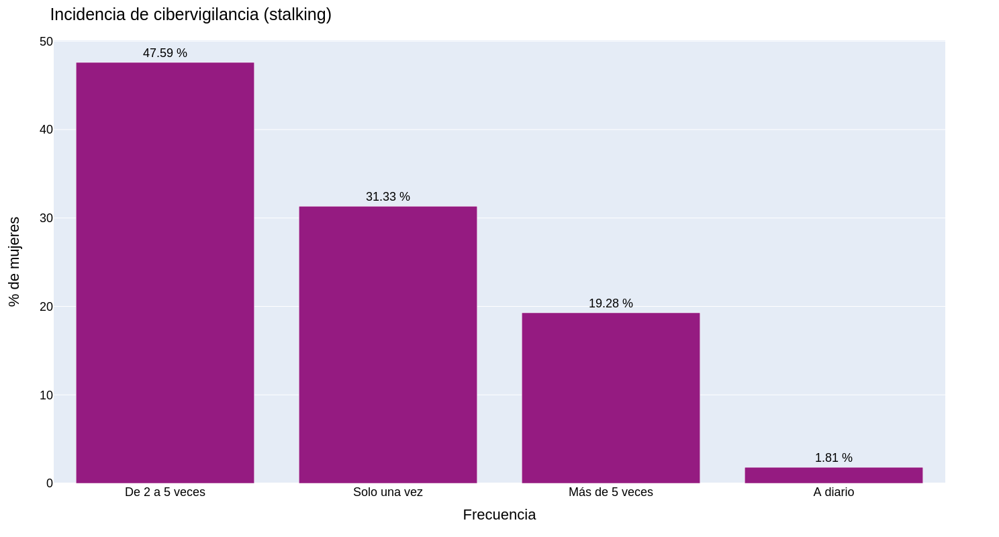

In [98]:
frecuencia_stalking = fg.grafico_frecuencia(tbl_stalking)

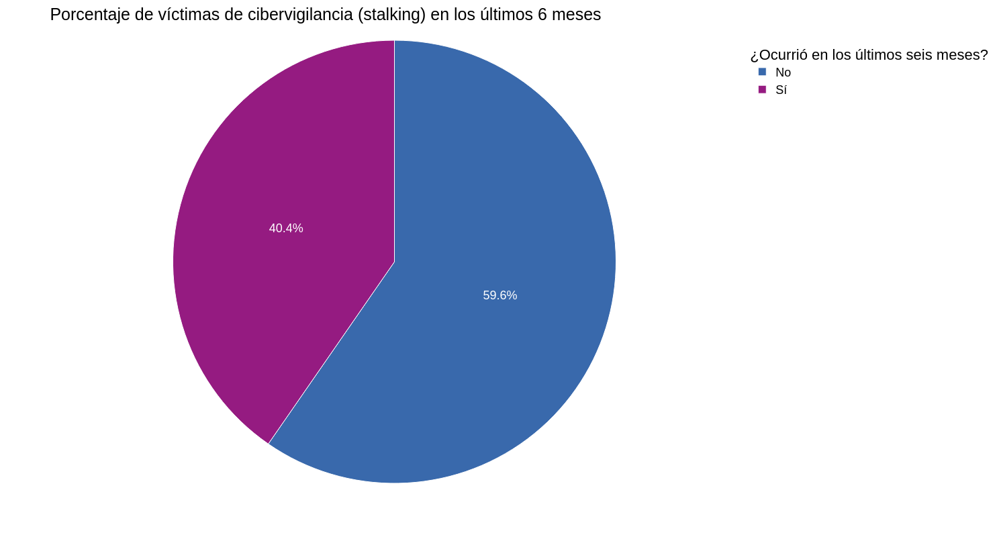

In [99]:
temporalidad_stalking = fg.grafico_temporalidad(tbl_stalking)

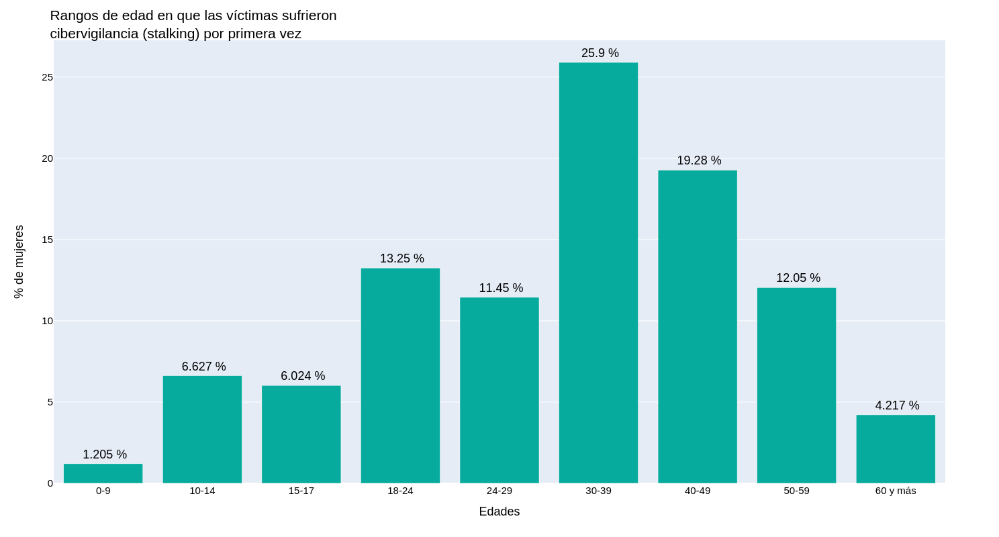

In [100]:
edad_stalking = fg.grafico_edad(tbl_stalking)

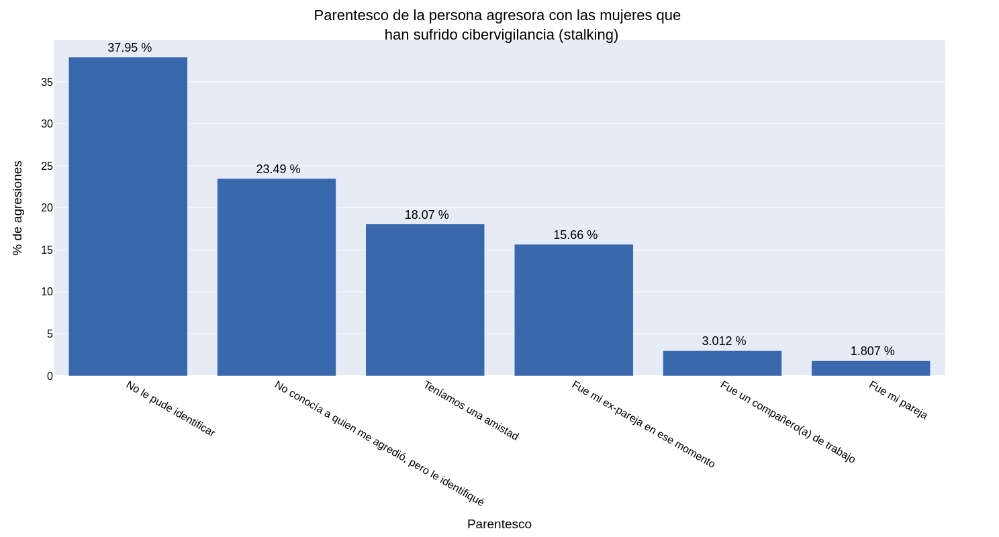

In [101]:
parentesco_stalking = fg.grafico_parentesco(tbl_stalking)

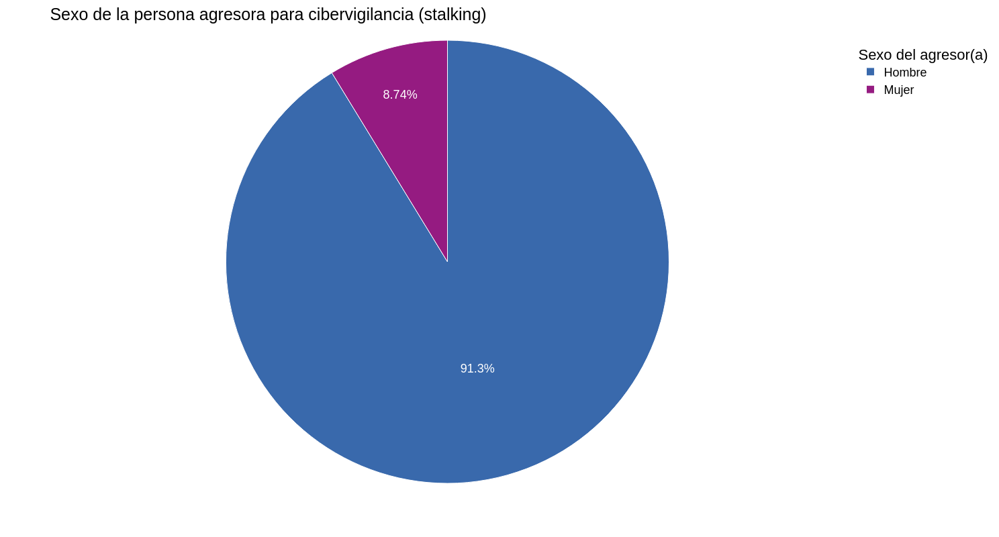

In [102]:
sexo_stalking = fg.grafico_sexo_parentesco(tbl_stalking)

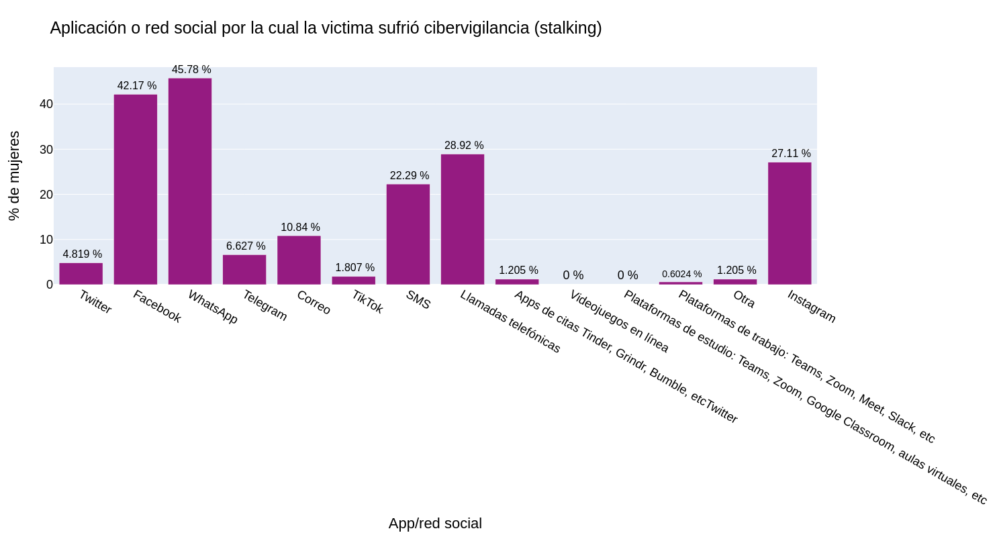

In [103]:
medios_stalking = fg.grafico_medios(tbl_stalking)[2]

In [104]:
pd.DataFrame(tbl_stalking.otraR_stalking.value_counts()).rename_axis(
    index={"otraR_stalking": "Otras aplicaciones o redes sociales"}
).rename(columns={"count": "N° de mujeres"})

,N° de mujeres
Otras aplicaciones o redes sociales,
Skype,1
Washaop,1


### Análisis para los casos de ciberextorsion

In [105]:
tbl_ciberextorsion = datos.query("ciberextorsion == 1")[
    dic_violencias["ciberextorsion"]
]

Se han reportado 21 casos de ciberextorsión.

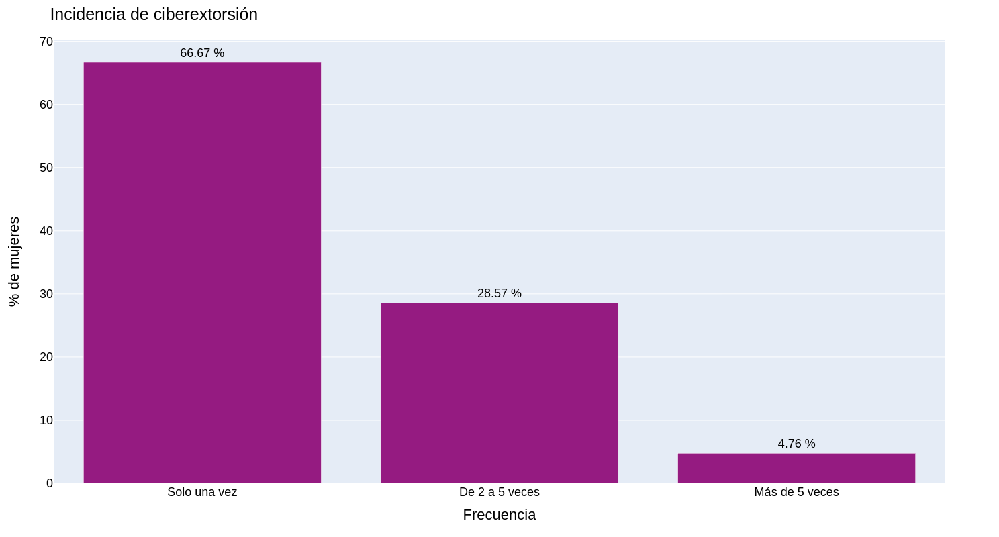

In [106]:
frecuencia_ciberextorsion = fg.grafico_frecuencia(tbl_ciberextorsion)

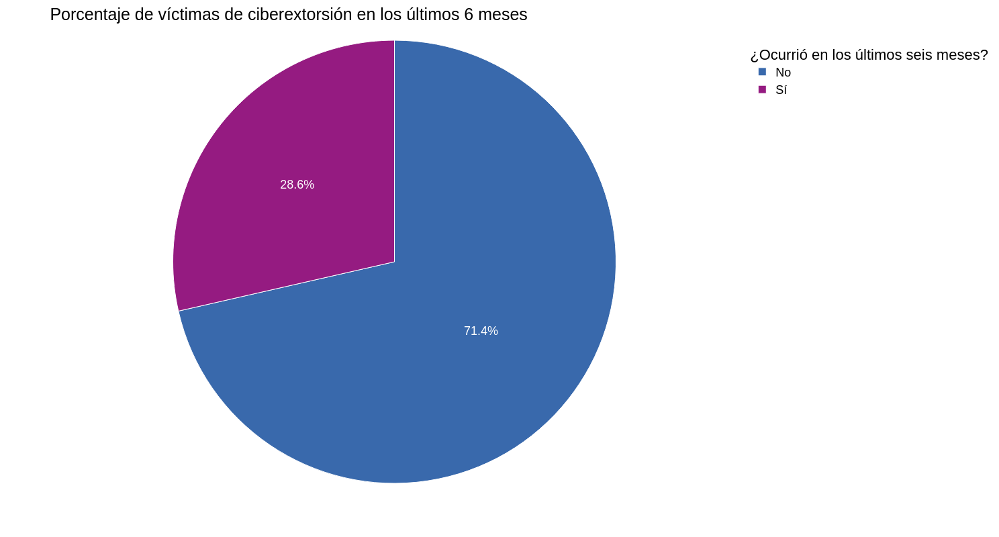

In [107]:
temporalidad_ciberextorsion = fg.grafico_temporalidad(tbl_ciberextorsion)

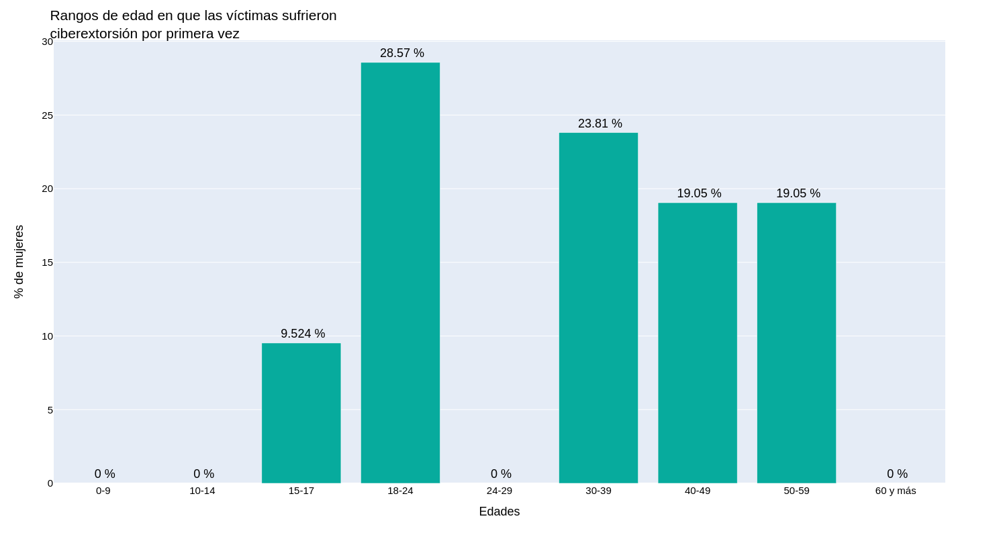

In [108]:
edad_ciberextorsion = fg.grafico_edad(tbl_ciberextorsion)

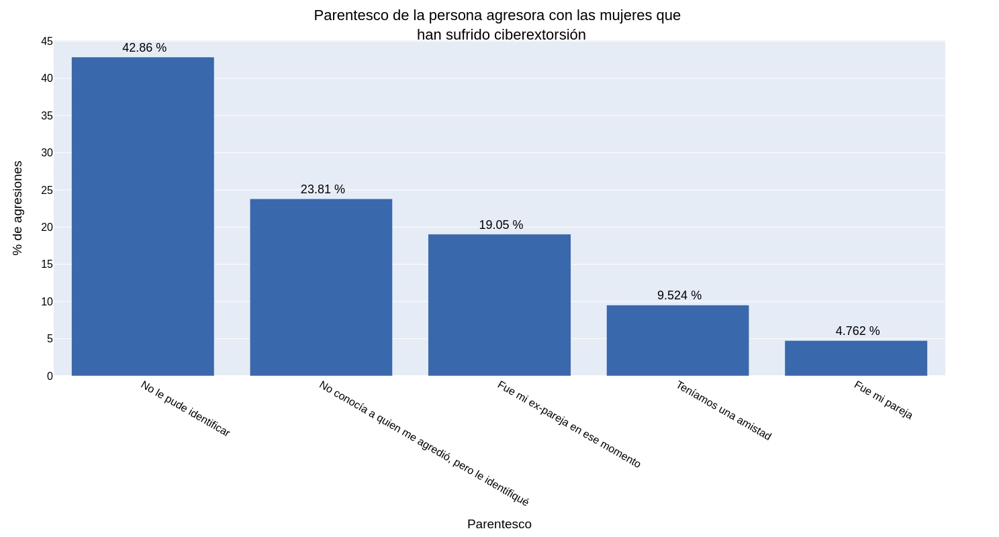

In [109]:
parentesco_ciberextorsion = fg.grafico_parentesco(tbl_ciberextorsion)

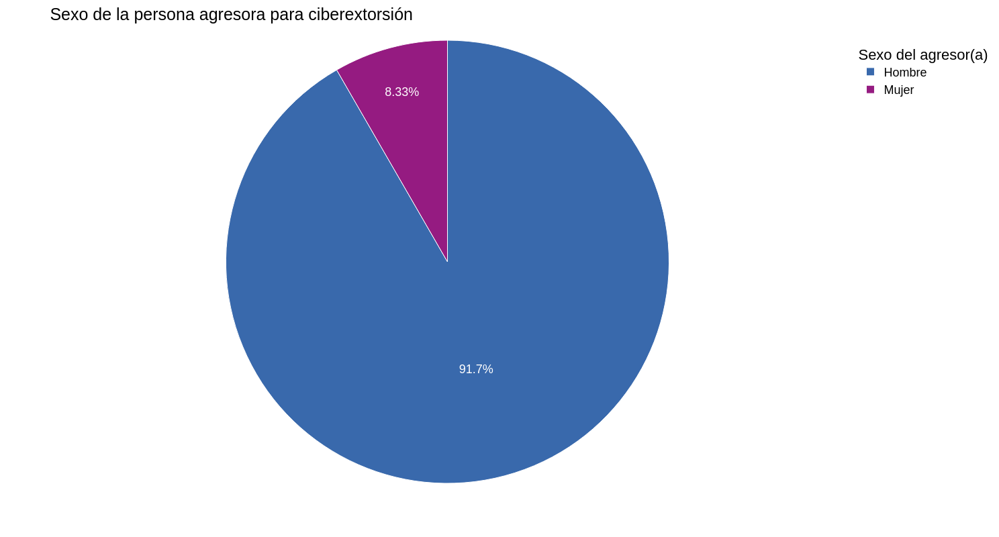

In [110]:
sexo_ciberextorsion = fg.grafico_sexo_parentesco(tbl_ciberextorsion)

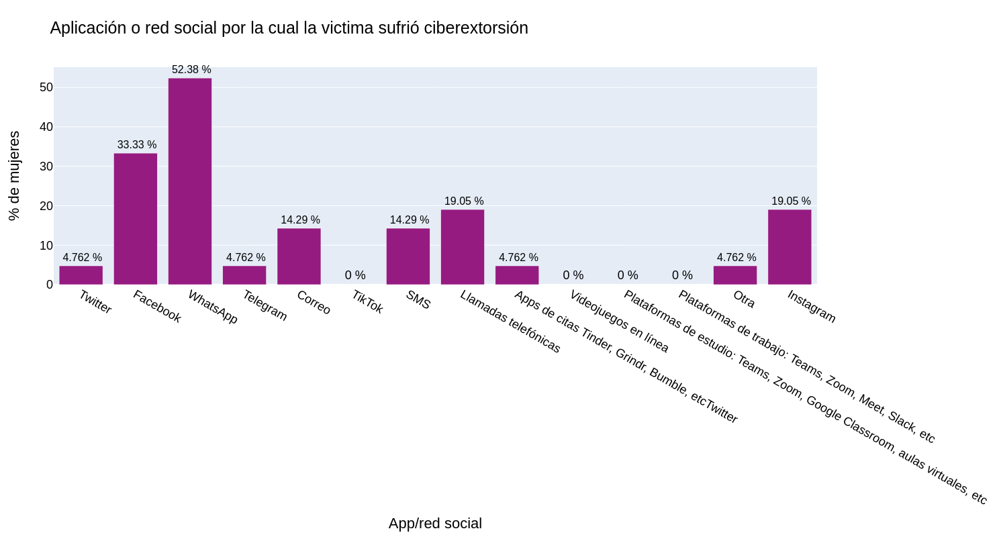

In [111]:
medios_ciberextorsion = fg.grafico_medios(tbl_ciberextorsion)[2]

In [112]:
pd.DataFrame(tbl_ciberextorsion.otraR_ciberextorsion.value_counts()).rename_axis(
    index={"otraR_ciberextorsion": "Otras aplicaciones o redes sociales"}
).rename(columns={"count": "N° de mujeres"})

,N° de mujeres
Otras aplicaciones o redes sociales,
Skype,1


### Análisis para los casos de grooming

In [113]:
tbl_grooming = datos.query("grooming == 1")[dic_violencias["grooming"]]

Se han reportado 40 casos de grooming.

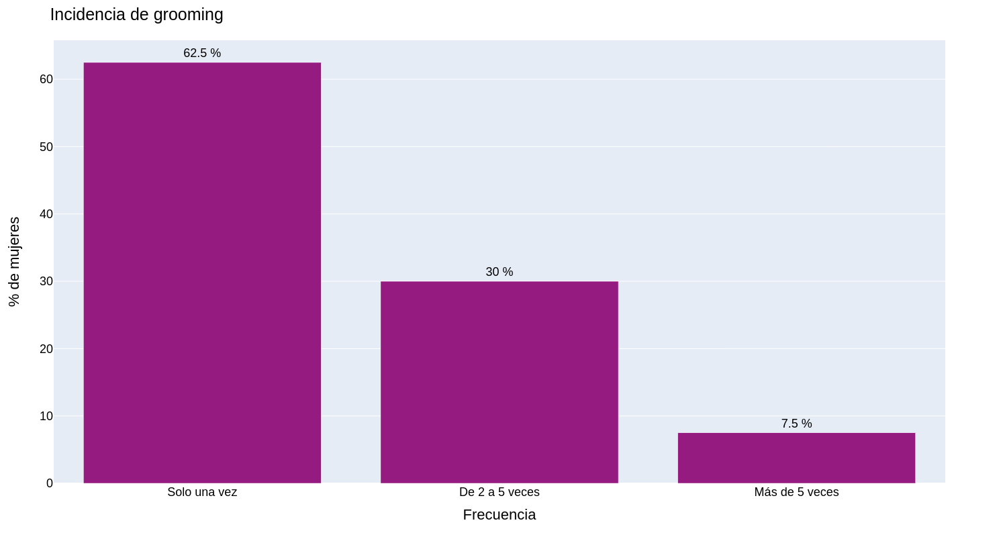

In [114]:
frecuencia_grooming = fg.grafico_frecuencia(tbl_grooming)

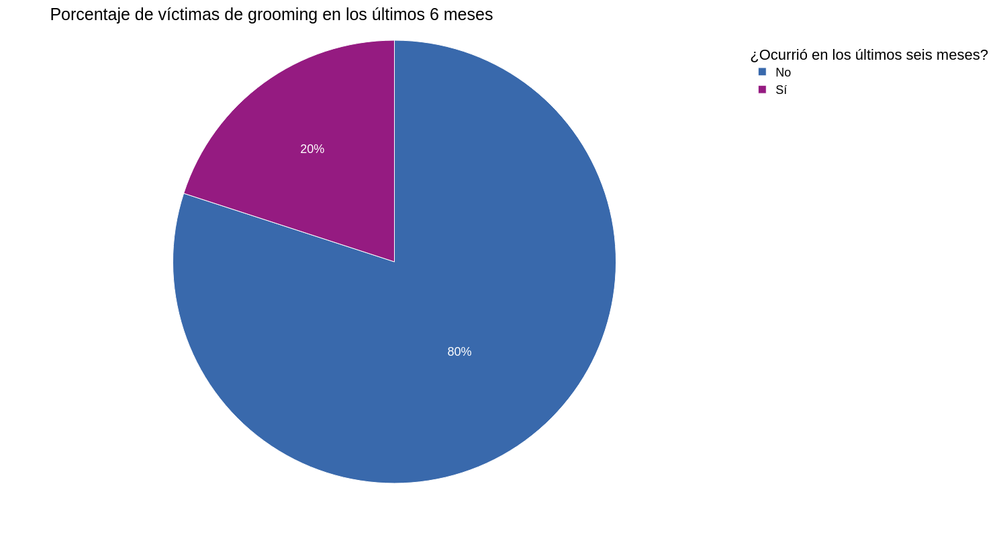

In [115]:
temporalidad_grooming = fg.grafico_temporalidad(tbl_grooming)

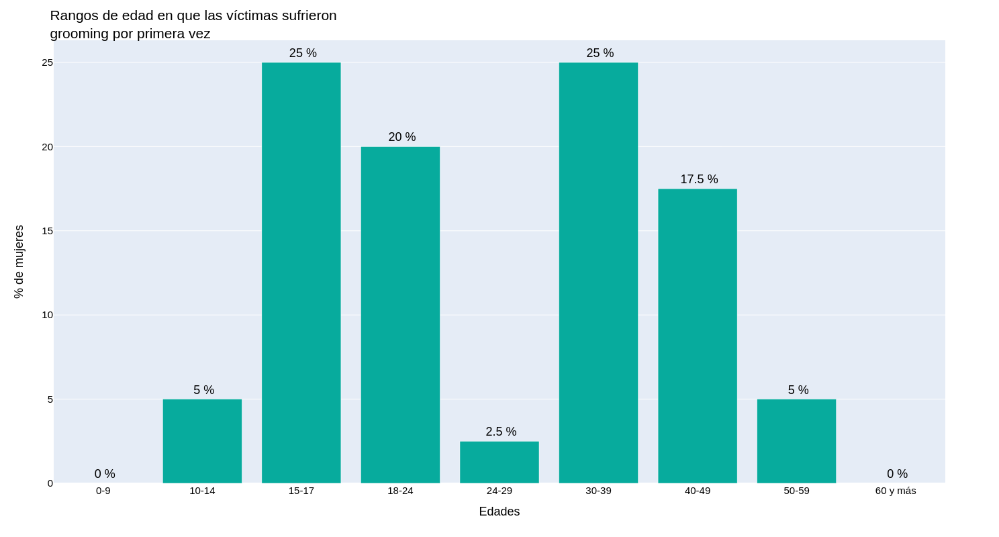

In [116]:
edad_grooming = fg.grafico_edad(tbl_grooming)

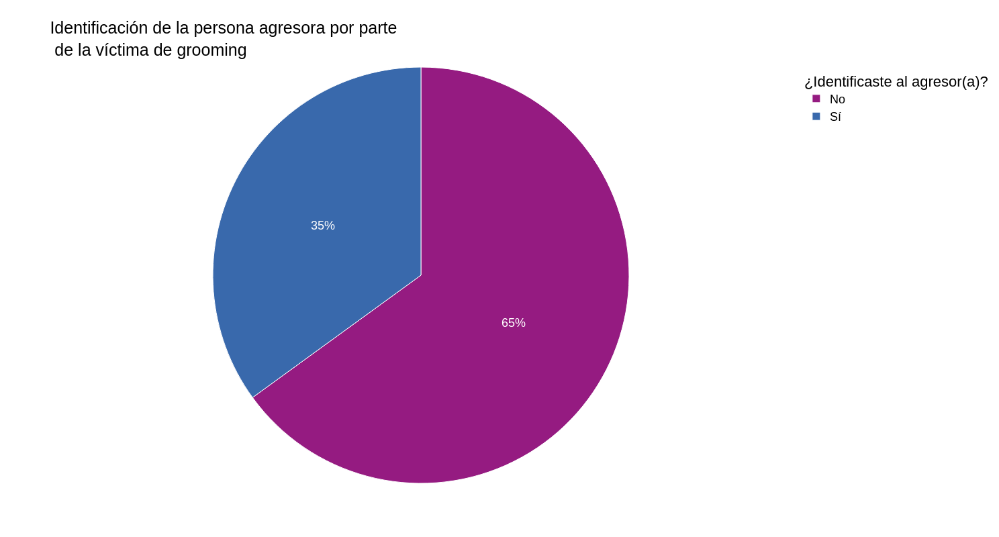

In [117]:
parentesco_grooming = fg.grafico_parentesco(tbl_grooming)

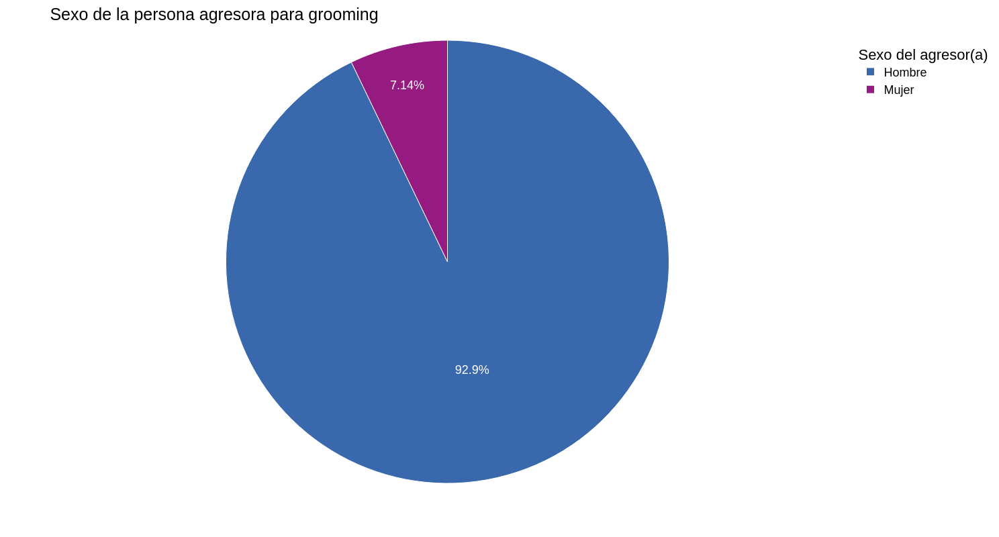

In [118]:
sexo_grooming = fg.grafico_sexo_parentesco(tbl_grooming)

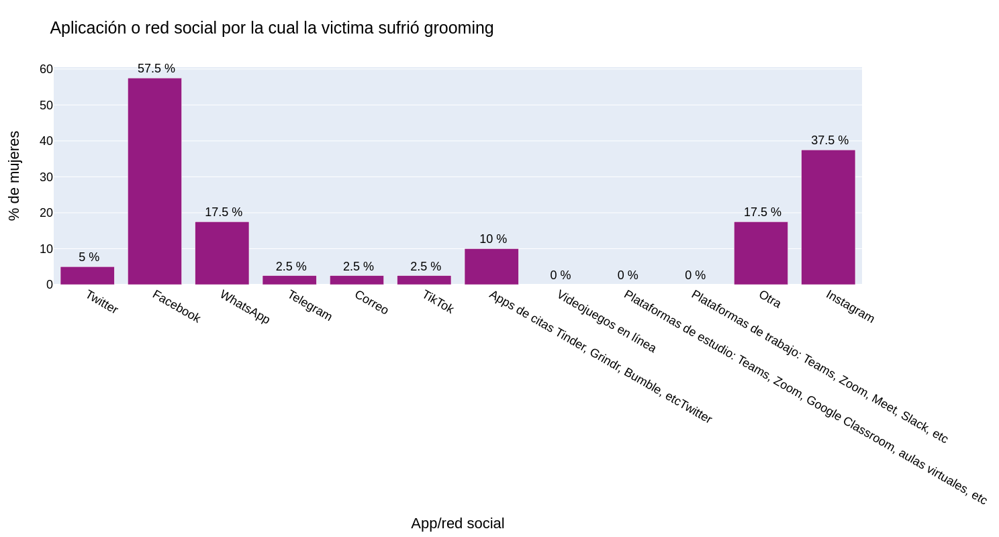

In [119]:
medios_grooming = fg.grafico_medios(tbl_grooming)[2]

In [120]:
pd.DataFrame(tbl_grooming.otraR_grooming.value_counts()).rename_axis(
    index={"otraR_grooming": "Otras aplicaciones o redes sociales"}
).rename(columns={"count": "N° de mujeres"})

,N° de mujeres
Otras aplicaciones o redes sociales,
Hello tall,1
"Messenger, cuando existia",1
Chats internacionales (Latinchat),1
Skype,1
"Messenger, hi5, latinchat",1
Messenger,1
Iqc,1


### Análisis para los casos de phishing-vishing-smishing

In [121]:
tbl_phishing_vs = datos.query("phishing_vs == 1")[dic_violencias["phishing_vs"]]

Se han reportado 78 casos de phishing-vishing-smishing.

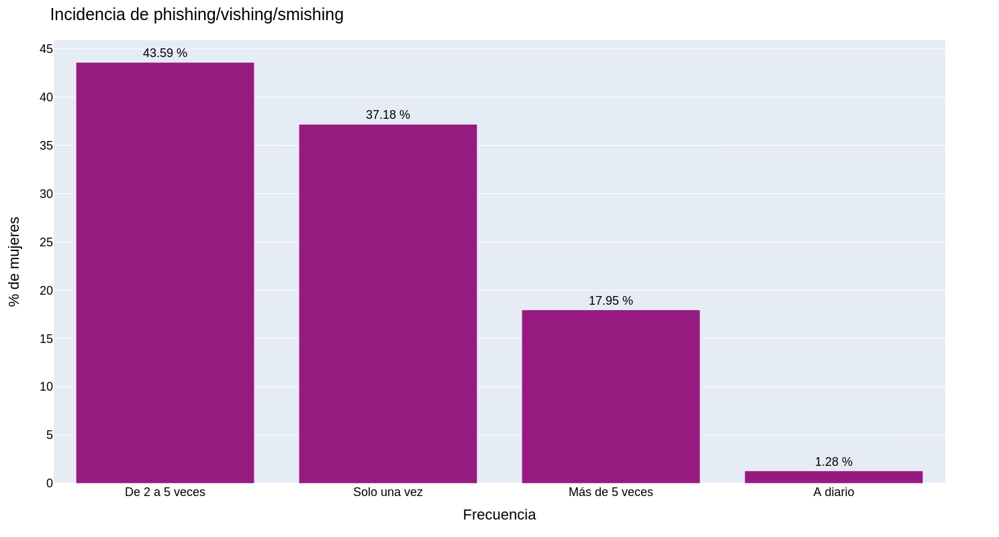

In [122]:
frecuencia_phishing_vs = fg.grafico_frecuencia(tbl_phishing_vs)

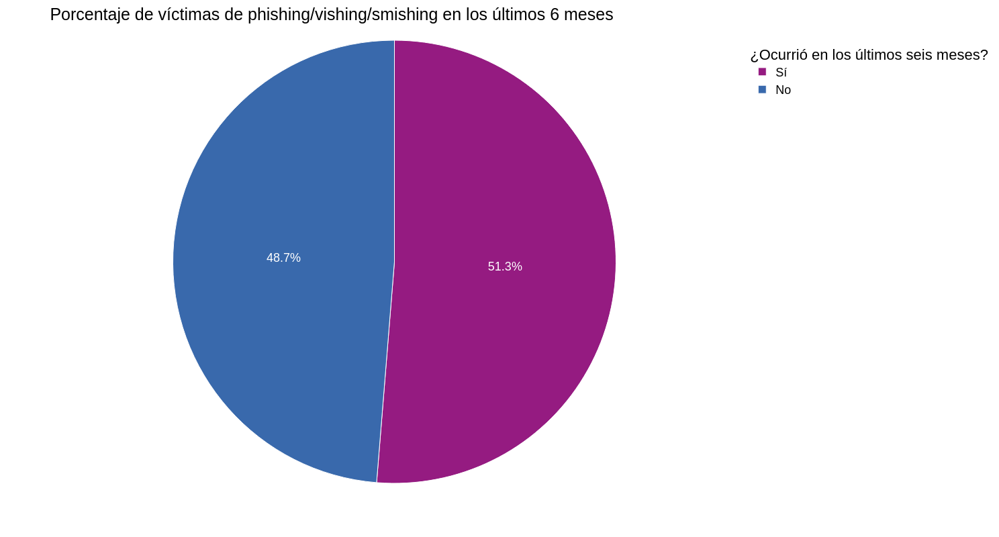

In [123]:
temporalidad_phishing_vs = fg.grafico_temporalidad(tbl_phishing_vs)

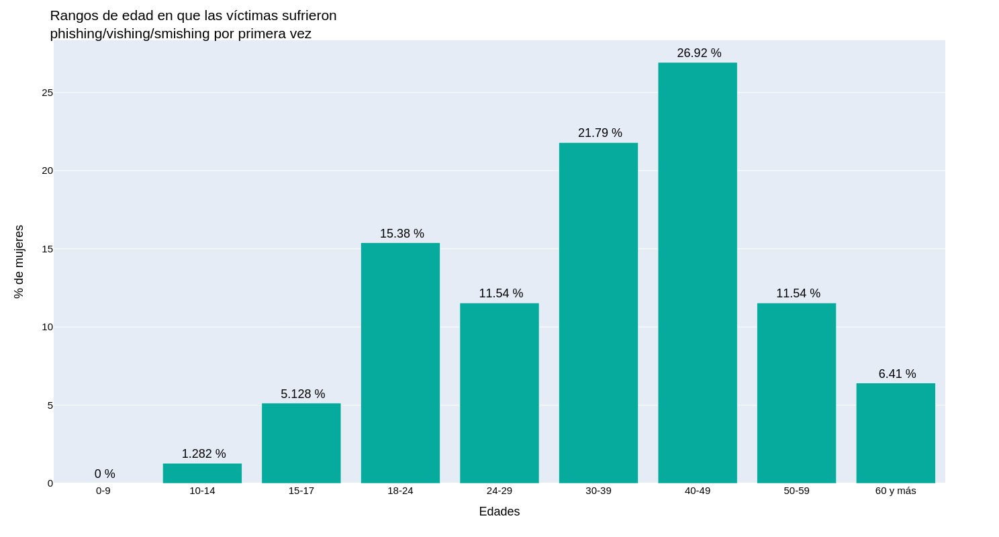

In [124]:
edad_phishing_vs = fg.grafico_edad(tbl_phishing_vs)

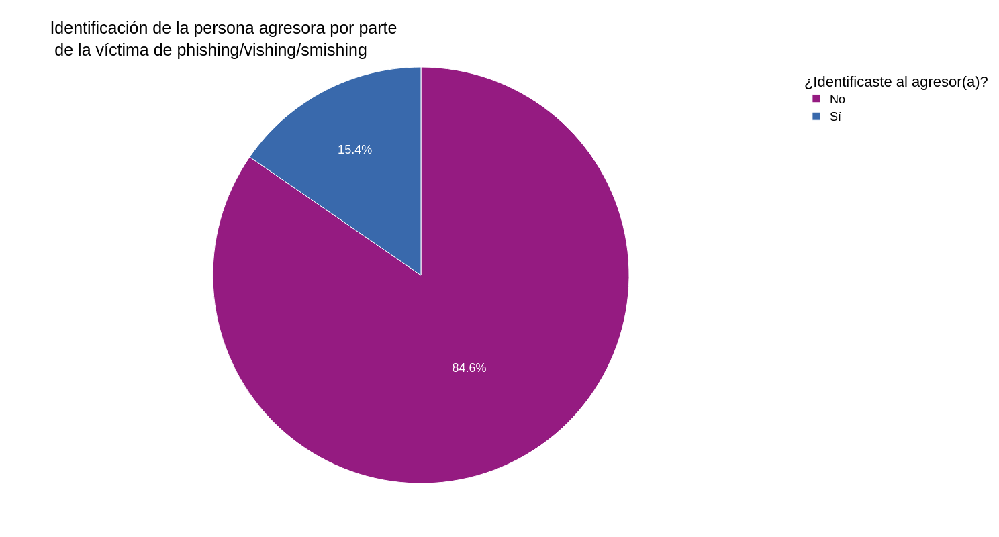

In [125]:
parentesco_phishing_vs = fg.grafico_parentesco(tbl_phishing_vs)

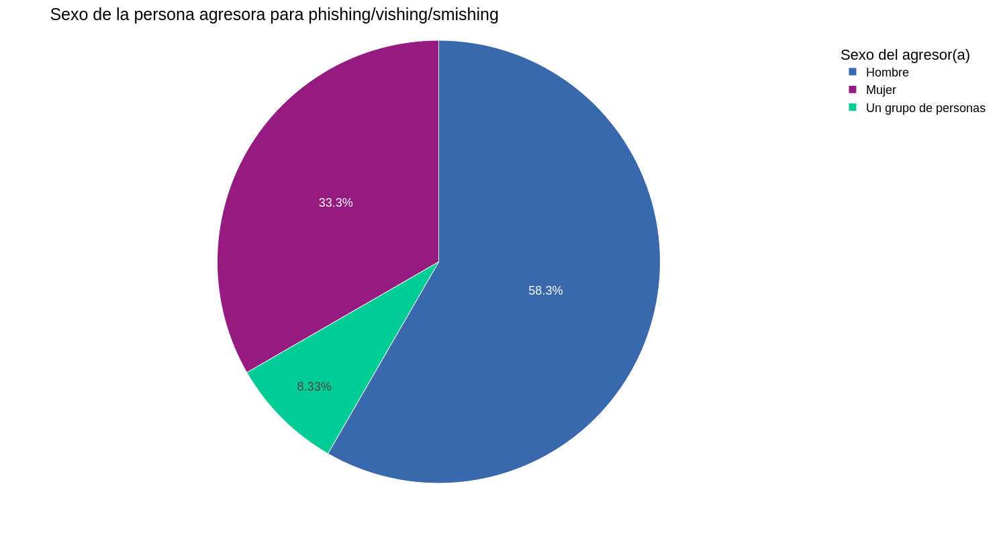

In [126]:
sexo_phishing_vs = fg.grafico_sexo_parentesco(tbl_phishing_vs)

In [127]:
pd.DataFrame(tbl_phishing_vs.otraR_phishing_vs.value_counts()).rename_axis(
    index={"otraR_phishing_vs": "Otras aplicaciones o redes sociales"}
).rename(columns={"count": "N° de mujeres"})

,N° de mujeres
Otras aplicaciones o redes sociales,
Messenger live,1
Linkedin,1


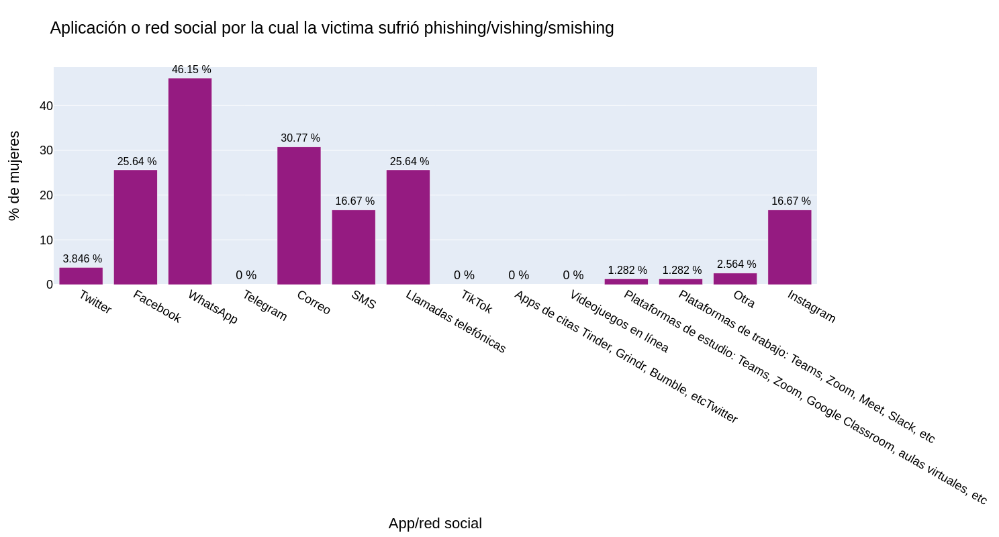

In [128]:
medios_phishing_vs = fg.grafico_medios(tbl_phishing_vs)[2]

### Análisis para los casos de trata

In [129]:
for i in datos.query("otraR_trata == 'Instagram '").index:
    datos.loc[i, "instagram_trata"] = True

In [130]:
tbl_trata = datos.query("trata == 1")[dic_violencias["trata"]]

Se han reportado 39 casos de trata.

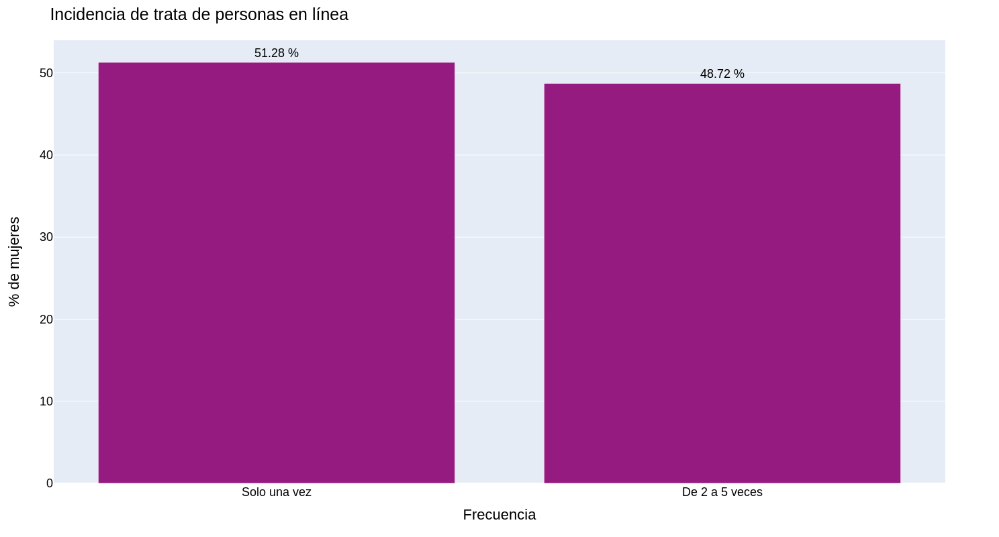

In [131]:
frecuencia_trata = fg.grafico_frecuencia(tbl_trata)

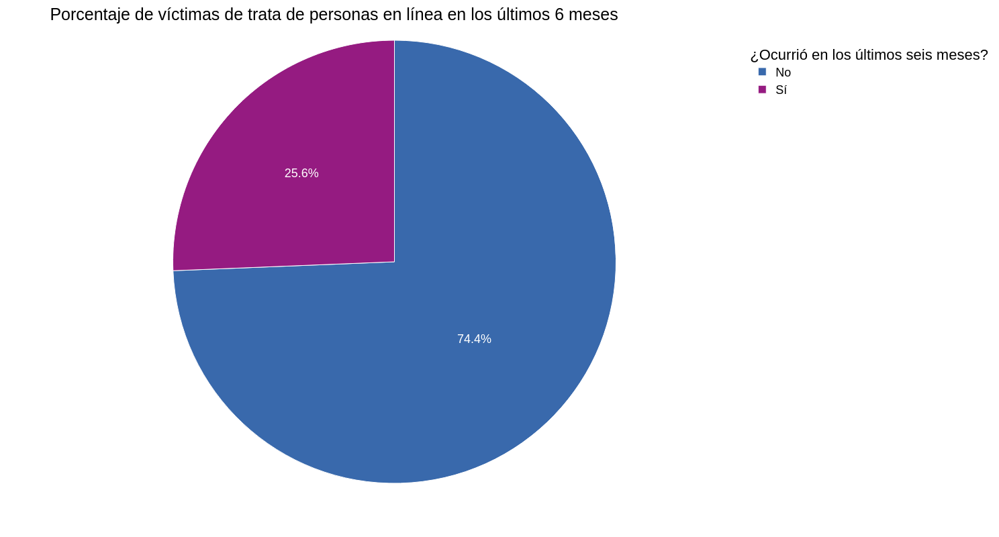

In [132]:
temporalidad_trata = fg.grafico_temporalidad(tbl_trata)

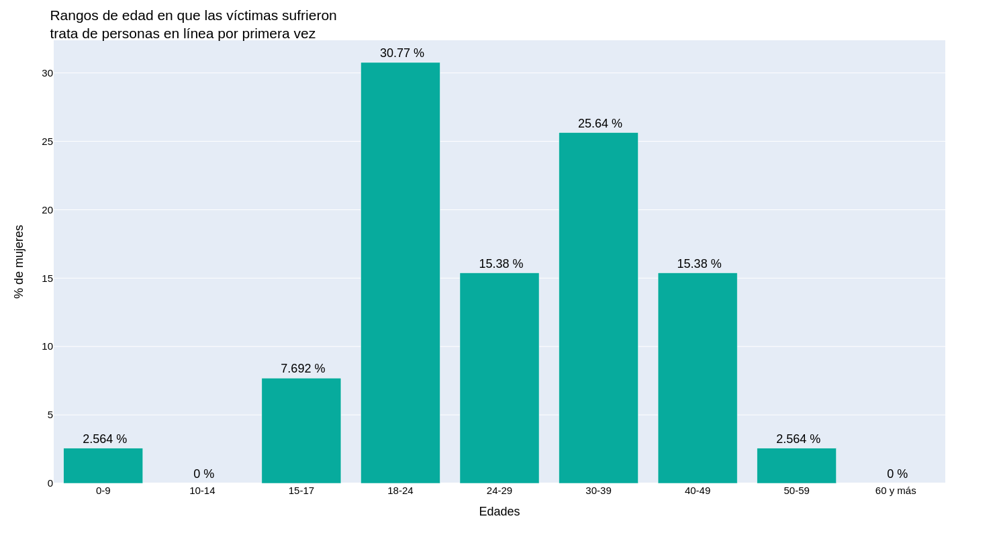

In [133]:
edad_trata = fg.grafico_edad(tbl_trata)

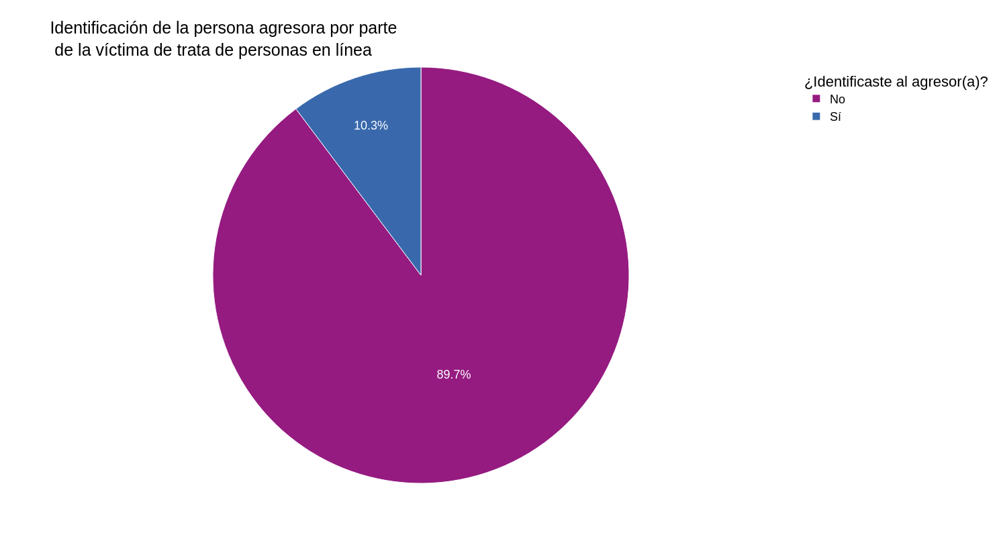

In [134]:
parentesco_trata = fg.grafico_parentesco(tbl_trata)

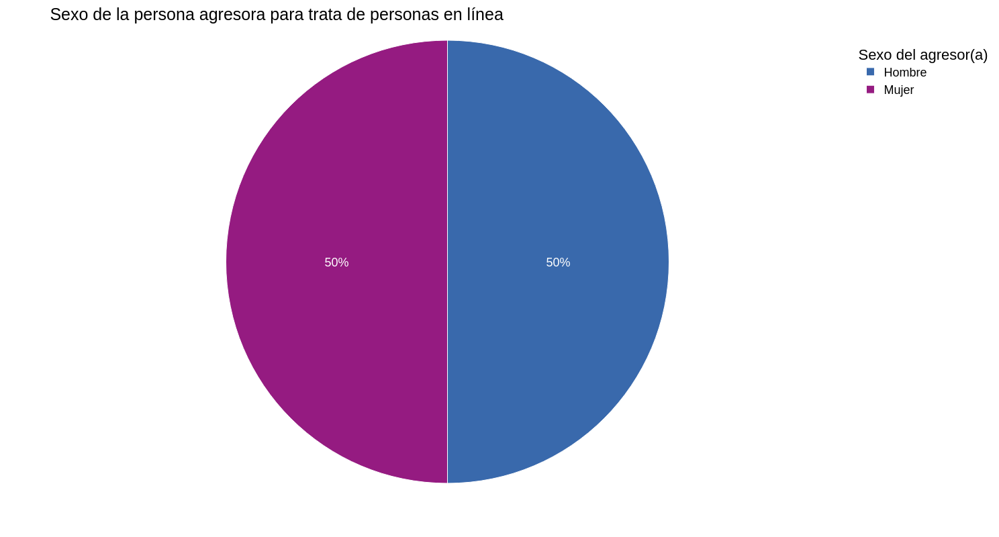

In [135]:
sexo_trata = fg.grafico_sexo_parentesco(tbl_trata)

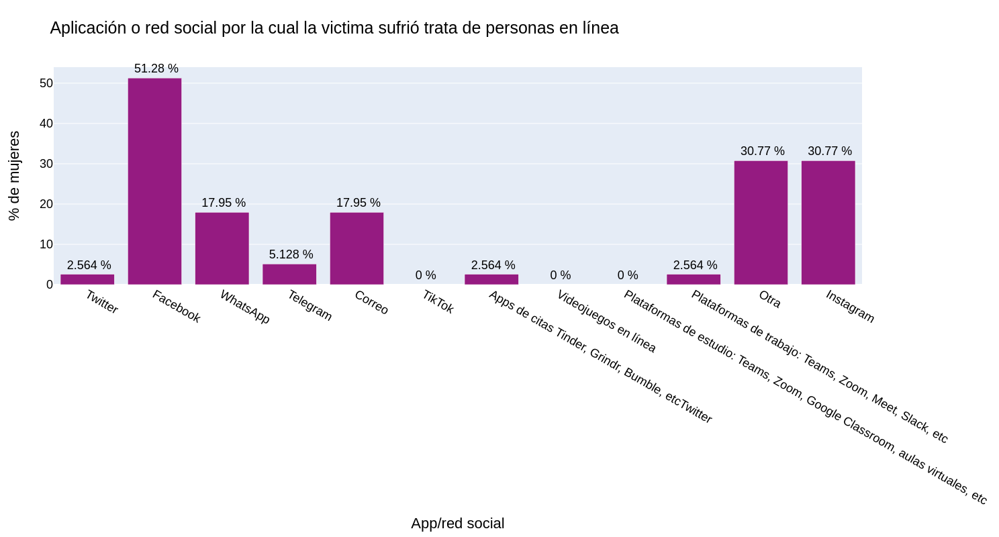

In [136]:
medios_trata = fg.grafico_medios(tbl_trata)[2]

In [137]:
pd.DataFrame(tbl_trata.otraR_trata.value_counts()).rename_axis(
    index={"otraR_trata": "Otras aplicaciones o redes sociales"}
).rename(columns={"count": "N° de mujeres"}).iloc[1:]

,N° de mujeres
Otras aplicaciones o redes sociales,
badoo,1
Gmail,1


### Análisis para los casos de captación con fines de explotación sexual

In [138]:
tbl_explotacion = datos.query("explotacion == 1")[dic_violencias["explotacion"]]

Se han reportado 7 casos de captación con fines de explotación sexual.

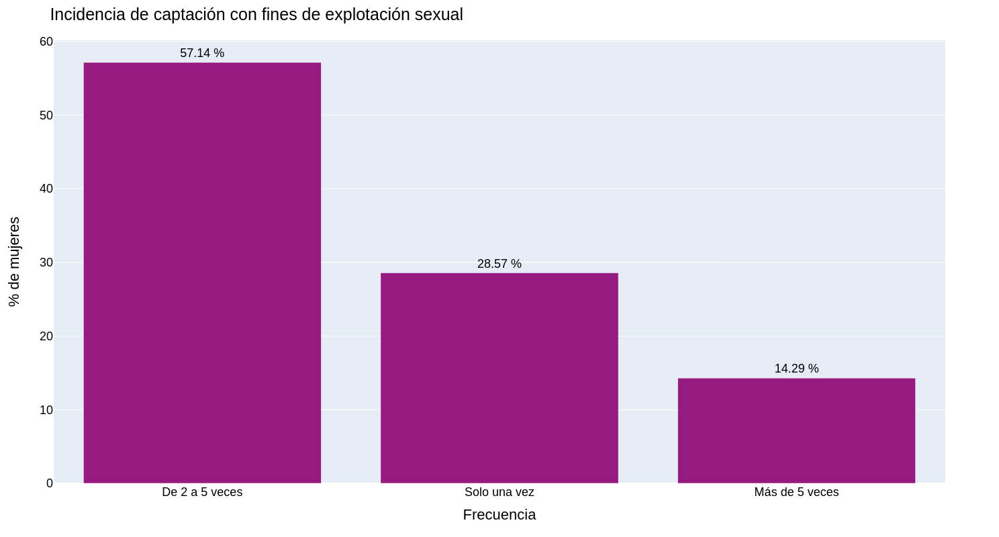

In [139]:
frecuencia_explotacion = fg.grafico_frecuencia(tbl_explotacion)

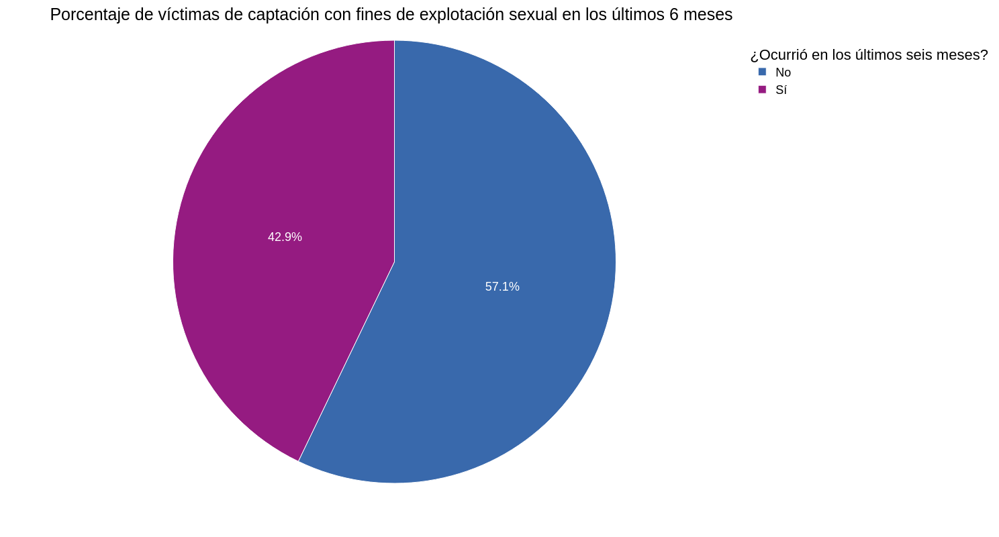

In [140]:
temporalidad_explotacion = fg.grafico_temporalidad(tbl_explotacion)

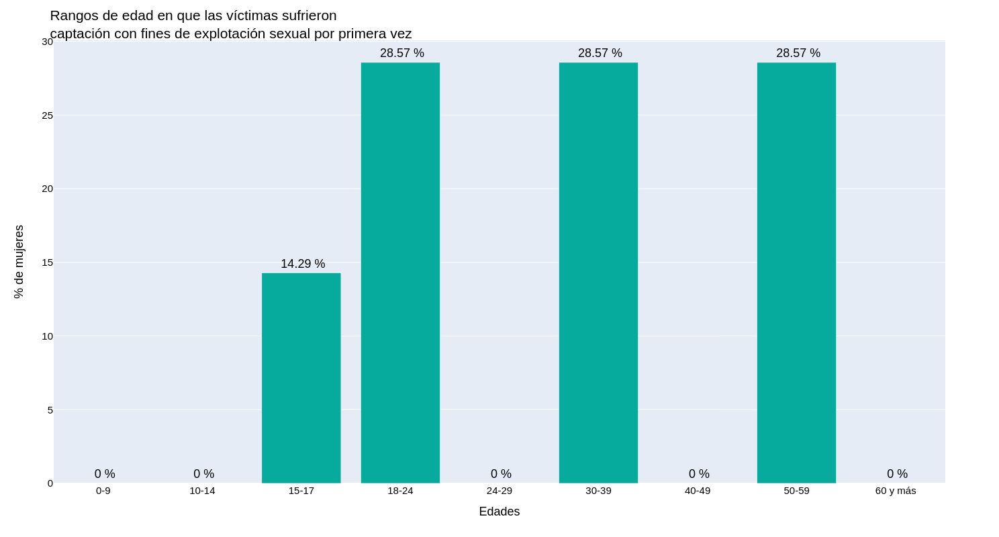

In [141]:
edad_explotacion = fg.grafico_edad(tbl_explotacion)

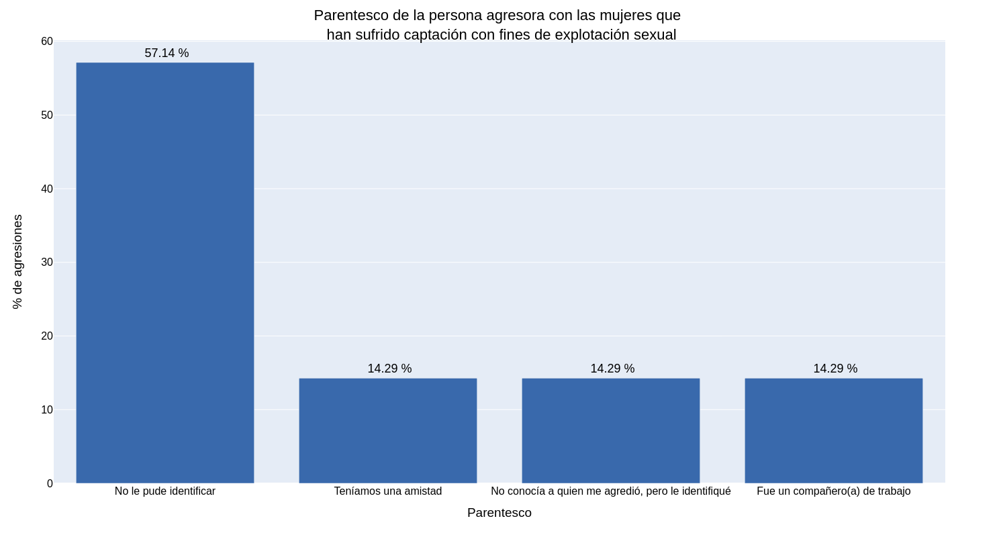

In [142]:
parentesco_explotacion = fg.grafico_parentesco(tbl_explotacion)

In [143]:
sexo_explotacion = fg.grafico_sexo_parentesco(tbl_explotacion)

Para captación con fines de explotación sexual todas las personas agresoras son de sexo Hombre


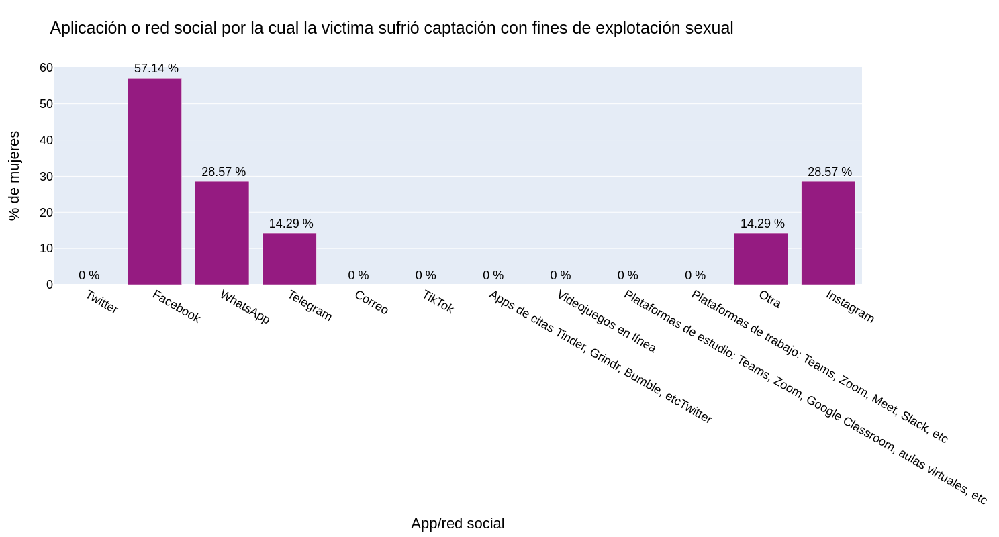

In [144]:
medios_explotacion = fg.grafico_medios(tbl_explotacion)[2]

In [145]:
pd.DataFrame(tbl_explotacion.otraR_explotacion.value_counts()).rename_axis(
    index={"otraR_explotacion": "Otras aplicaciones o redes sociales"}
).rename(columns={"count": "N° de mujeres"})

,N° de mujeres
Otras aplicaciones o redes sociales,
Texto,1


### Análisis para los casos de exclusión digital

In [146]:
tbl_exclusion = datos.query("exclusion == 1")[dic_violencias["exclusion"]]

Se han reportado 37 casos de exclusión digital.

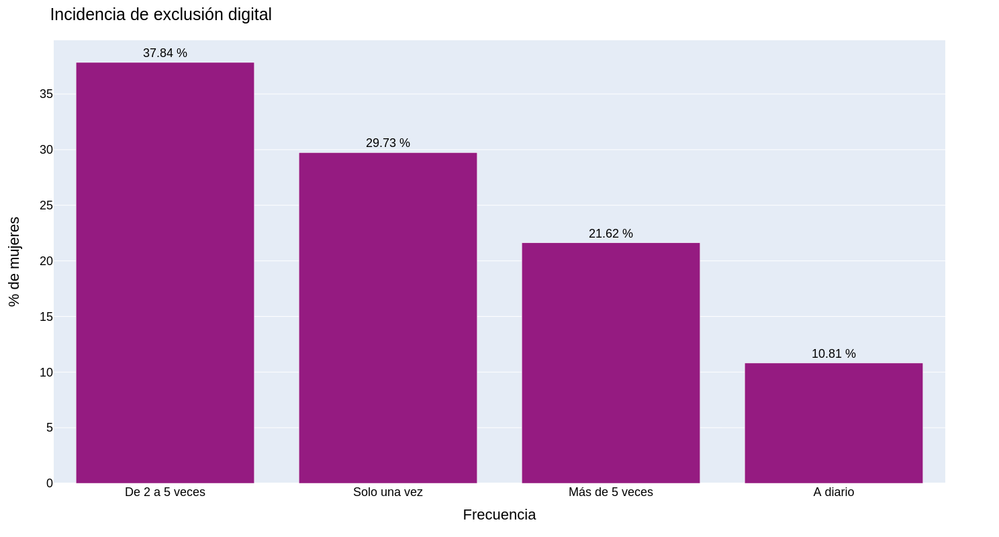

In [147]:
frecuencia_exclusion = fg.grafico_frecuencia(tbl_exclusion)

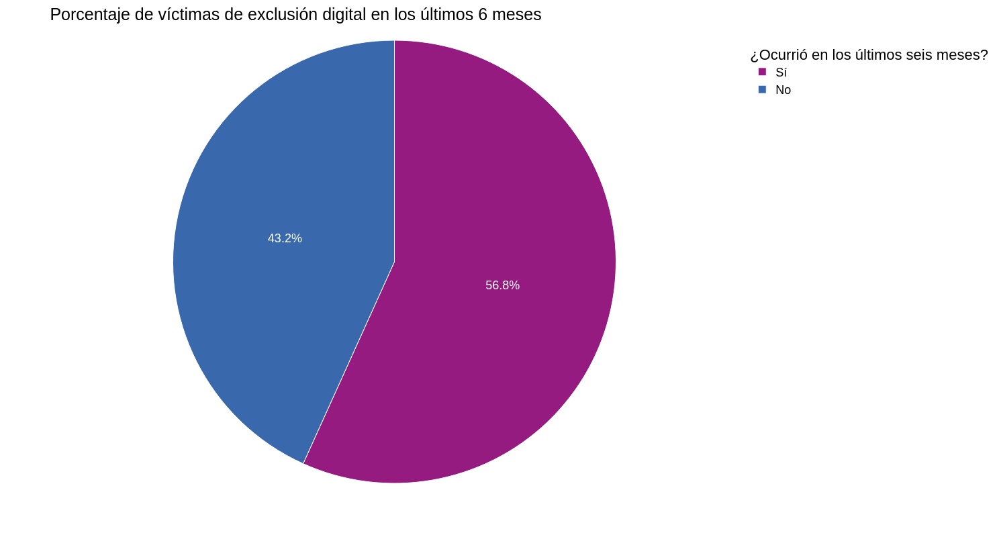

In [148]:
temporalidad_exclusion = fg.grafico_temporalidad(tbl_exclusion)

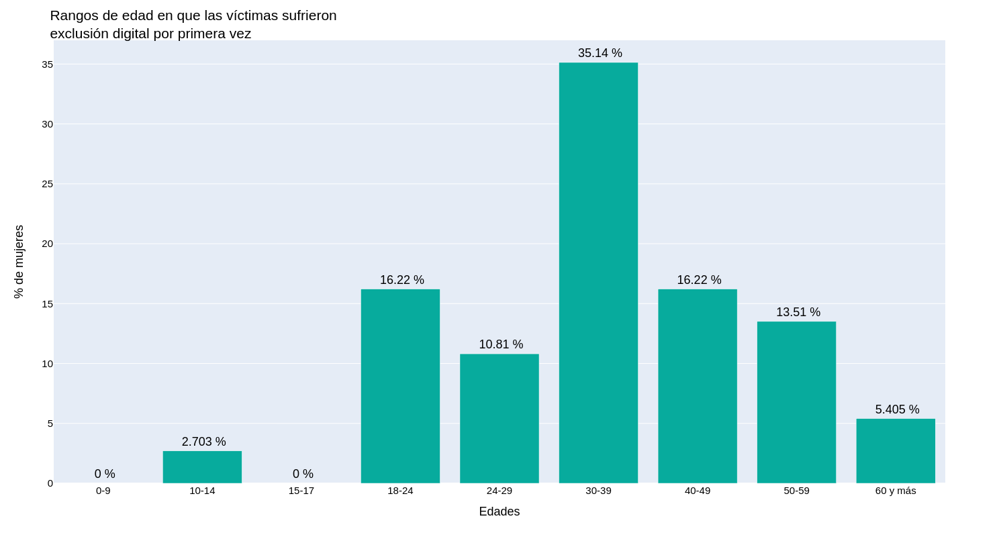

In [149]:
edad_exclusion = fg.grafico_edad(tbl_exclusion)

En el caso de exclusión no se realizó la pregunta asociada las personas agresoras.

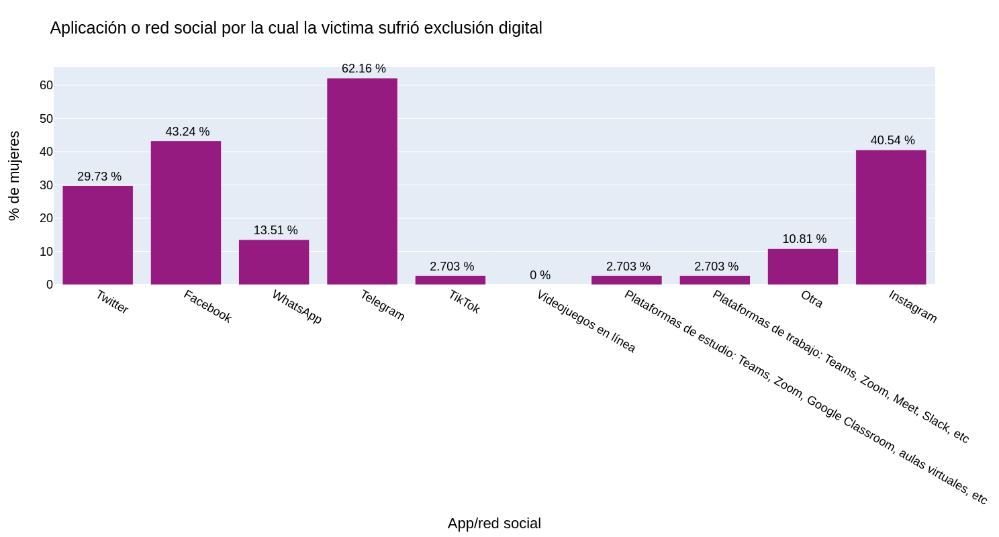

In [150]:
medios_exclusion = fg.grafico_medios(tbl_exclusion)[2]

In [151]:
pd.DataFrame(tbl_exclusion.otraR_exclusion.value_counts()).rename_axis(
    index={"otraR_exclusion": "Otras aplicaciones o redes sociales"}
).rename(columns={"count": "N° de mujeres"})

,N° de mujeres
Otras aplicaciones o redes sociales,
Ninguna,1
ninguna,1
Telefónicamente,1
Telefonía local,1


### Análisis para los casos de cyberflashing

In [152]:
tbl_cyberflashing = datos.query("cyberflashing == 1")[dic_violencias["cyberflashing"]]

Se han reportado 190 casos de cyberflashing.

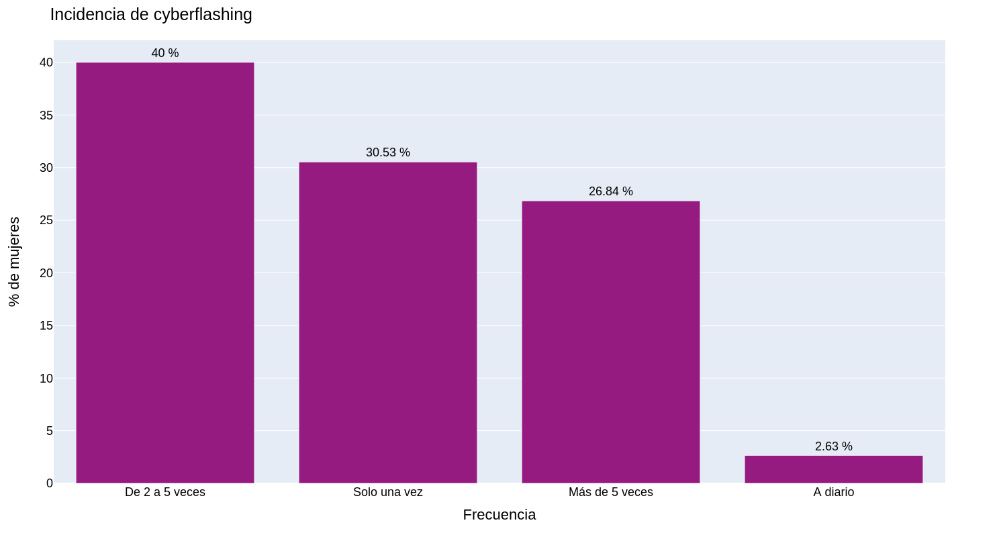

In [153]:
frecuencia_cyberflashing = fg.grafico_frecuencia(tbl_cyberflashing)

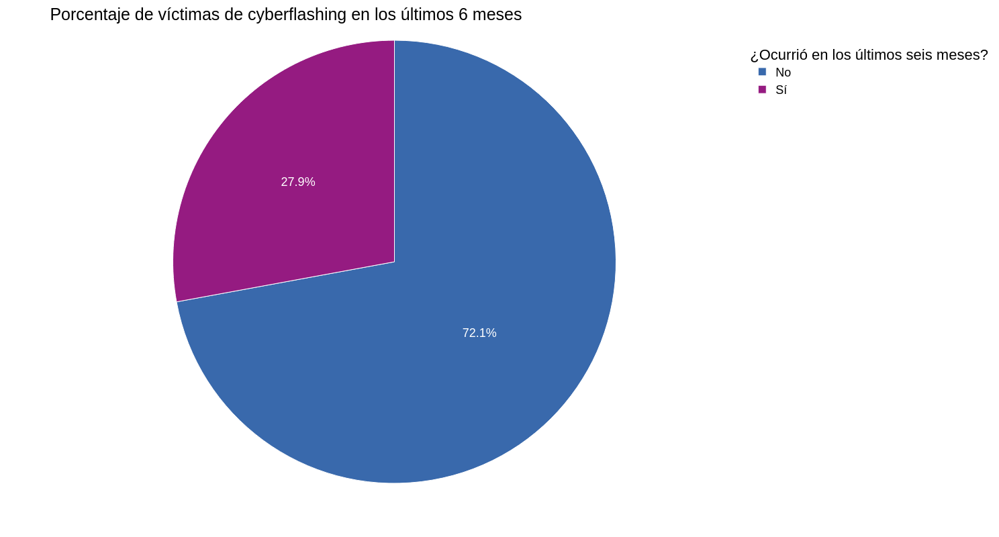

In [154]:
temporalidad_cyberflashing = fg.grafico_temporalidad(tbl_cyberflashing)

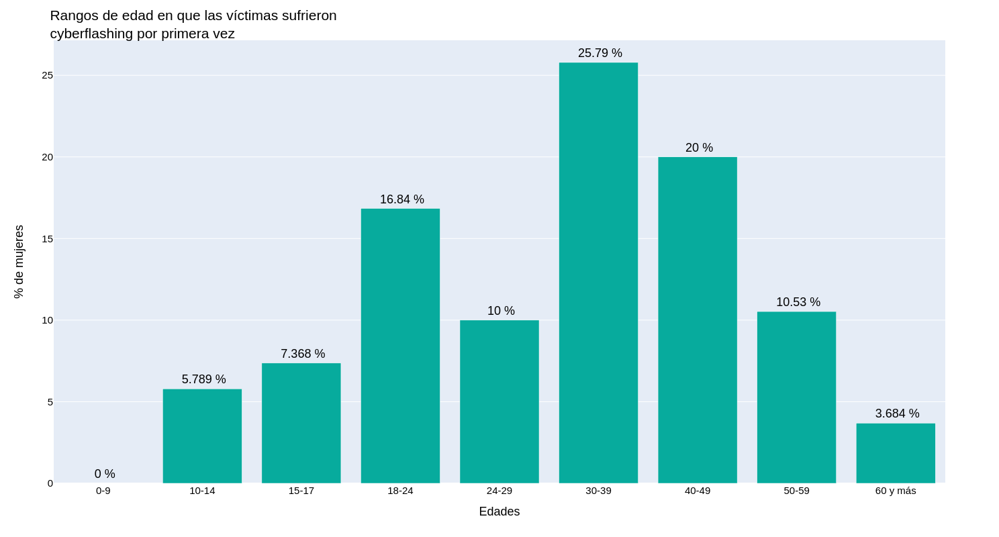

In [155]:
edad_cyberflashing = fg.grafico_edad(tbl_cyberflashing)

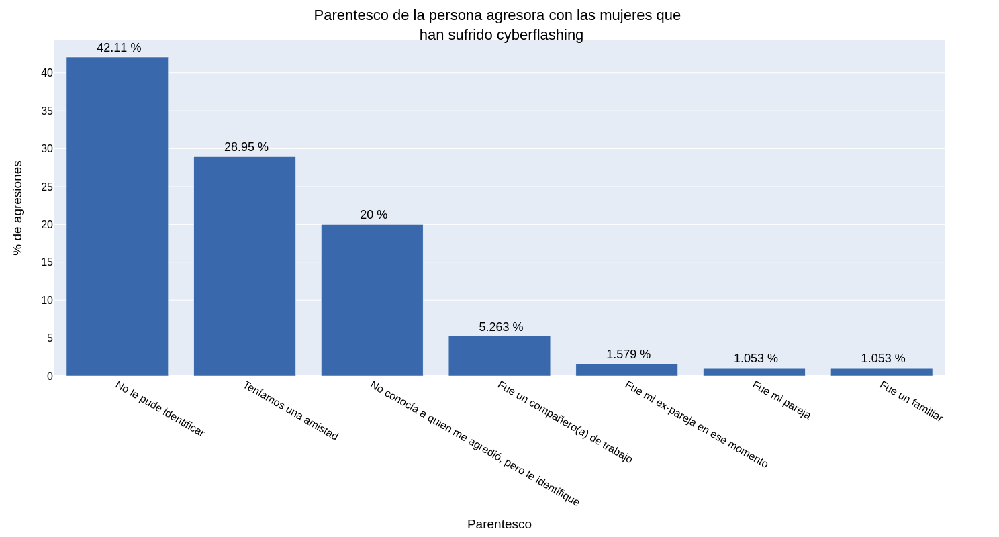

In [156]:
parentesco_cyberflashing = fg.grafico_parentesco(tbl_cyberflashing)

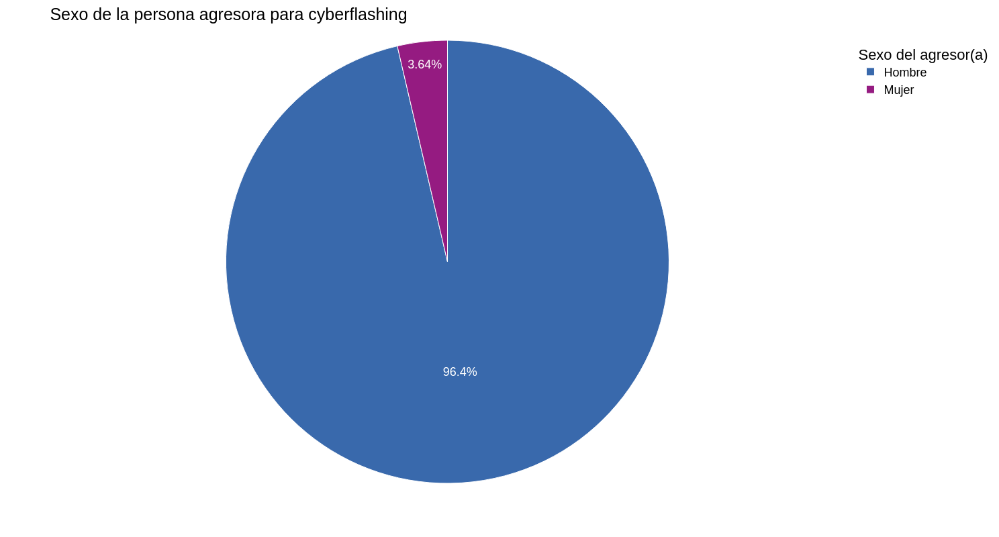

In [157]:
sexo_cyberflashing = fg.grafico_sexo_parentesco(tbl_cyberflashing)

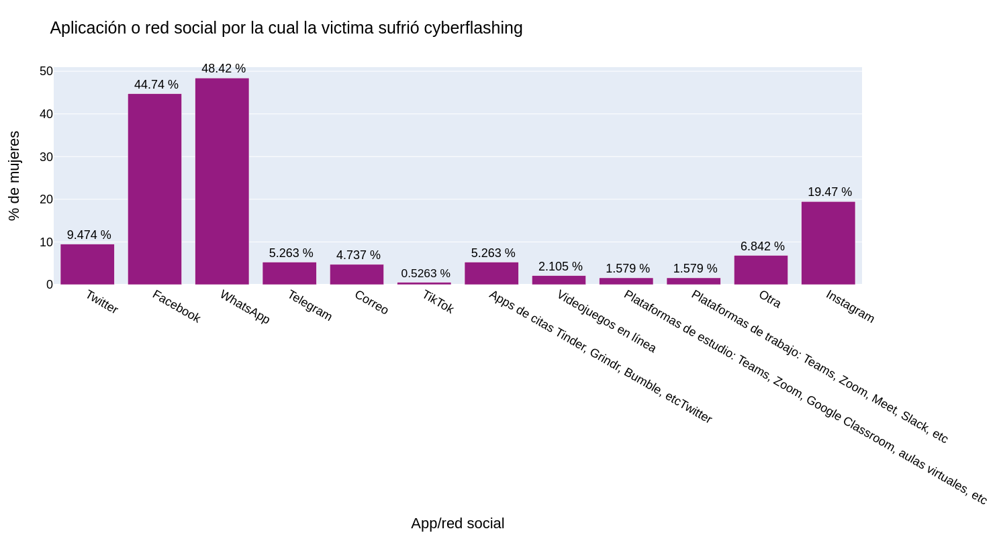

In [158]:
medios_cyberflashing = fg.grafico_medios(tbl_cyberflashing)[2]

In [159]:
pd.DataFrame(tbl_cyberflashing.otraR_cyberflashing.value_counts()).rename_axis(
    index={"otraR_cyberflashing": "Otras aplicaciones o redes sociales"}
).rename(columns={"count": "N° de mujeres"})

,N° de mujeres
Otras aplicaciones o redes sociales,
Pink,1
Canales de ver series,1
O re uerdo,1
Instagram,1
Messinger,1
"chats online, skype",1
"Skype, mensajes texto y el antiguo chat de Google ""talk"".",1
YouTube red,1
messenger de MSN,1


### Análisis para los casos de deepfake

In [160]:
tbl_deepfake = datos.query("deepfake == 1")[dic_violencias["deepfake"]]

Se han reportado 10 casos de deepfake.

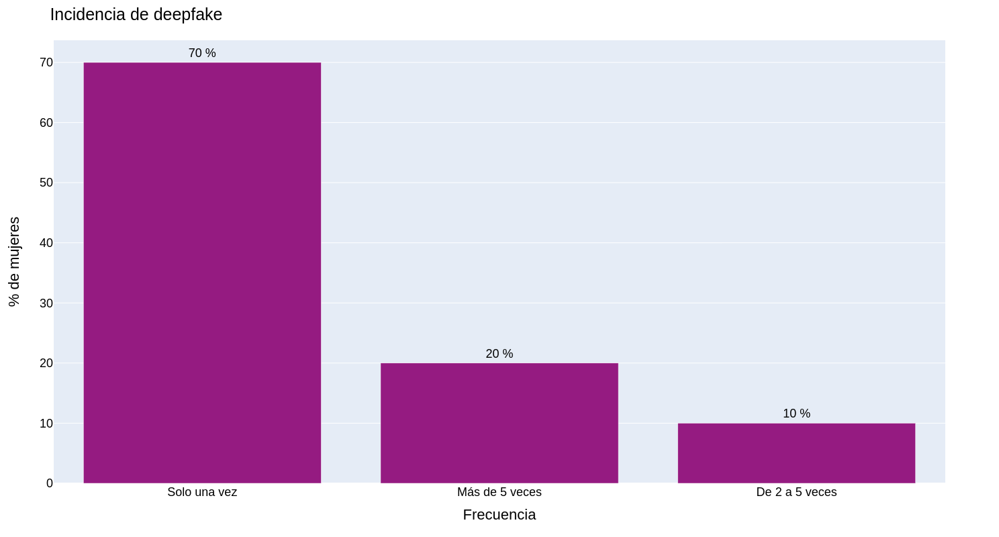

In [161]:
frecuencia_deepfake = fg.grafico_frecuencia(tbl_deepfake)

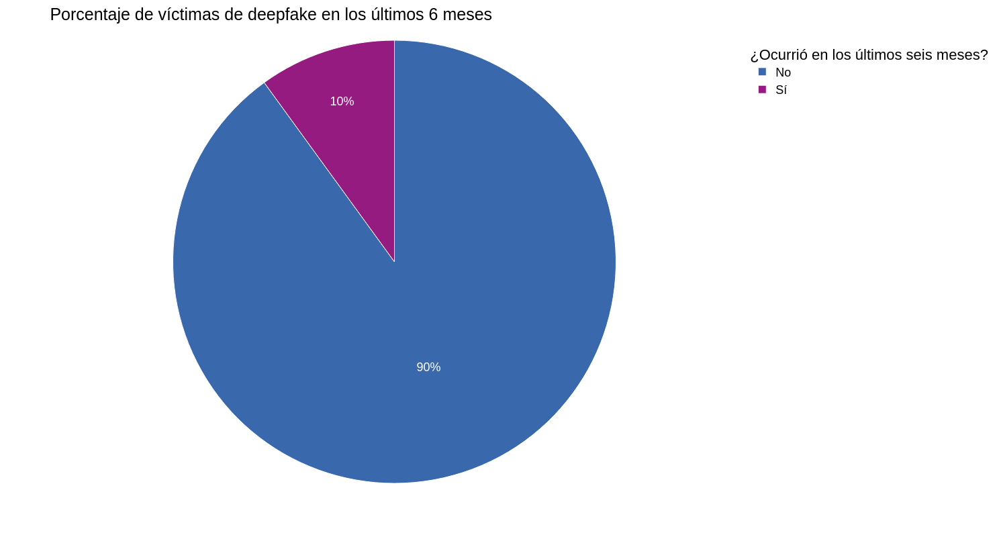

In [162]:
temporalidad_deepfake = fg.grafico_temporalidad(tbl_deepfake)

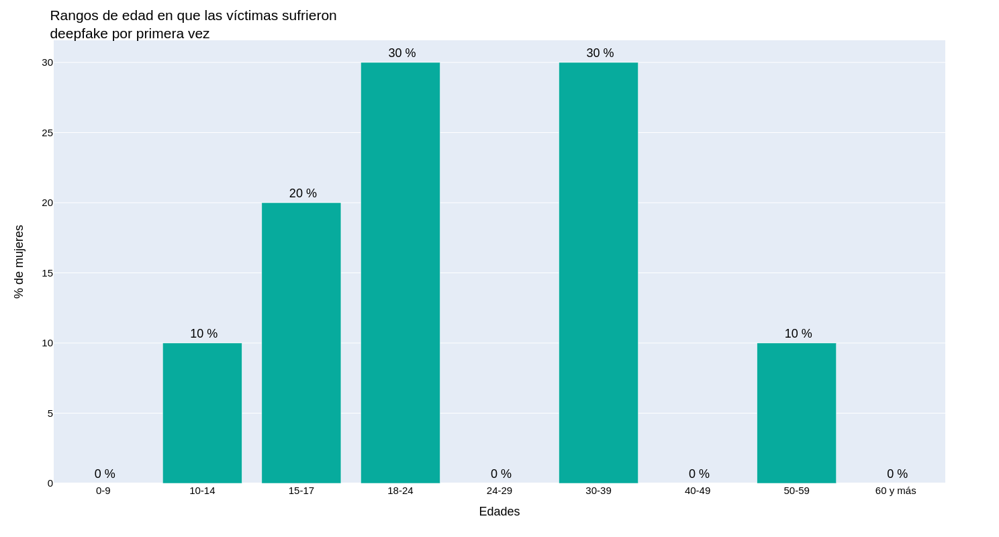

In [163]:
edad_deepfake = fg.grafico_edad(tbl_deepfake)

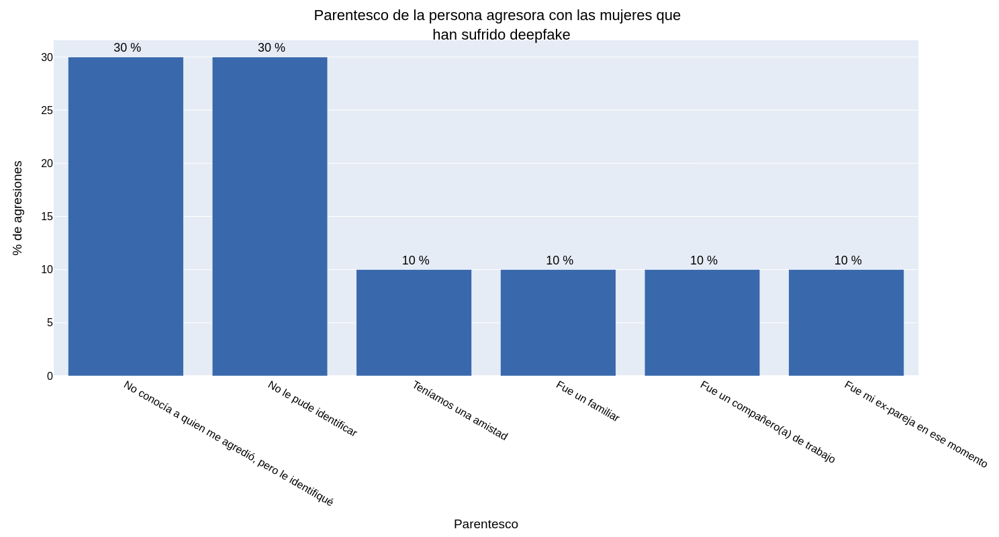

In [164]:
parentesco_deepfake = fg.grafico_parentesco(tbl_deepfake)

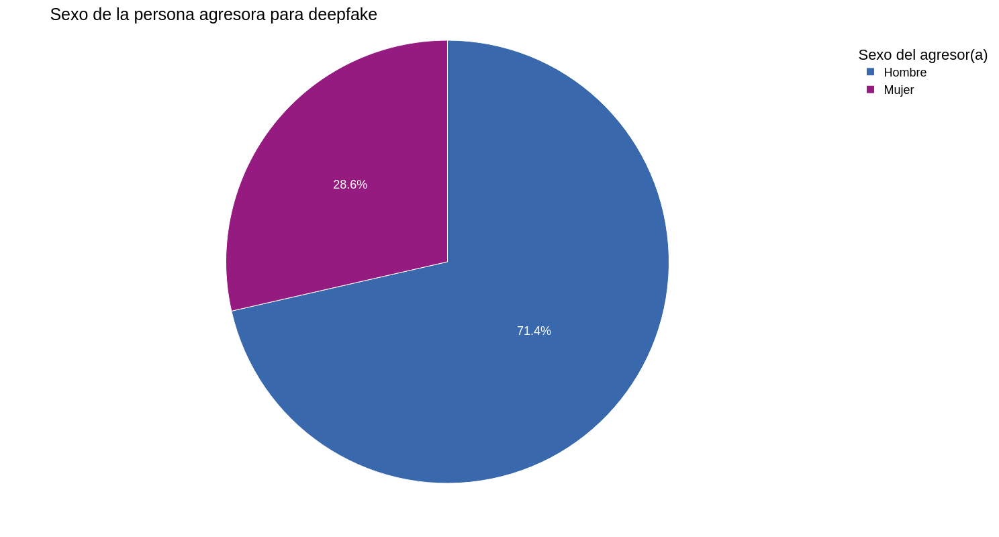

In [165]:
sexo_deepfake = fg.grafico_sexo_parentesco(tbl_deepfake)

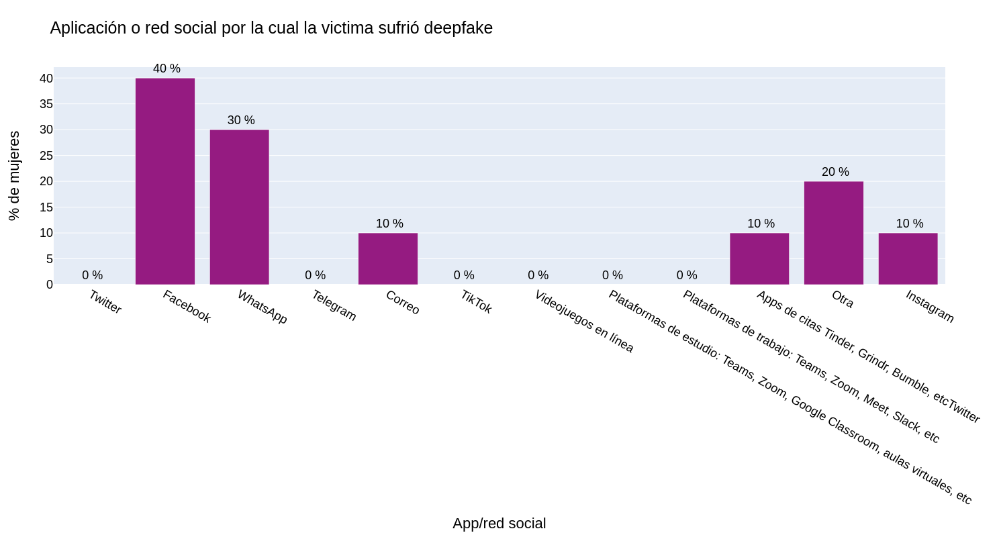

In [166]:
medios_deepfake = fg.grafico_medios(tbl_deepfake)[2]

In [167]:
pd.DataFrame(tbl_deepfake.otraR_deepfake.value_counts()).rename_axis(
    index={"otraR_deepfake": "Otras aplicaciones o redes sociales"}
).rename(columns={"count": "N° de mujeres"})

,N° de mujeres
Otras aplicaciones o redes sociales,
Messenger,1
BB pin,1


### Análisis para los casos de clonación

In [168]:
tbl_clonacion = datos.query("clonacion == 1")[dic_violencias["clonacion"]]

Se han reportado 50 casos de clonación.

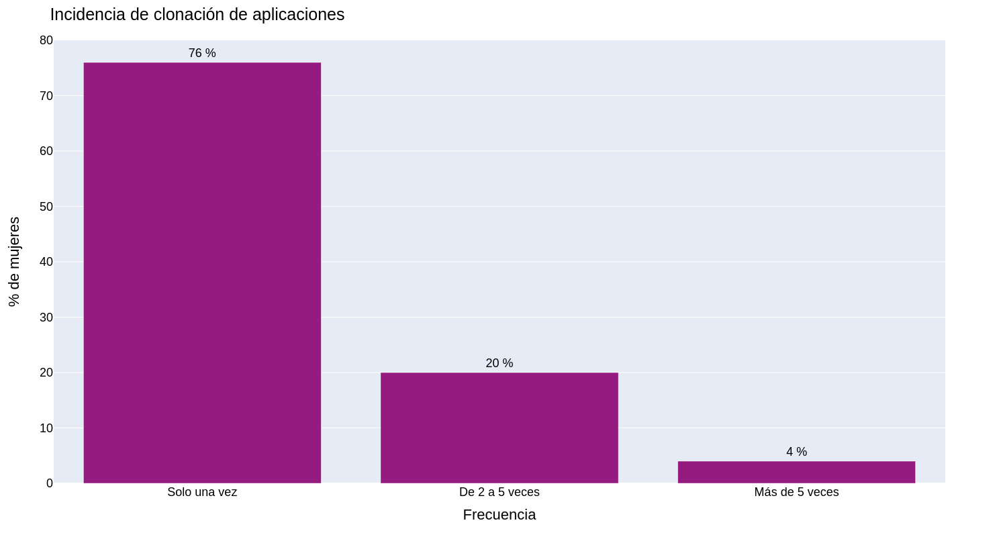

In [169]:
frecuencia_clonacion = fg.grafico_frecuencia(tbl_clonacion)

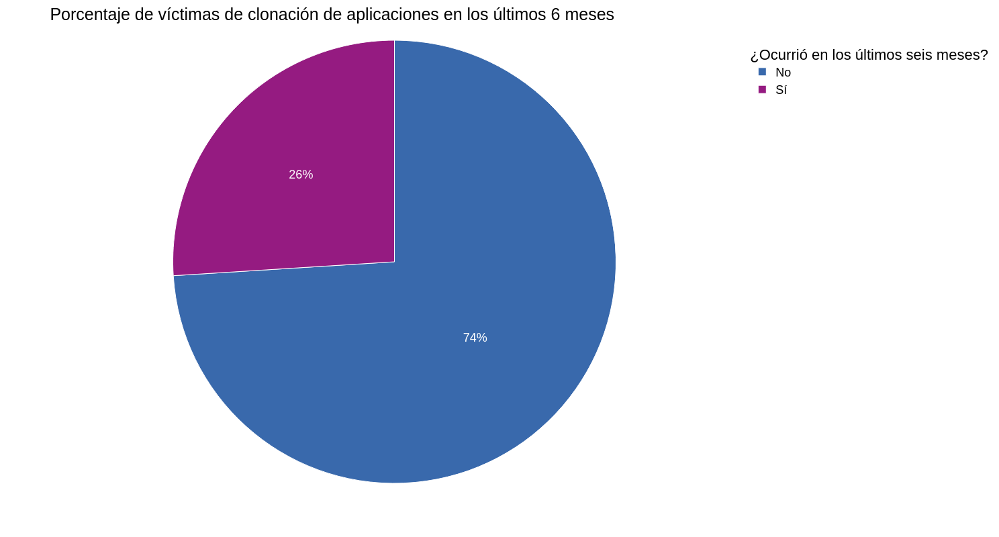

In [170]:
temporalidad_clonacion = fg.grafico_temporalidad(tbl_clonacion)

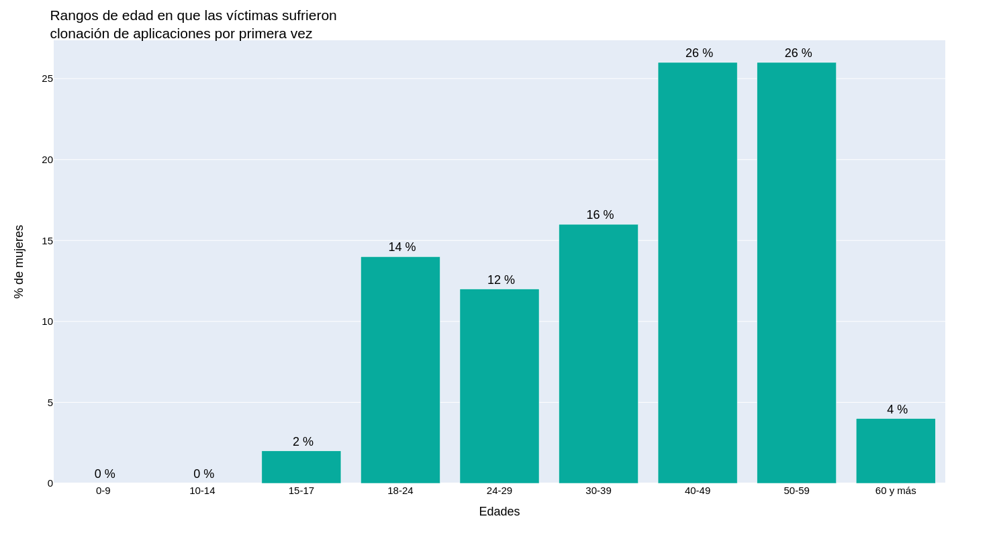

In [171]:
edad_clonacion = fg.grafico_edad(tbl_clonacion)

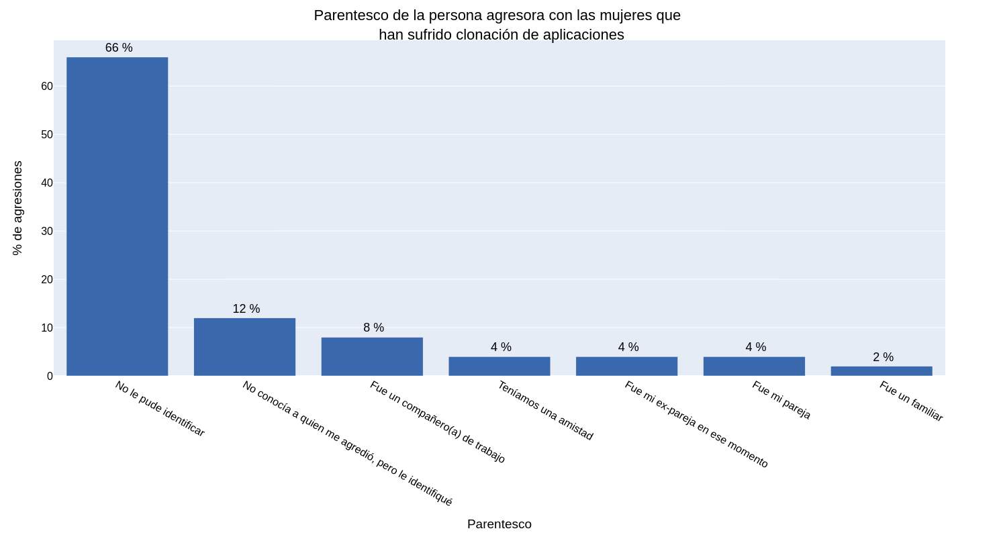

In [172]:
parentesco_clonacion = fg.grafico_parentesco(tbl_clonacion)

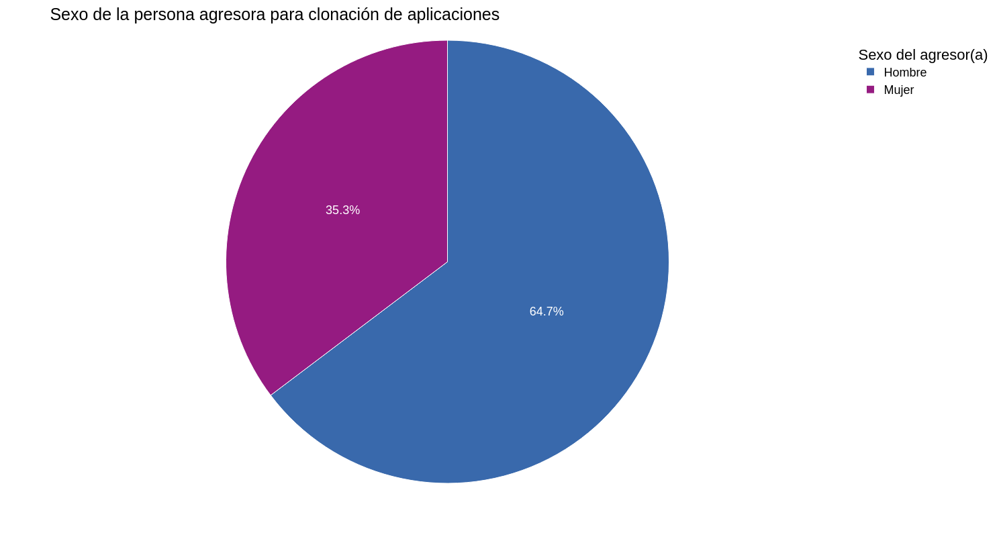

In [173]:
sexo_clonacion = fg.grafico_sexo_parentesco(tbl_clonacion)

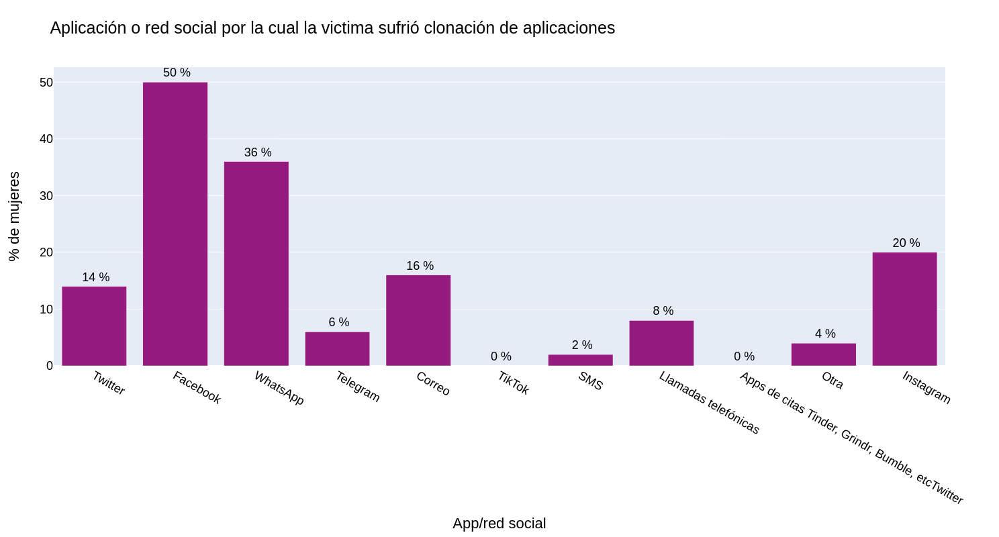

In [174]:
medios_clonacion = fg.grafico_medios(tbl_clonacion)[2]

In [175]:
pd.DataFrame(tbl_clonacion.otraR_clonacion.value_counts()).rename_axis(
    index={"otraR_clonacion": "Otras aplicaciones o redes sociales"}
).rename(columns={"count": "N° de mujeres"})

,N° de mujeres
Otras aplicaciones o redes sociales,
Falsificaron mi firma,1
Messenger,1


## Conocimiento sobre violencia digital basada en género

In [176]:
tbl_vdbg = datos.vdbg.value_counts()

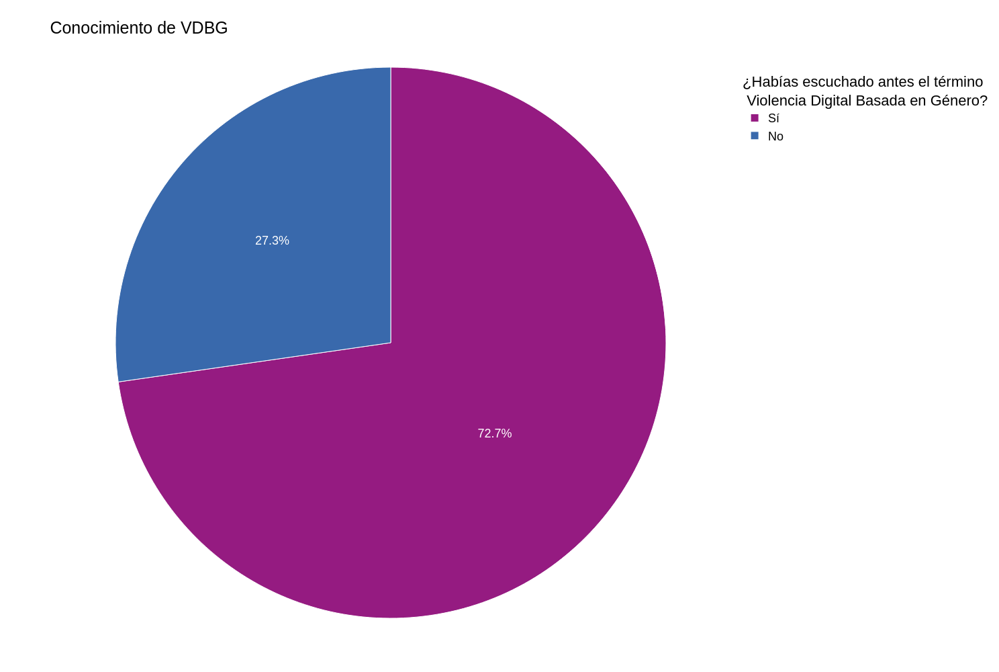

In [177]:
fig = go.Figure(data=[go.Pie(labels=tbl_vdbg.index, values=tbl_vdbg)])
fig.update_layout(
    title_text="Conocimiento de VDBG",
    legend_title="¿Habías escuchado antes el término <br> Violencia Digital Basada en Género?",
    font=dict(family="Arial", size=18, color="black"),
    width=1500,
    height=1000,
)
fig.update_traces(
    marker=dict(
        colors=["rgb(149, 27, 129)", "rgb(57, 105, 172)", "rgb(7, 171, 157)"],
        line=dict(color="white", width=1),
    )
)
fig.show()
fig.write_image("img/vdbg.png")

In [178]:
vdbg_violencias = [s for s in list(datos.columns) if "vdbg_" in s]

In [179]:
con_violencia = pd.DataFrame(
    datos.query("vdbg == 'Sí'")[vdbg_violencias[1:]].T.sum().value_counts()
)
con_violencia.index.name = "Nº de violencias conocidas"
con_violencia["%"] = round(con_violencia / len(datos) * 100, 2)
con_violencia.rename(columns={"count": "Cantidad de mujeres"}).sort_index()

,Cantidad de mujeres,%
Nº de violencias conocidas,,
1,17,4.68
2,19,5.23
3,27,7.44
4,29,7.99
5,22,6.06
6,24,6.61
7,32,8.82
8,26,7.16
9,21,5.79


In [180]:
tbl_conocimiento_violencia = pd.DataFrame(datos[vdbg_violencias[1:]].sum())

In [181]:
tbl_conocimiento_violencia.index = violencias
tbl_conocimiento_violencia.rename(
    index=violencias_nombres, columns={0: "cantidad"}, inplace=True
)
tbl_conocimiento_violencia = round(tbl_conocimiento_violencia / len(datos) * 100, 2)

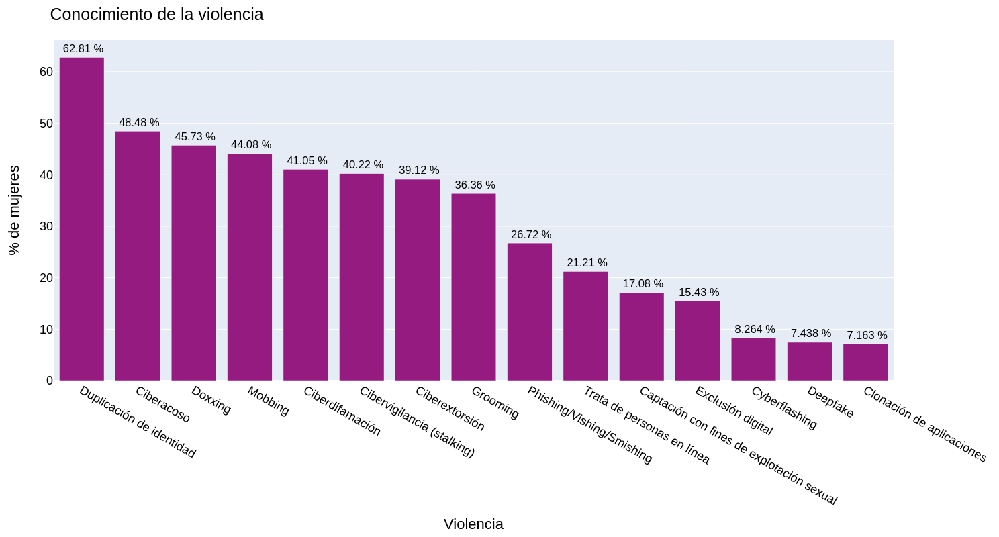

In [182]:
fig = px.bar(
    tbl_conocimiento_violencia.sort_values("cantidad", ascending=False),
    y="cantidad",
    x=tbl_conocimiento_violencia.index,
    text_auto=True,
)
fig.update_layout(
    title="Conocimiento de la violencia",
    xaxis_title="Violencia",
    yaxis_title="% de mujeres",
    font=dict(
        family="Arial",
        size=18,
        color="black",
    ),
    width=1500,
    height=800,
)
fig.update_traces(
    textfont_size=18,
    textangle=0,
    textposition="outside",
    cliponaxis=False,
    showlegend=False,
    marker_color="rgb(149, 27, 129)",
    marker_line_color="white",
    texttemplate="%{value: .4} %",
)
fig.show()
fig.write_image("img/conocimiento_violencia.png")

## Reacciones de las víctima al sufrir la(s) violencia(s)

In [183]:
reacciones = [s for s in list(datos.columns) if "reaccion_" in s]

In [184]:
tbl_reacciones = round(pd.DataFrame(datos[reacciones].sum() / len(datos) * 100), 2)

In [185]:
tbl_reacciones.rename(
    index={
        "reaccion_ignorar": "Ignoraron al agresor",
        "reaccion_contar": "Le contaron a un amigo(a) o familiar",
        "reaccion_ayuda": "Acudieron a un centro de ayuda o denuncia",
        "reaccion_reportar": "Reportaron el perfil o publicación en la red social",
        "reaccion_internet": "Redujeron el uso en internet",
        "reaccion_borrar": "Borraron la aplicación donde ocurrió",
        "reaccion_eliminar": "Eliminaron la cuenta de usuario",
        "reaccion_crear": "Crearon una cuenta de usuario distinta",
        "reaccion_bloquear": "Bloquearon a la persona agresora",
        "reaccion_enfrentar": "Enfrentaron a la persona agresora",
    },
    columns={0: "cantidad"},
    inplace=True,
)

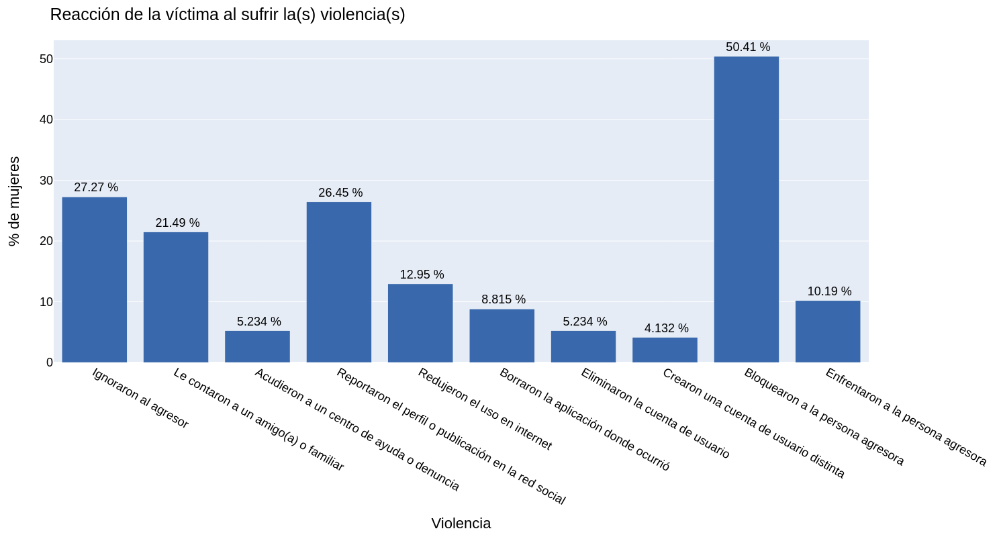

In [186]:
fig = px.bar(
    tbl_reacciones.sort_values("cantidad", ascending=False),
    y=tbl_reacciones["cantidad"],
    x=tbl_reacciones.index,
    text_auto=True,
)
fig.update_layout(
    title="Reacción de la víctima al sufrir la(s) violencia(s)",
    xaxis_title="Violencia",
    yaxis_title="% de mujeres",
    font=dict(
        family="Arial",
        size=18,
        color="black",
    ),
    width=1500,
    height=800,
)
fig.update_traces(
    textfont_size=18,
    textangle=0,
    textposition="outside",
    cliponaxis=False,
    showlegend=False,
    marker_color="rgb(57, 105, 172)",
    marker_line_color="white",
    texttemplate="%{value: .4} %",
)
fig.show()
fig.write_image("img/reaccion_violencia.png")

## Conocimiento de víctimas

In [187]:
tbl_victima = datos.victima.value_counts()

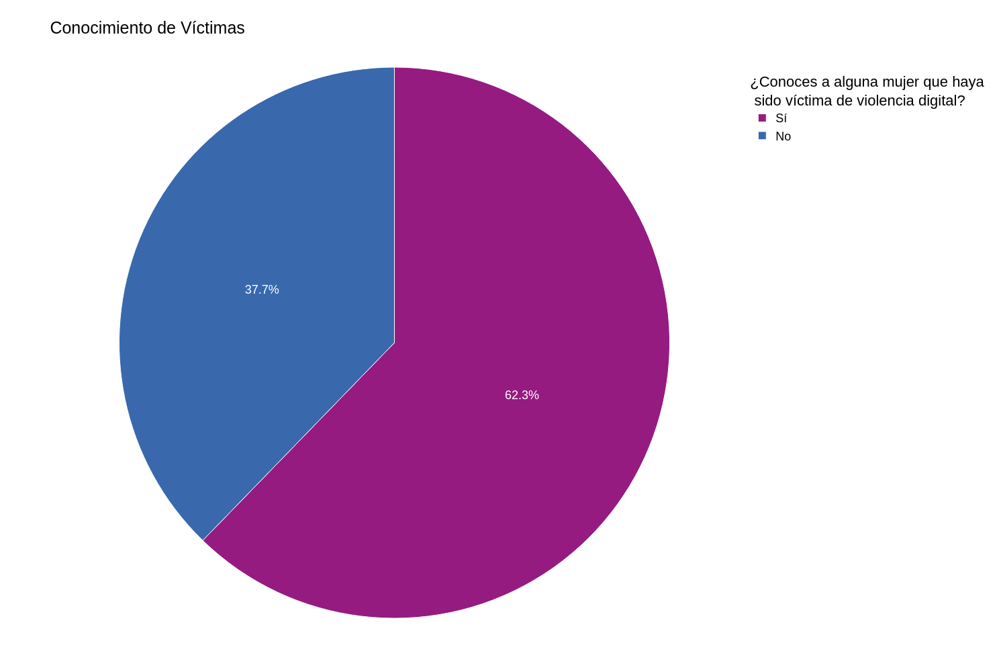

In [188]:
fig = go.Figure(data=[go.Pie(labels=tbl_victima.index, values=tbl_victima)])
fig.update_layout(
    title_text="Conocimiento de Víctimas",
    font=dict(family="Arial", size=18, color="black"),
    legend_title="¿Conoces a alguna mujer que haya <br> sido víctima de violencia digital?",
    width=1500,
    height=1000,
    legend=dict(font=dict(size=18)),
)
fig.update_traces(
    marker=dict(
        colors=["rgb(149, 27, 129)", "rgb(57, 105, 172)"],
        line=dict(color="white", width=1),
    )
)
fig.show()
fig.write_image("img/victima.png")

In [189]:
num_victimas = pd.DataFrame(datos.numero_victima.value_counts())

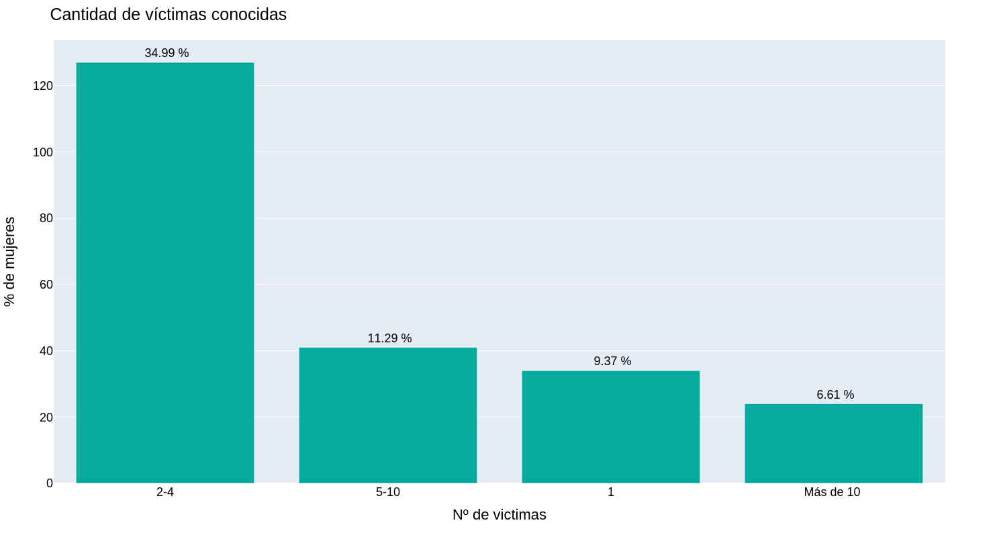

In [190]:
fig = px.bar(
    num_victimas,
    y=num_victimas["count"],
    x=num_victimas.index.values,
    text=round(num_victimas / len(datos) * 100, 2)["count"],
)
fig.update_layout(
    title="Cantidad de víctimas conocidas",
    xaxis_title="Nº de victimas",
    yaxis_title="% de mujeres",
    font=dict(
        family="Arial",
        size=18,
        color="black",
    ),
    width=1500,
    height=800,
)
fig.update_traces(
    textfont_size=18,
    textangle=0,
    textposition="outside",
    cliponaxis=False,
    showlegend=False,
    marker_color="rgb(7, 171, 157)",
    marker_line_color="white",
    texttemplate="%{text: .4} %",
)
fig.show()
fig.write_image("img/num_victimas.png")

## Conocimiento de leyes y normas

In [191]:
tbl_leyes = datos.leyes_normas.value_counts()

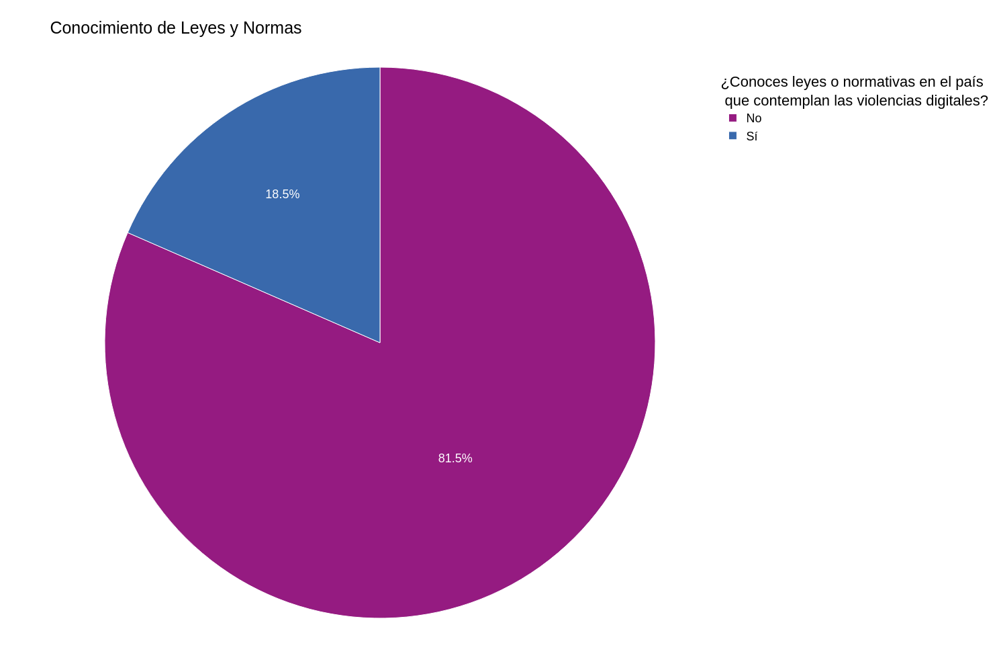

In [192]:
fig = go.Figure(data=[go.Pie(labels=tbl_leyes.index, values=tbl_leyes)])
fig.update_layout(
    title_text="Conocimiento de Leyes y Normas",
    legend_title="¿Conoces leyes o normativas en el país <br> que contemplan las violencias digitales?",
    width=1500,
    height=1000,
    font=dict(family="Arial", size=18, color="black"),
)
fig.update_traces(
    marker=dict(
        colors=["rgb(149, 27, 129)", "rgb(57, 105, 172)"],
        line=dict(color="white", width=1),
    )
)
fig.show()
fig.write_image("img/ley.png")

## Interacciones entre ciertos ítems de la encuesta

### Tipos de violencia y edad en que ocurrió por primera vez

In [193]:
edades_violencias = [s for s in list(datos.columns) if "edad_" in s]

In [194]:
lista_edades_violencias = []
for i in edades_violencias:
    j = (
        pd.cut(
            datos[edades_violencias].loc[:, i],
            bins=[0, 10, 15, 18, 25, 30, 40, 50, 60, 75],
            right=False,
        )
        .value_counts()
        .sort_index()
    )
    j = j.reset_index()
    for k in violencias_nombres.keys():
        if k in j.columns[0]:
            j["violencia"] = [violencias_nombres[k]] * len(j)
    j = j.rename(columns={j.columns[0]: "Edad"})
    lista_edades_violencias.append(j)

In [195]:
tbl_edades_primera_vez = pd.concat(lista_edades_violencias, join="inner").reset_index(
    drop=True
)

In [196]:
tbl_edades_primera_vez.Edad = tbl_edades_primera_vez.Edad.astype("str")

In [197]:
l_ = []
for i in lista_edades_violencias:
    j = round(i["count"] / i["count"].sum() * 100, 3)
    i["count"] = j
    l_.append(i)

In [198]:
edades_primera_vez = (
    pd.concat(l_, join="inner")
    .reset_index(drop=True)
    .rename(columns={"violencia": "Violencia"})
)

In [199]:
edades_primera_vez.Edad = edades_primera_vez.Edad.astype("str")

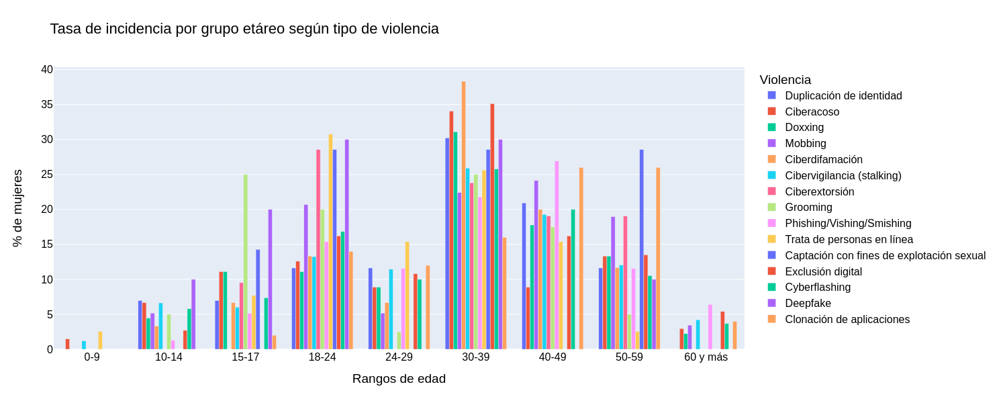

In [200]:
fig = px.bar(
    edades_primera_vez,
    x="Edad",
    y="count",
    color="Violencia",
    title="Tasa de incidencia por grupo etáreo según tipo de violencia",
    barmode="group",
    color_discrete_sequence=px.colors.qualitative.Plotly,
    width=1600,
    height=600,
)
fig.update_layout(
    font=dict(family="Arial", size=16, color="black"),
)
fig.update_yaxes(title="% de mujeres")
fig.update_xaxes(
    title="Rangos de edad",
    labelalias={
        "[0, 10)": "0-9",
        "[10, 15)": "10-14",
        "[15, 18)": "15-17",
        "[18, 25)": "18-24",
        "[25, 30)": "24-29",
        "[30, 40)": "30-39",
        "[40, 50)": "40-49",
        "[50, 60)": "50-59",
        "[60, 75)": "60 y más",
    },
)
fig.show()
fig.write_image("img/violencia_edad2.png")

### Tipo de violencia según el medio por el cual ocurrió

In [201]:
lista_medios = [s for s in list(vars()) if "medios_" in s]
ls_medios = []
for i in [s for s in list(vars()) if "medios_" in s]:
    df = vars()[i]
    ls_medios.append(df)

In [202]:
lista_df_medios = []
for df, i in zip(ls_medios, lista_medios):
    tbl = pd.DataFrame(df)
    if i.split("_")[1] in violencias_nombres.keys():
        l_violencia = [violencias_nombres[i.split("_")[1]]] * len(df)
    else:
        l_violencia = ["Phishing/Vishing/Smishing"] * len(df)
    tbl["violencia"] = l_violencia
    tbl.rename(columns={0: "cantidad"}, inplace=True)
    tbl.reset_index(inplace=True)
    tbl.rename(columns={"index": "Medio"}, inplace=True)
    lista_df_medios.append(tbl)

In [203]:
tbl_violencia_medio = pd.concat(lista_df_medios)

In [204]:
tbl_violencia_medio.reset_index(drop=True, inplace=True)

In [205]:
tbl_violencia_medio = tbl_violencia_medio.astype(
    {"cantidad": "float", "violencia": "str", "Medio": "str"}
)

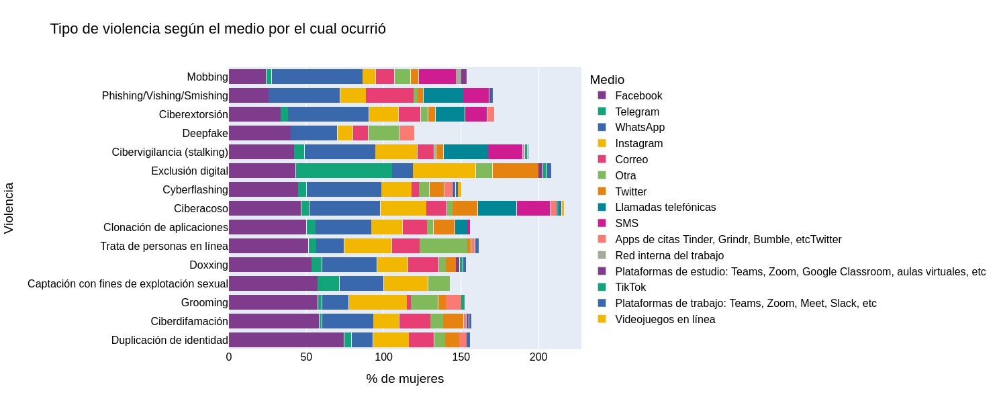

In [206]:
fig = px.bar(
    tbl_violencia_medio.sort_values("cantidad", ascending=False),
    x="cantidad",
    y="violencia",
    color="Medio",
    title="Tipo de violencia según el medio por el cual ocurrió",
    barmode="stack",
    orientation="h",
    color_discrete_sequence=px.colors.qualitative.Bold,
    width=1600,
    height=600,
)
fig.update_layout(
    font=dict(family="Arial", size=16, color="black"),
)
fig.update_yaxes(title="Violencia")
fig.update_xaxes(title="% de mujeres")
fig.show()
fig.write_image("img/violencia_medio1.png")

### Parentesco de la persona agresora con las mujeres que han sufrido violencias

In [207]:
lista_df_parentescos = [
    parentesco_identidad[2],
    parentesco_ciberacoso[2],
    parentesco_doxxing[2],
    parentesco_ciberdifamacion[2],
    parentesco_stalking[2],
    parentesco_ciberextorsion[2],
    parentesco_explotacion[2],
    parentesco_cyberflashing[2],
    parentesco_deepfake[2],
    parentesco_clonacion[2],
]

In [208]:
parentescos_ = [
    "identidad",
    "ciberacoso",
    "doxxing",
    "ciberdifamacion",
    "stalking",
    "ciberextorsion",
    "explotacion",
    "cyberflashing",
    "deepfake",
    "clonacion",
]

In [209]:
for i, j in zip(lista_df_parentescos, parentescos_):
    if j in violencias_nombres.keys():
        ls_index = [violencias_nombres[j]] * len(i)
    i["violencia"] = ls_index

In [210]:
tbl_parentesco_ = pd.concat(lista_df_parentescos)

In [211]:
tbl_parentesco_.reset_index(inplace=True)

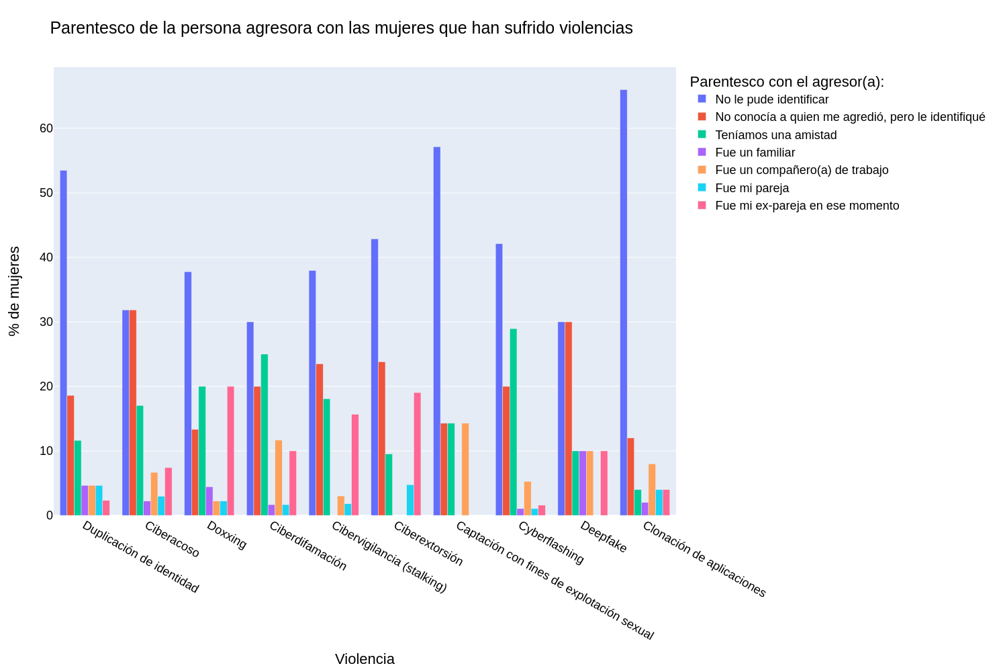

In [212]:
fig = px.bar(
    tbl_parentesco_,
    x="violencia",
    y="count",
    color="parentesco",
    title="Parentesco de la persona agresora con las mujeres que han sufrido violencias",
    barmode="group",
    color_discrete_sequence=px.colors.qualitative.Plotly,
    width=1500,
    height=1000,
)
fig.update_layout(
    legend_title="Parentesco con el agresor(a):",
    font=dict(family="Arial", size=18, color="black"),
)
fig.update_xaxes(title="Violencia")
fig.update_yaxes(title="% de mujeres")
fig.show()
fig.write_image("img/violencia_parentesco1.png")

NOTA: Para las siguientes violencias, la pregunta sobre parentesco se reformuló consultando si se logró o no identificar al agresor(a).

In [213]:
parentesco_violencia = tbl_parentesco_.pivot(
    index="violencia", columns="parentesco", values="count"
).fillna(0)

In [214]:
tbl_grooPt = pd.concat(
    [parentesco_grooming[2], parentesco_phishing_vs[2], parentesco_trata[2]],
    axis=1,
    keys=["Grooming", "Phishing", "Trata"],
).T.reset_index(level=1, drop=True)
tbl_grooPt

,No,Sí
Grooming,26,14
Phishing,66,12
Trata,35,4


NOTA: Para mobbing, por la naturaleza de la agresión, la víctima conoce a su agresor(a).

In [215]:
tbl_parentesco_mobbing = parentesco_mobbing[1]

In [216]:
tbl_parentesco_mobbing.astype({"count": "int"}).rename_axis(
    index={"parentesco_mobbing": "Relación laboral"}
).rename(columns={"count": "N° de mujeres"})

,N° de mujeres
Relación laboral,
Tu compañero(a),31
Un(a) jefe(a),17
Un(a) subalterno(a),10


### Identificación de la persona agresora

In [217]:
tbl_identificacion_si = pd.DataFrame(
    parentesco_violencia[
        [
            "Fue mi ex-pareja en ese momento",
            "Fue mi pareja",
            "Fue un compañero(a) de trabajo",
            "Fue un familiar",
            "No conocía a quien me agredió, pero le identifiqué",
            "Teníamos una amistad",
        ]
    ].sum(1)
).rename(columns={0: "Sí"})

In [218]:
tbl_identificacion_no = pd.DataFrame(
    parentesco_violencia["No le pude identificar"]
).rename(columns={"No le pude identificar": "No"})

In [219]:
tabla_identificacion = pd.concat(
    [tbl_identificacion_si.join(tbl_identificacion_no), tbl_grooPt]
)

In [220]:
porcentaje_identificacion = round(
    (tabla_identificacion.T / tabla_identificacion.sum(1) * 100).T, 2
)

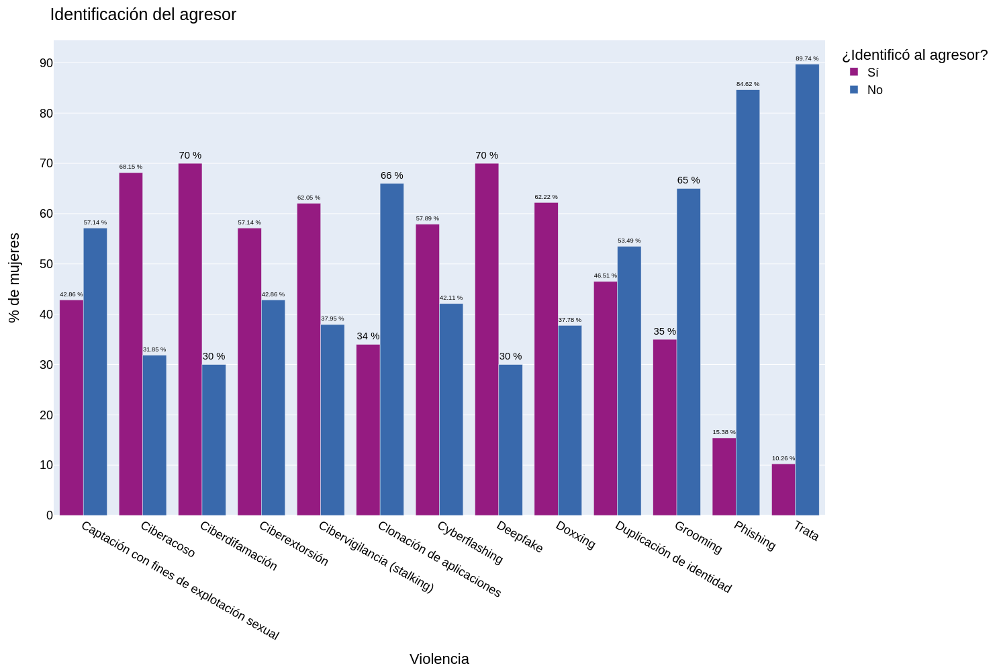

In [221]:
fig = px.bar(
    porcentaje_identificacion,
    barmode="group",
    text_auto="True",
    color_discrete_map={"Sí": "rgb(149, 27, 129)", "No": "rgb(57, 105, 172)"},
    width=1500,
    height=1000,
)
fig.update_layout(
    title="Identificación del agresor",
    xaxis_title="Violencia",
    yaxis_title="% de mujeres",
    legend_title="¿Identificó al agresor?",
    font=dict(
        family="Arial",
        size=18,
        color="black",
    ),
)
fig.update_traces(
    textfont_size=18,
    textangle=0,
    textposition="outside",
    cliponaxis=False,
    texttemplate="%{value} %",
)

fig.show()
fig.write_image("img/id_agresor.png")

### Sexo del agresor por tipo de violencia

In [222]:
variables_sexo = [
    "sexo_identidad",
    "sexo_ciberacoso",
    "sexo_doxxing",
    "sexo_mobbing",
    "sexo_ciberdifamacion",
    "sexo_stalking",
    "sexo_ciberextorsion",
    "sexo_grooming",
    "sexo_phishing_vs",
    "sexo_trata",
    "sexo_explotacion",
    "sexo_cyberflashing",
    "sexo_deepfake",
    "sexo_clonacion",
    "sexo_violencias",
]

In [223]:
sexo_violencias = []
names_ = []
for i in variables_sexo:
    df = vars()[i]
    names_.append(df[1].index.name.split)
    sexo_violencias.append(df[1])

In [224]:
tbl_sexo_violencias = (
    pd.concat(
        sexo_violencias,
        join="outer",
        axis=1,
        keys=[
            "Duplicación de identidad",
            "Ciberacoso",
            "Doxxing",
            "Mobbing",
            "Ciberdifamación",
            "Cibervigilancia (stalking)",
            "Ciberextorsión",
            "Grooming",
            "Phishing/Vishing/Smishing",
            "Trata de personas en línea",
            "Captación con fines de explotación sexual",
            "Cyberflashing",
            "Deepfake",
            "Clonación",
        ],
    )
    .T.reset_index(1, drop=True)
    .fillna(0)
)

In [225]:
sexo_porcentaje = round((tbl_sexo_violencias.T / tbl_sexo_violencias.sum(1) * 100).T, 2)

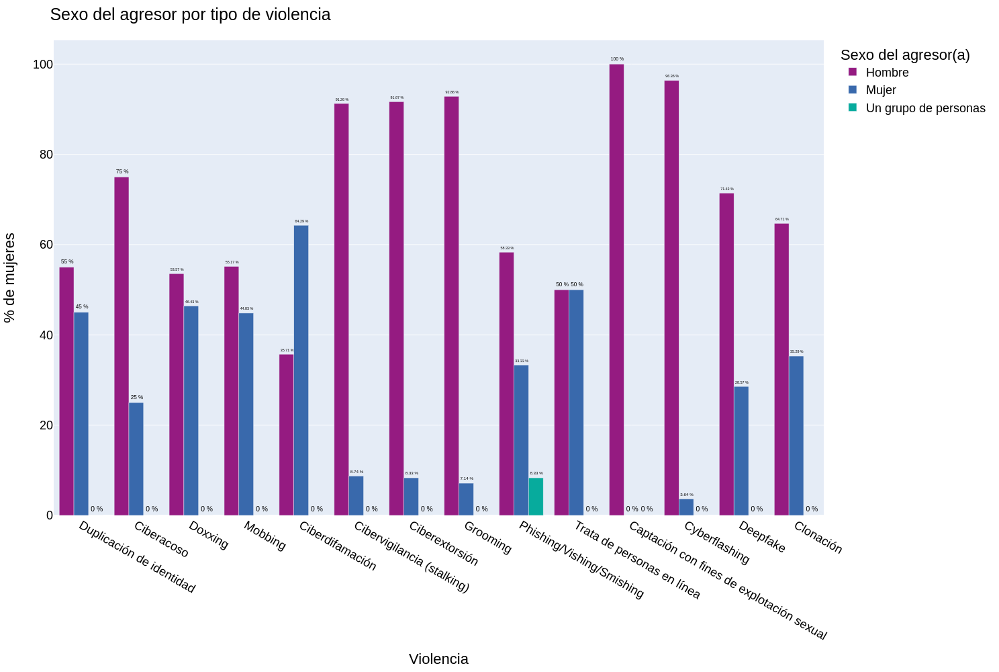

In [226]:
fig = px.bar(
    sexo_porcentaje,
    barmode="group",
    color_discrete_sequence=[
        "rgb(149, 27, 129)",
        "rgb(57, 105, 172)",
        "rgb(7, 171, 157)",
    ],
    width=1500,
    height=1000,
    text_auto=True,
)
fig.update_layout(
    title="Sexo del agresor por tipo de violencia",
    xaxis_title="Violencia",
    yaxis_title="% de mujeres",
    legend_title="Sexo del agresor(a)",
    font=dict(
        family="Arial",
        size=18,
        color="black",
    ),
)
fig.update_traces(
    textfont_size=18,
    textangle=0,
    textposition="outside",
    cliponaxis=False,
    texttemplate="%{value: } %",
)

fig.show()
fig.write_image("img/sexo_agresor_violencia.png")

In [227]:
cruce = porcentaje_identificacion.join(sexo_porcentaje)

In [228]:
cruce.columns = pd.MultiIndex.from_tuples(
    [
        ("Sí", "%"),
        ("No", "%"),
        ("Sí", "Mujer"),
        ("Sí", "Hombre"),
        ("Sí", "Un grupo de personas"),
    ]
)

In [229]:
variables = [
    s
    for s in tbl_identidad.columns
    if s.startswith("sexo_") or s.startswith("parentesco_")
]

In [230]:
lista = []
for j, k in zip(tbl_identidad[variables[0]], tbl_identidad[variables[1]]):
    if j != "No le pude identificar" and j != "No":
        lista.append((j, k))
df = pd.DataFrame(lista, columns=["Parentesco", "Sexo"]).value_counts()

In [231]:
dic_sexo = {}
for i in [s for s in violencias if s != "exclusion"]:
    lista = []
    g = datos.query(f"{i} == 1")
    for j, k in zip(g[dic_violencias[i][4]], g[dic_violencias[i][5]]):
        if j != "No le pude identificar" and j != "No":
            lista.append((j, k))
    dic_sexo[i] = pd.DataFrame(lista, columns=["Parentesco", "Sexo"]).value_counts()

In [232]:
for i in [s for s in violencias if s != "exclusion"]:
    lista = []
    g = datos.query(f"{i} == 1")
    for j, k in zip(g[dic_violencias[i][4]], g[dic_violencias[i][5]]):
        if j != "No le pude identificar" and j != "No":
            lista.append((j, k))
    dic_sexo[i] = pd.DataFrame(lista, columns=["Parentesco", "Sexo"]).value_counts()

### Sexo del agresor(a) y parentesco con la víctima por tipo de violencia

In [233]:
dic_sexo = {}
for i in [s for s in violencias if s != "exclusion"]:
    lista = []
    g = datos.query(f"{i} == 1")
    for j, k in zip(g[dic_violencias[i][4]], g[dic_violencias[i][5]]):
        if j != "No le pude identificar" and j != "No":
            lista.append((i, j, k))
    dic_sexo[i] = pd.DataFrame(
        lista, columns=["Violencia", "Parentesco", "Sexo"]
    ).value_counts()

In [234]:
lista_sexo = [
    dic_sexo[i].reset_index(level=0, drop=True)
    for i in dic_sexo
    if i
    in [
        "identidad",
        "ciberacoso",
        "doxxing",
        "ciberdifamacion",
        "stalking",
        "ciberextorsion",
        "explotacion",
        "cyberflashing",
        "deepfake",
        "clonacion",
    ]
]

In [235]:
lista_parentesco_sexo = [
    round(dic_sexo[i] / dic_sexo[i].sum() * 100, 2).reset_index()
    for i in dic_sexo
    if i
    in [
        "identidad",
        "ciberacoso",
        "doxxing",
        "ciberdifamacion",
        "stalking",
        "ciberextorsion",
        "explotacion",
        "cyberflashing",
        "deepfake",
        "clonacion",
    ]
]

In [236]:
porcentaje_parentesco_sexo = pd.concat(lista_parentesco_sexo)

In [237]:
porcentaje_parentesco_sexo.Violencia.replace(violencias_nombres, inplace=True)

In [238]:
porcentaje_parentesco_sexo.reset_index(drop=True, inplace=True)

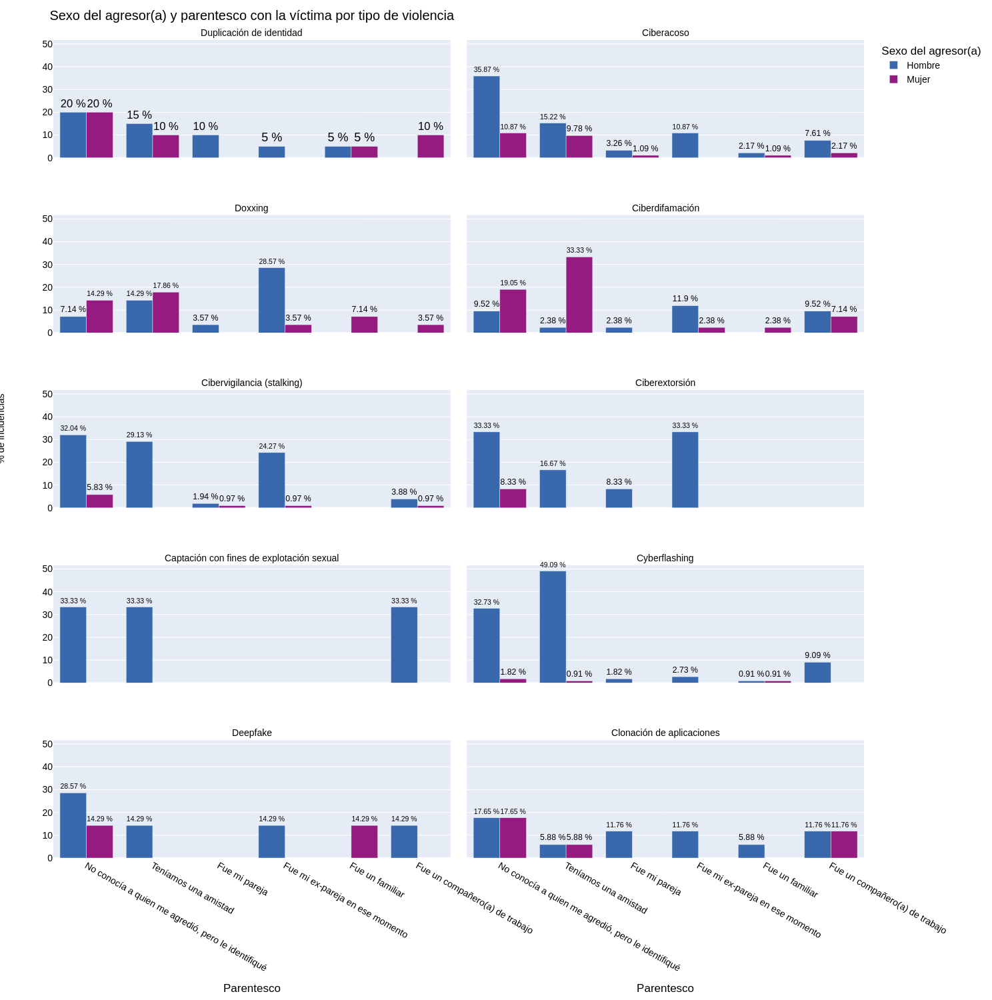

In [239]:
fig = px.bar(
    porcentaje_parentesco_sexo,
    x="Parentesco",
    y="count",
    color="Sexo",
    barmode="group",
    facet_col="Violencia",
    facet_col_wrap=2,
    color_discrete_map={"Mujer": "rgb(149, 27, 129)", "Hombre": "rgb(57, 105, 172)"},
    width=1000,
    height=1500,
    text_auto=True,
)
fig.update_layout(
    title="Sexo del agresor(a) y parentesco con la víctima por tipo de violencia",
    legend_title="Sexo del agresor(a)",
    font=dict(
        family="Arial",
        size=14,
        color="black",
    ),
)
fig.update_traces(
    textfont_size=18,
    textangle=0,
    textposition="outside",
    cliponaxis=False,
    texttemplate="%{value} %",
)
fig.for_each_annotation(lambda a: a.update(text=a.text.split("=")[-1]))
fig.for_each_yaxis(lambda y: y.update(title=""))
fig.add_annotation(
    x=-0.07,
    y=0.5,
    text="% de incidencias",
    textangle=-90,
    xref="paper",
    yref="paper",
)
fig.show()
fig.write_image("img/violencia_parentesco_sexo.png")

In [240]:
tbl_parentesco_sexo = (
    pd.concat(
        lista_sexo,
        join="outer",
        keys=[
            "identidad",
            "ciberacoso",
            "doxxing",
            "ciberdifamacion",
            "stalking",
            "ciberextorsion",
            "explotacion",
            "cyberflashing",
            "deepfake",
            "clonacion",
        ],
        axis=1,
    )
    .fillna(0)
    .sort_index(level=0)
    .T
)

##### Sexo parentesco individual

In [241]:
sp_df = []
for i in lista_parentesco_sexo:
    df = i.pivot(index="Parentesco", columns="Sexo", values="count").fillna(0)
    df.Hombre = df.Hombre * -1
    sp_df.append(df)

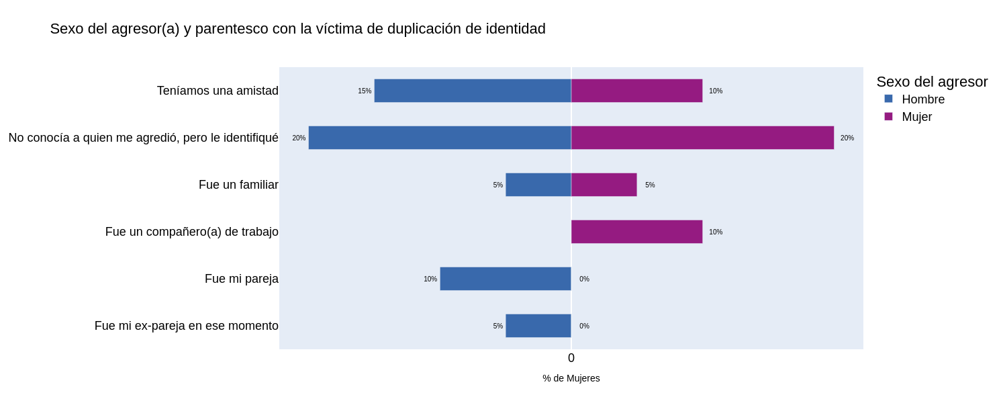

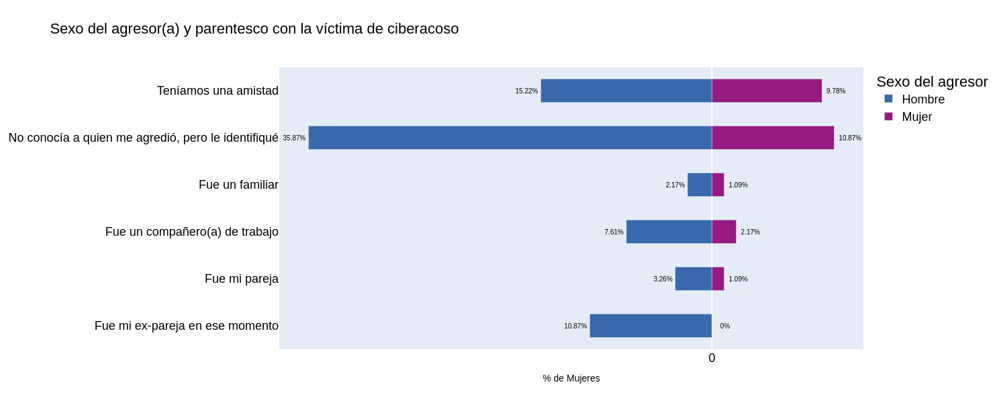

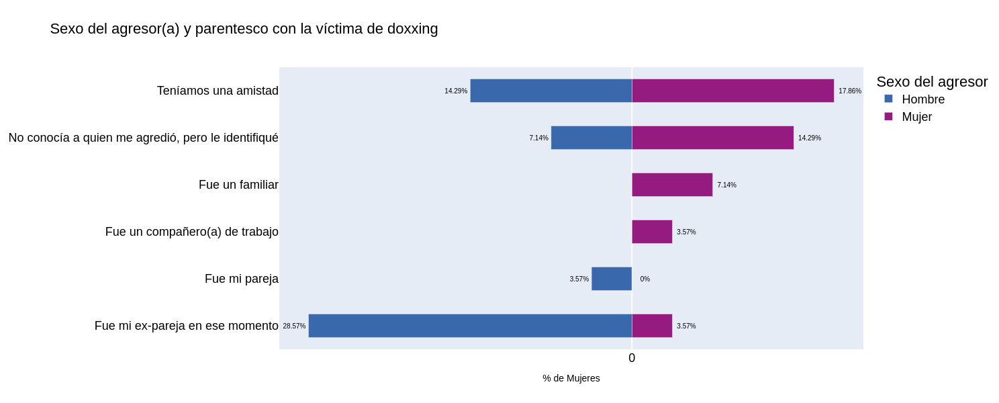

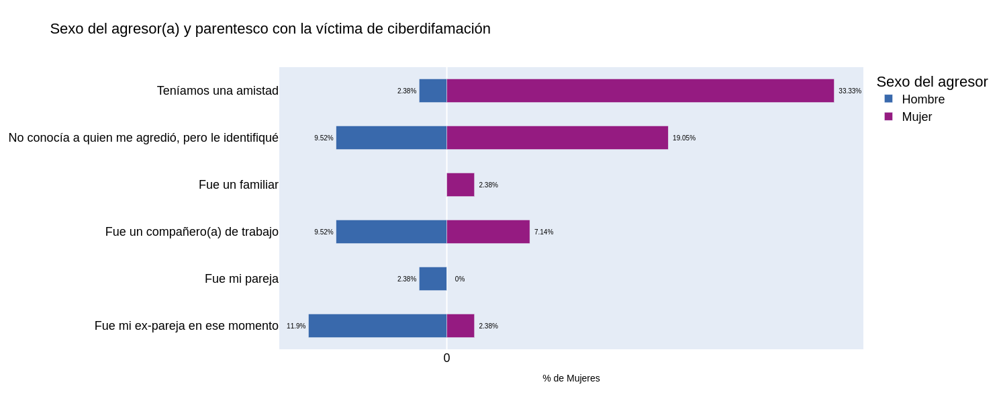

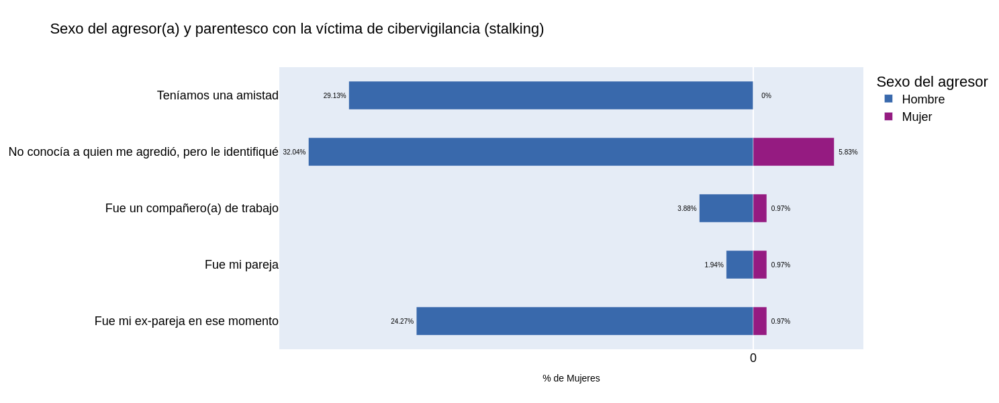

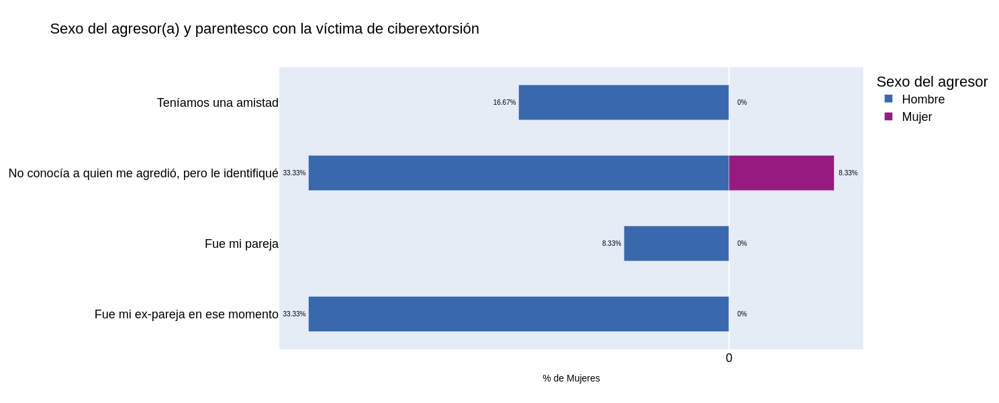

explotacion Son solo hombres


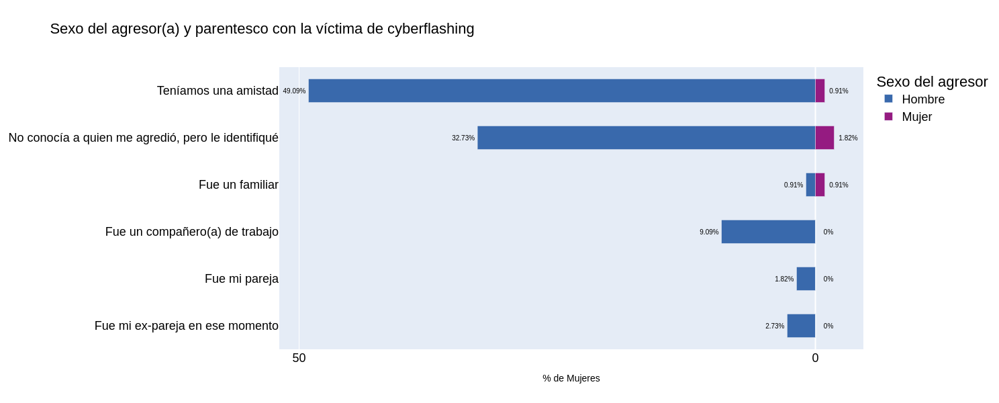

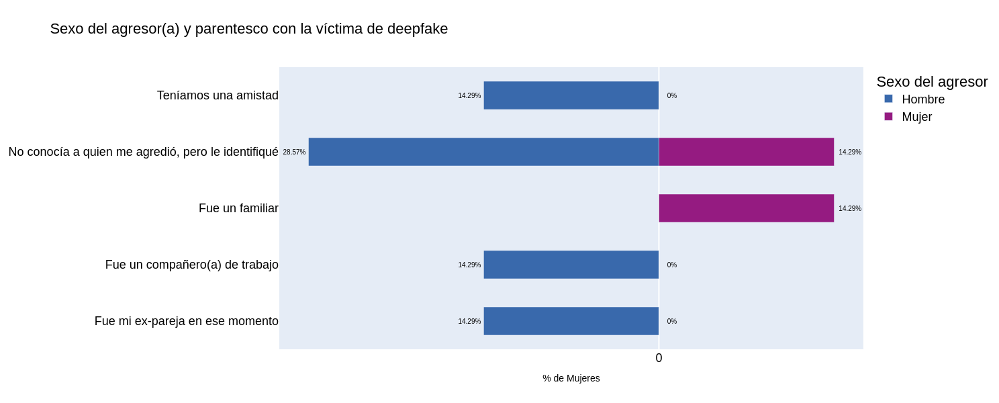

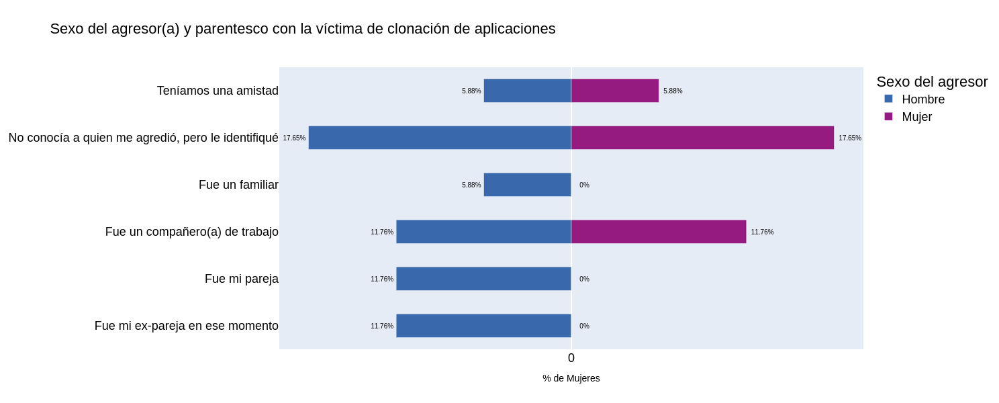

In [242]:
for i, j in zip(sp_df, lista_parentesco_sexo):
    v = j.Violencia[1]
    if len(i.columns) < 2:
        print(v, "Son solo hombres")
    else:
        if v in violencias_nombres.keys():
            # Creating instance of the figure
            fig = go.Figure()

            # Adding Male data to the figure
            fig.add_trace(
                go.Bar(
                    y=i.index,
                    x=i.Hombre,
                    name="Hombre",
                    orientation="h",
                    text=-1 * i.Hombre.values.astype("float"),
                    marker_color="rgb(57, 105, 172)",
                )
            )

            # Adding Female data to the figure
            fig.add_trace(
                go.Bar(
                    y=i.index,
                    x=i.Mujer,
                    name="Mujer",
                    orientation="h",
                    text=i.Mujer,
                    marker_color="rgb(149, 27, 129)",
                )
            )

            # Updating the layout for our graph
            fig.update_layout(
                title=" ".join(
                    [
                        "Sexo del agresor(a) y parentesco con la víctima de",
                        violencias_nombres[v].casefold(),
                    ]
                ),
                legend_title="Sexo del agresor",
                title_font_size=22,
                barmode="relative",
                bargap=0.0,
                bargroupgap=0.5,
                xaxis=dict(
                    title="% de Mujeres",
                    title_font_size=14,
                    tickvals=[-100, -50, 0, 0, 50, 100],
                    ticktext=["100", "50", "0", "0", "50", "100"],
                ),
                width=1500,
                height=600,
                margin=dict(l=30),
                font=dict(
                    family="Arial",
                    size=18,
                    color="black",
                ),
            )
            fig.update_traces(
                textfont_size=10,
                textangle=0,
                textposition="outside",
                cliponaxis=False,
                texttemplate="%{text: 4}%",
            )
            fig.show()
            fig.write_image("".join(["img/piramide_", v, ".png"]))

In [243]:
veces_violencias = [s for s in list(datos.columns) if "veces_" in s]

In [244]:
violencias_6 = [s for s in list(datos.columns) if "6_" in s]

In [245]:
r_inf = []
r_sup = []
for i in datos["edad"]:
    if i == "Más de 60":
        r_inf.append(60)
        r_sup.append(100)
    else:
        r_inf.append(int(i.split("-")[0]))
        r_sup.append(int(i.split("-")[1]))

### Violencias por ocupación

In [246]:
dict_violencias_ocupaciones = {}
for i in violencias:
    df = datos.query(f"{i} == 1 and ocupacion != 'Otra'")["ocupacion"].value_counts()
    df = round(df[:10] / df.sum() * 100, 2)
    dict_violencias_ocupaciones[violencias_nombres[i]] = df

In [247]:
tbl_vo = pd.DataFrame.from_dict(dict_violencias_ocupaciones, orient="index").fillna(0)

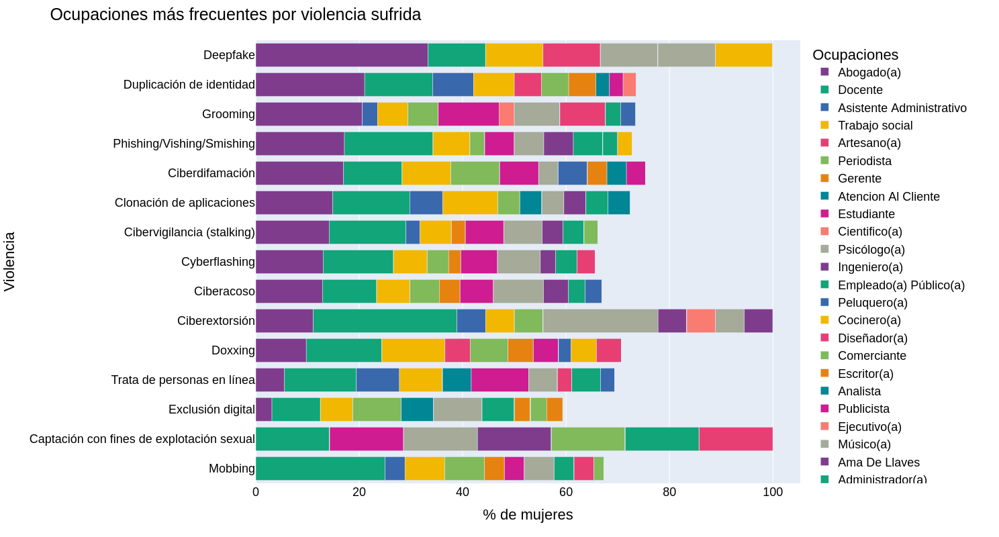

In [248]:
fig = px.bar(
    tbl_vo.sort_values("Abogado(a)"),
    orientation="h",
    color_discrete_sequence=px.colors.qualitative.Bold,
    width=1500,
    height=800,
)
fig.update_layout(
    title="Ocupaciones más frecuentes por violencia sufrida",
    xaxis_title="% de mujeres",
    yaxis_title="Violencia",
    legend_title="Ocupaciones",
    font=dict(
        family="Arial",
        size=18,
        color="black",
    ),
)

fig.show()
fig.write_image("img/violencia_ocupacion.png")

### Violencias por estados

In [249]:
for i in violencias:
    df_ = datos.query(f"{i} == 1")["estado"].value_counts()
    df = df_ / df_.sum() * 100

    lista_valores = []
    for j in df_mapa.ESTADO:
        if j in df.index:
            lista_valores.append(df.loc[j])
        else:
            lista_valores.append(0)
    df_mapa[violencias_nombres[i]] = lista_valores

In [250]:
tbl_violencia_estado = df_mapa.drop(columns="Mujeres")

tbl_violencia_estado.plot(
    "ciberdifamacion",
    cmap="RdPu",
    edgecolor="black",
    legend=True,
);

In [251]:
tbl_ve = (
    pd.melt(
        tbl_violencia_estado,
        id_vars=["ESTADO"],
        value_vars=[violencias_nombres[s] for s in violencias_nombres.keys()],
        var_name="violencia",
        value_name="porcentaje",
    )
    .pivot(index="violencia", columns="ESTADO", values="porcentaje")
    .sort_index(axis=0)
)

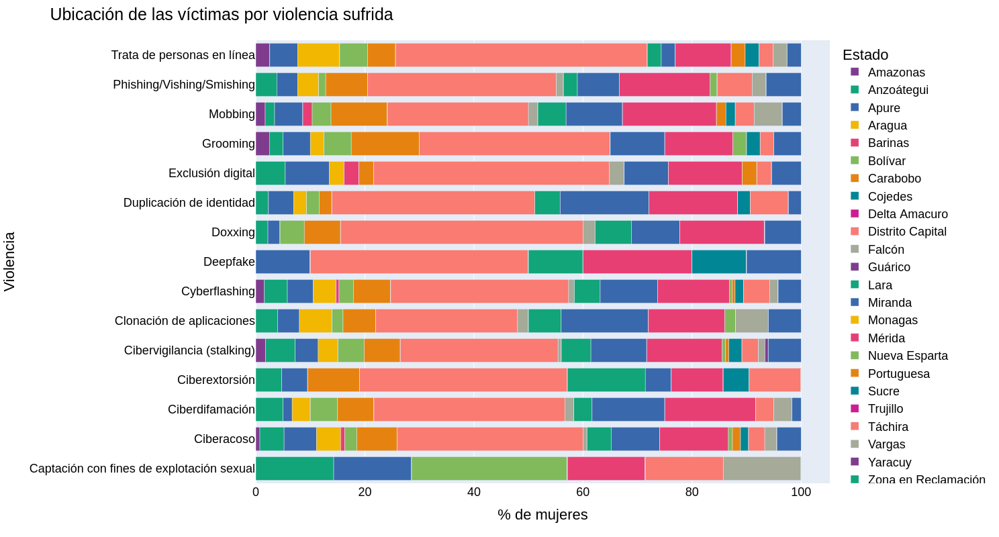

In [252]:
fig = px.bar(
    tbl_ve.sort_index(axis=1),
    orientation="h",
    color_discrete_sequence=px.colors.qualitative.Bold,
    width=1500,
    height=800,
)
fig.update_layout(
    title="Ubicación de las víctimas por violencia sufrida",
    xaxis_title="% de mujeres",
    yaxis_title="Violencia",
    legend_title="Estado",
    font=dict(
        family="Arial",
        size=18,
        color="black",
    ),
)

fig.show()
fig.write_image("img/violencia_estado.png")

### Promedio de incidencias

In [253]:
round(
    (tbl_numero_violencia.index * tbl_numero_violencia["count"]).sum()
    / tbl_numero_violencia.sum().iloc[0],
    3,
)

2.697

En promedio una mujer es víctima de 3 violencias.

### Cantidad de veces en que la víctima reporta haber sufrido la violencia

In [254]:
repeticiones = []
for j in [i for i in list(vars().keys()) if "frecuencia_" in i]:
    df = vars()[j][2].rename(columns={"count": fg.violencias_names[j.split("_")[1]]})
    df.rename(index={"Sólo una vez": "Solo una vez"}, inplace=True)
    repeticiones.append(df)

In [255]:
tbl_repeticiones = pd.concat(repeticiones, axis=1).fillna(0).T

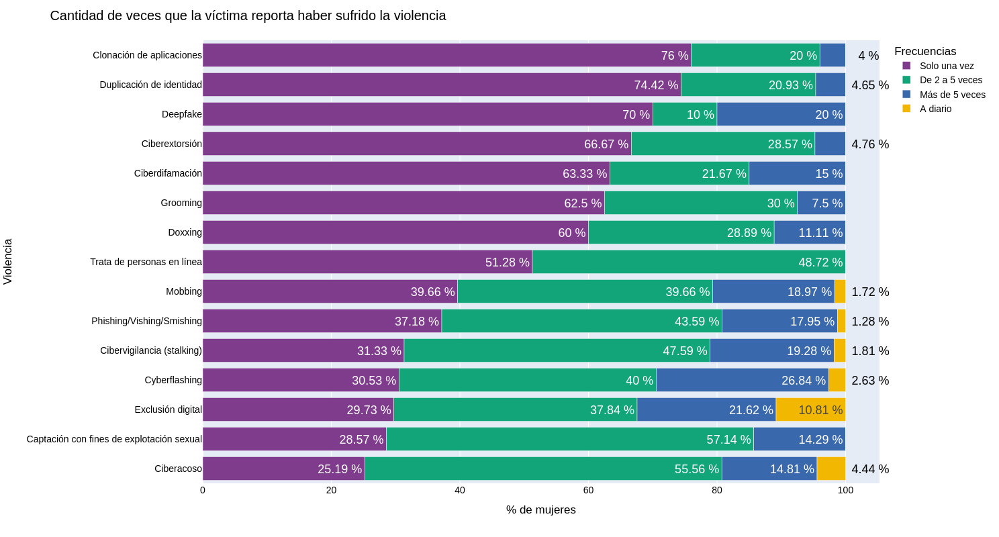

In [256]:
fig = px.bar(
    tbl_repeticiones.sort_values("Solo una vez"),
    orientation="h",
    color_discrete_sequence=px.colors.qualitative.Bold,
    width=1500,
    height=800,
)
fig.update_layout(
    title="Cantidad de veces que la víctima reporta haber sufrido la violencia",
    xaxis_title="% de mujeres",
    yaxis_title="Violencia",
    legend_title="Frecuencias",
    font=dict(
        family="Arial",
        size=14,
        color="black",
    ),
)
fig.update_traces(
    textfont_size=18,
    textangle=0,
    cliponaxis=False,
    marker_line_color="white",
    texttemplate="%{value: 4} %",
)
fig.show()
fig.write_image("img/repeticiones_violencia.png")

### Patrón de uso de aplicaciones por tipo de violencias y según medio más frecuente por el que ocurrió

In [257]:
dict_medios_medios = {}
medio_frecuente = []
for i in violencias:
    df = datos.query(f"{i} == 1")
    variable = [s for s in df.columns if "".join(["medio_", i]) in s]
    start_cols = list(range(23, 40))
    var_idx = df.columns.get_loc(variable[0])
    end_col = df.columns.get_loc("".join(["otraR_", i]))

    # concatenar rangos de columnas con np.r_[]
    col_range = np.r_[start_cols, var_idx + 1 : end_col]

    # seleccionar las columnas del DataFrame
    info = df.iloc[:, col_range]

    # Cálculo del valor máximo en el medio de la violencia
    medio_mas_freq = info.loc[:, "".join(["twitter_", i]) :].sum().astype(int).idxmax()
    medio_frecuente.append(medio_mas_freq.split("_")[0])

    df_medios = info.query(f"{medio_mas_freq} == 1")[redes]

    dicts = {}
    for red_app in redes:
        dicts[red_app.capitalize()] = (
            df_medios[[red_app]]
            .value_counts()
            .reset_index()
            .set_index(red_app)["count"]
        )

    aplicaciones = pd.DataFrame.from_dict(dicts, orient="index").fillna(0)[
        [
            "Menos de 2 horas",
            "2-4 horas",
            "5-7 horas",
            "Más de 7 horas",
            "No la utilizo",
        ]
    ]

    dict_medios_medios[violencias_nombres[i]] = round(aplicaciones / len(df) * 100, 2)

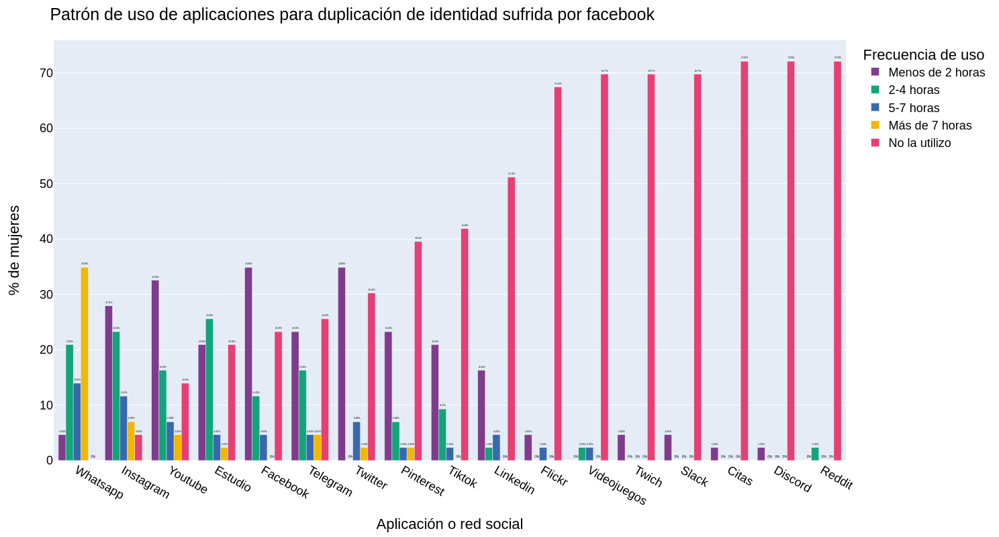

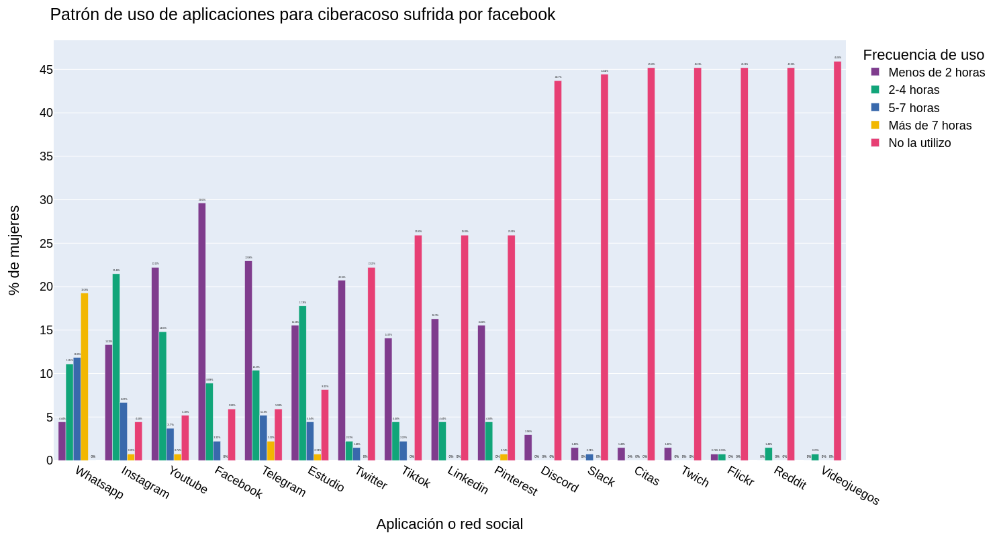

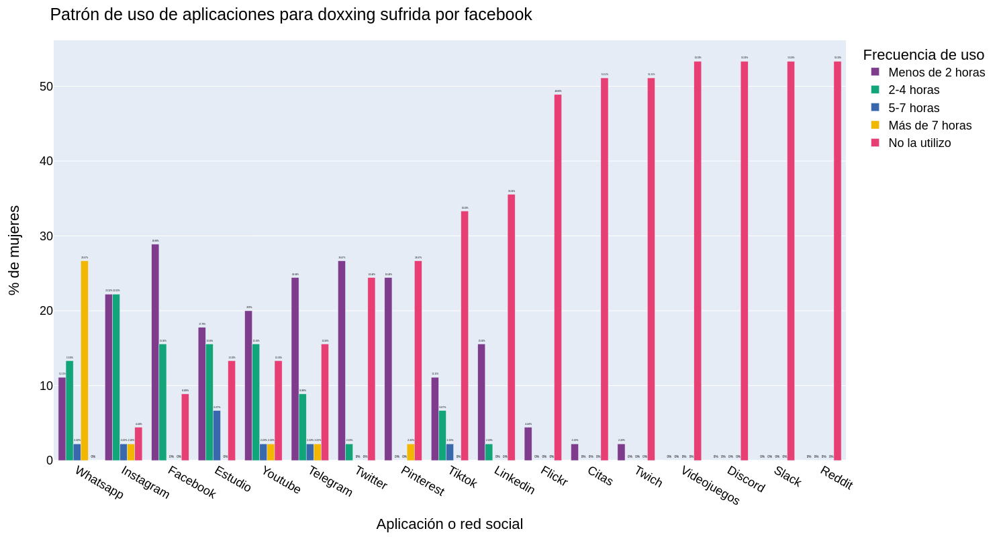

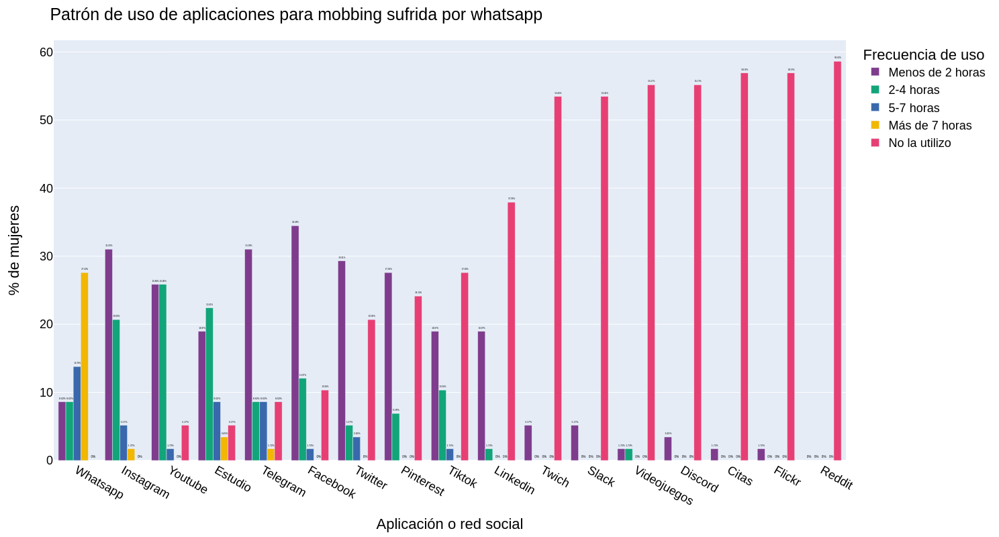

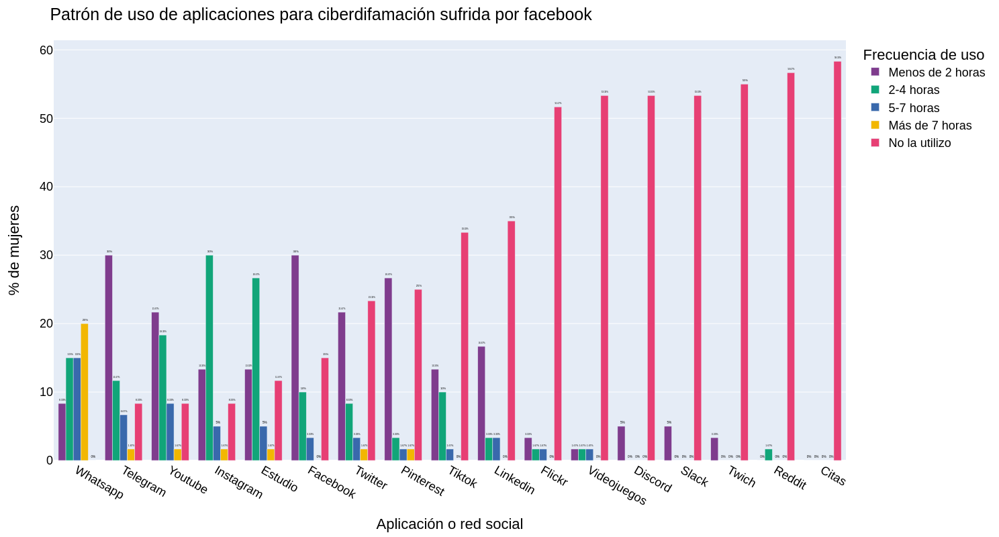

...

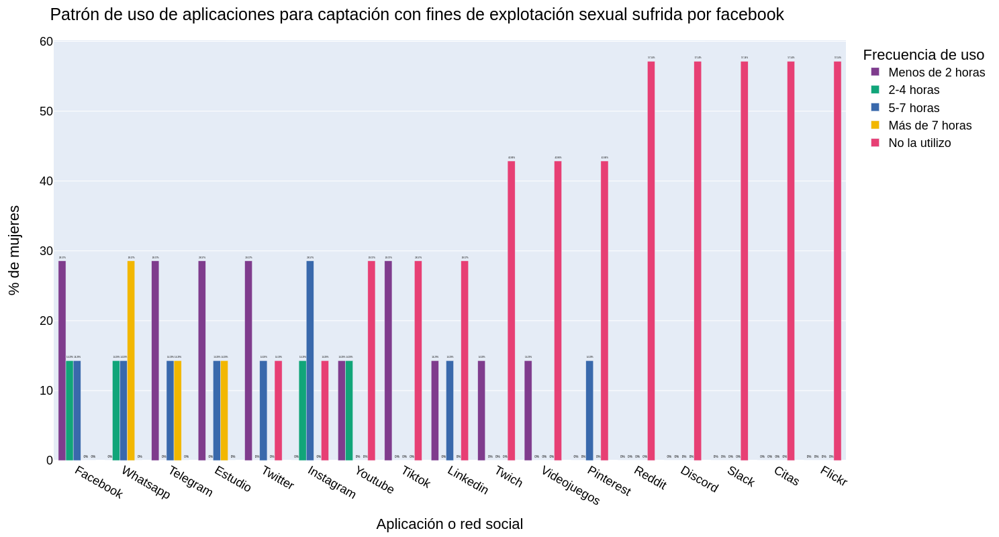

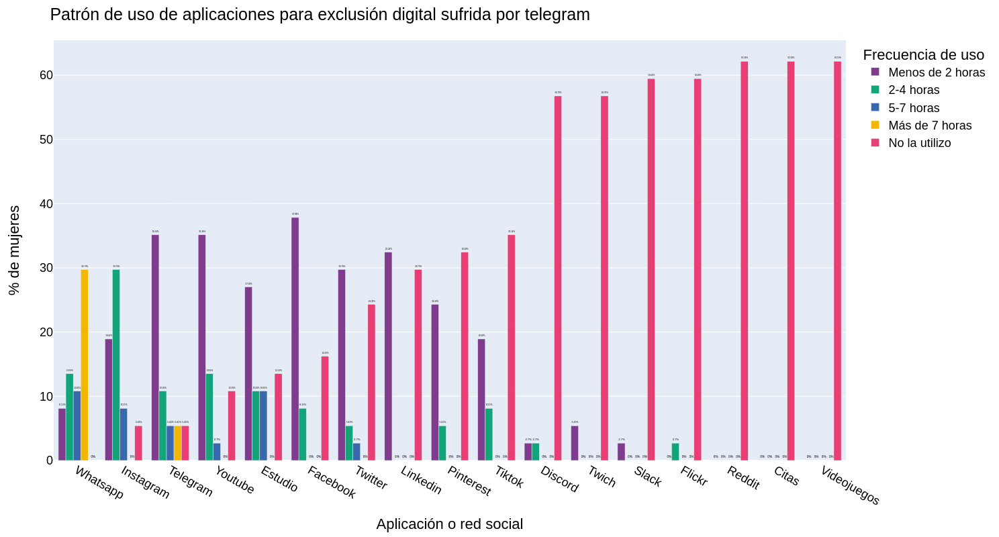

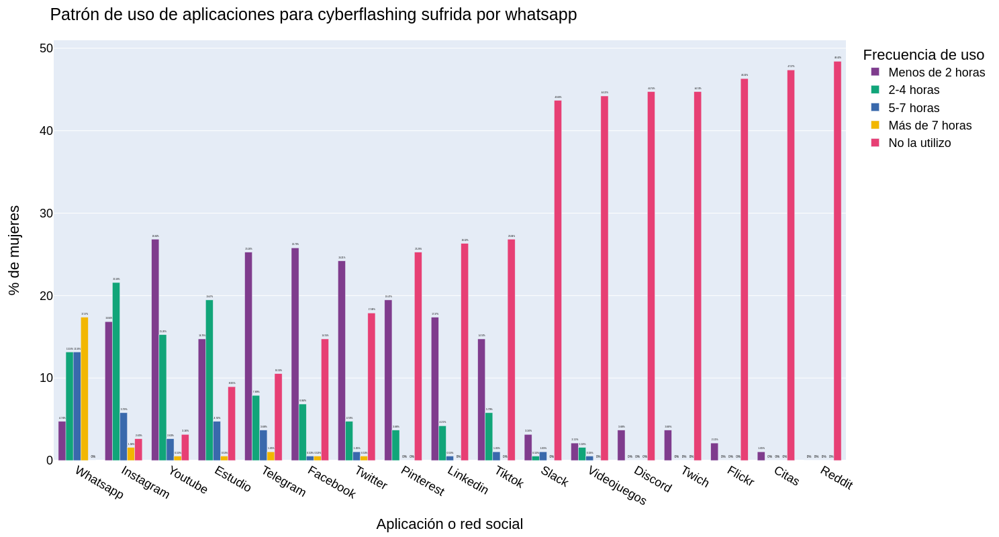

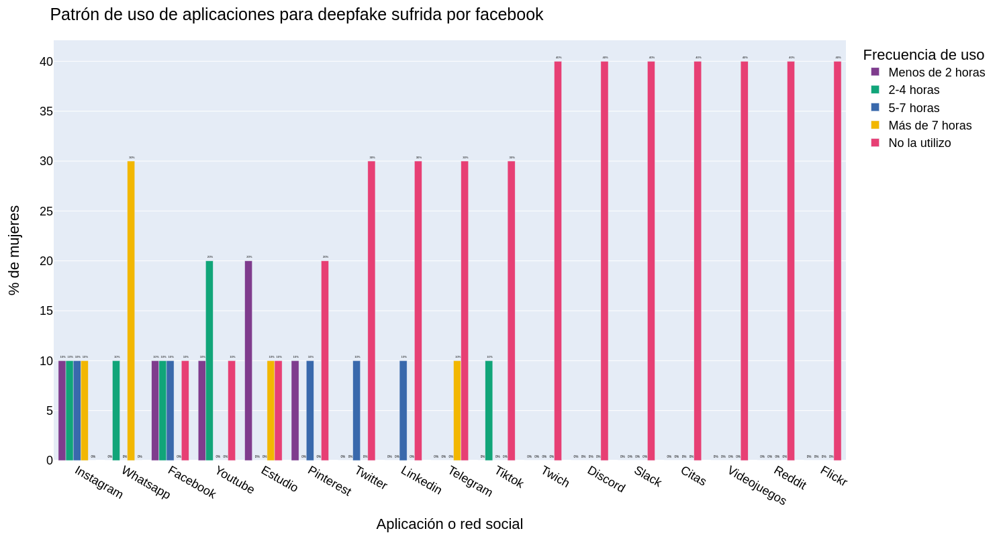

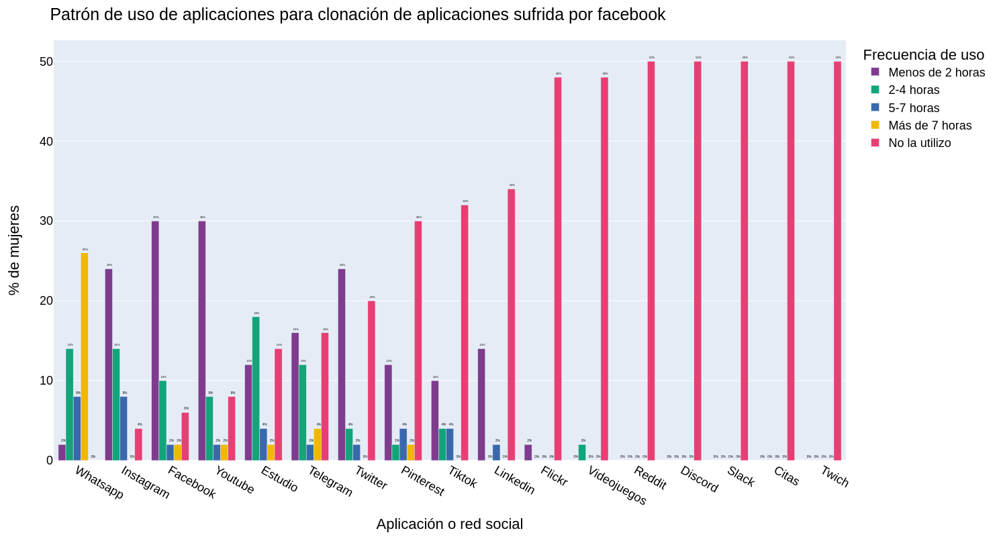

In [258]:
for i, j in zip(dict_medios_medios.keys(), medio_frecuente):
    fig = px.bar(
        dict_medios_medios[i].sort_values("No la utilizo"),
        orientation="v",
        barmode="group",
        color_discrete_sequence=px.colors.qualitative.Bold,
        width=1500,
        height=800,
    )
    fig.update_layout(
        title=f"Patrón de uso de aplicaciones para {i.casefold()} sufrida por {j} ",
        yaxis_title="% de mujeres",
        xaxis_title="Aplicación o red social",
        legend_title="Frecuencia de uso",
        font=dict(
            family="Arial",
            size=18,
            color="black",
        ),
    )
    fig.update_traces(
        textfont_size=18,
        textangle=0,
        textposition="outside",
        cliponaxis=False,
        texttemplate="%{value: 4}%",
    )
    fig.show()
    fig.write_image(f"img/apps{i[:8]}.png")

### Víctimas y conocimiento del nombre de la violencia que sufrieron

In [259]:
dict_conocimiento_frecuencia = {}
for i in violencias:
    df = datos.query(f"{i} == 1")["vdbg"].value_counts()
    dict_conocimiento_frecuencia[violencias_nombres[i]] = round(df / df.sum() * 100, 2)

In [260]:
df_victima_conocimiento = pd.DataFrame.from_dict(
    dict_conocimiento_frecuencia, orient="index"
).fillna(0)

df_victima_conocimiento.columns.name = "Conocimiento del nombre de la violencia"

df_victima_conocimiento

Conocimiento del nombre de la violencia,Sí,No
Duplicación de identidad,79.07,20.93
Ciberacoso,76.30,23.70
Doxxing,68.89,31.11
Mobbing,75.86,24.14
Ciberdifamación,76.67,23.33
Cibervigilancia (stalking),75.30,24.70
Ciberextorsión,76.19,23.81
Grooming,75.00,25.00
Phishing/Vishing/Smishing,79.49,20.51
Trata de personas en línea,69.23,30.77


Esta tabla contiene la información de las mujeres que sufrieron las violencias y se compara con la respuesta de si conoce o no el nombre.